In [ ]:
import os
import pandas as pd
import numpy as np

datasets_path = './dataset'

In [ ]:
forecast_file = f'gdrive/MyDrive/reforecast/result_of_paper/dataset/forecast_only_results.csv'

reforecast_file = 'gdrive/MyDrive/reforecast/result_of_paper/dataset/reforecast_after_feature_selection_forcly_add_pred_data .csv'

forecast_df = pd.read_csv(forecast_file)
reforecast_df = pd.read_csv(reforecast_file)

df_list = [forecast_df, reforecast_df]

site 1 best model combination : SVR_SVR_MAE
site 2 best model combination : LGB_SVR_MAE
site 4 best model combination : MLR_SVR_MAE
site 5 best model combination : MLR_SVR_MAE
site 6 best model combination : MLR_SVR_MAE
site 7 best model combination : MLR_SVR_MAE
site 8 best model combination : LGB_SVR_MAE


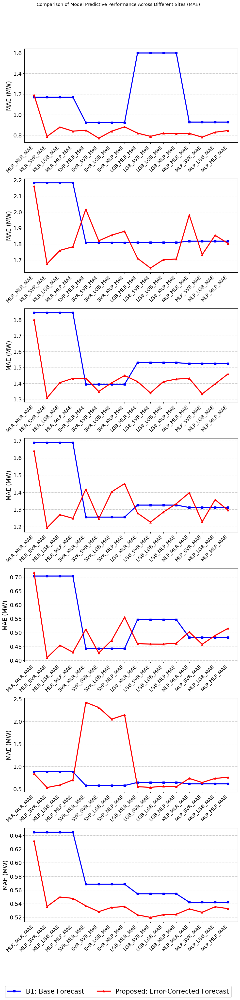

site 1 best model combination : MLP_MLR_MSE
site 2 best model combination : MLR_MLP_MSE
site 4 best model combination : MLP_SVR_MSE
site 5 best model combination : MLR_MLP_MSE
site 6 best model combination : MLR_SVR_MSE
site 7 best model combination : LGB_MLP_MSE
site 8 best model combination : LGB_MLP_MSE


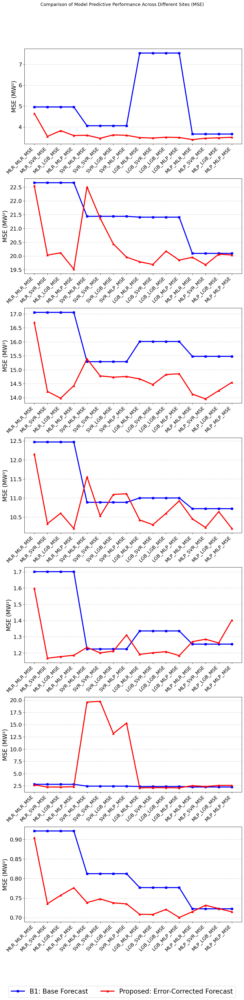

site 1 best model combination : MLP_MLR_RMSE
site 2 best model combination : MLR_MLP_RMSE
site 4 best model combination : MLP_SVR_RMSE
site 5 best model combination : MLR_MLP_RMSE
site 6 best model combination : MLR_SVR_RMSE
site 7 best model combination : LGB_MLP_RMSE
site 8 best model combination : LGB_MLP_RMSE


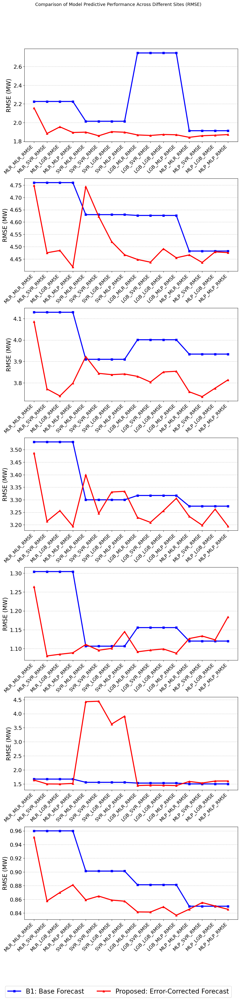

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os

# 데이터 불러오기
df_forecast = df_list[0]
df_reforecast = df_list[1]
# df_forecast['model'] = df_forecast['reforecast_model']

# 설정
sites = [1, 2, 4, 5, 6, 7, 8]
models = ['MLR', 'SVR', 'LGB', 'MLP']
graph_errors = ['MAE','MSE','RMSE']
b0_prev_legend_name = 'BO: Current Observation'
b1_forecast_legend_name = 'B1: Base Forecast'
reforecast_legend_name = 'Proposed: Error-Corrected Forecast'

compare_with_prev_15min_file = [os.path.join(datasets_path, file) for file in os.listdir(datasets_path)
                                if file.endswith('.csv') and 'compare' in file][0]
compare_with_prev_15min_df = pd.read_csv(compare_with_prev_15min_file)

for graph_error in graph_errors:
  unit = 'MW' if graph_error != 'MSE' else 'MW²'

  # A4 크기, 세로 배열
  fig, axes = plt.subplots(7, 1, figsize=(10, 40))  # A4 세로 기준

  for idx, (site_num, site_index) in enumerate(zip(sites, [1, 2, 4, 5, 6, 7, 8])):
      forecast_errors = []
      reforecast_errors = []
      x_labels = []

      value = compare_with_prev_15min_df.loc[
          compare_with_prev_15min_df['Site'] == site_index, graph_error
      ].values[0]
      compare_with_prev_15mins = np.repeat(value, 16)

      for forecast_model in models:
          forecast_error = df_forecast[
              (df_forecast['site'] == site_num) & (df_forecast['forecast_model'] == forecast_model)
          ][graph_error].iloc[0]

          for reforecast_model in models:

              reforecast_error = df_reforecast[
                  (df_reforecast['site'] == site_num) &
                  (df_reforecast['forecast_model'] == forecast_model) &
                  (df_reforecast['reforecast_model'] == reforecast_model)
              ][graph_error].iloc[0]

              x_labels.append(f'{forecast_model}_{reforecast_model}_{graph_error}')
              forecast_errors.append(forecast_error)
              reforecast_errors.append(reforecast_error)

      reforecast_errors = np.array(reforecast_errors)
      forecast_errors = np.array(forecast_errors)
      x_labels = np.array(x_labels)

      sorted_indices = np.argsort(reforecast_errors)
      reforecast_errors_sorted = reforecast_errors[sorted_indices]
      # forecast_errors_sorted = forecast_errors[sorted_indices]
      x_labels_sorted = x_labels[sorted_indices]
      print(f"site {site_num} best model combination : {x_labels_sorted[0]}")
      compare_with_prev_15mins_sorted = compare_with_prev_15mins[sorted_indices]

      x = np.arange(len(x_labels))
      ax = axes[idx]

      # 꺾은선 그래프
      ax.plot(x, forecast_errors, marker='s', label=b1_forecast_legend_name, color = 'blue',linewidth=3)
      ax.plot(x, reforecast_errors, marker='^', label=reforecast_legend_name, color = 'red',linewidth=3)

      # 시각 설정
      ax.set_xticks(x)
      ax.set_xticklabels(x_labels, rotation=45, ha='right', fontsize=17)
      # ax.set_title(f'Site {site_num}', fontsize=11)
      ax.set_ylabel(f'{graph_error} ({unit})', fontsize=17)
      ax.tick_params(axis='y', labelsize=16)
      ax.tick_params(axis='x', labelsize=14)
      ax.grid(axis='y', linestyle='--', alpha=0.7)

  # 공통 legend - 하단 중앙
  fig.legend(
      [b1_forecast_legend_name, reforecast_legend_name],
      loc='lower center', ncol=3, bbox_to_anchor=(0.5, -0.015), fontsize=19
  )

  # 전체 제목
  fig.suptitle(f'Comparison of Model Predictive Performance Across Different Sites ({graph_error})',
              fontsize=13, y=0.995)

  # 여백 조정: caption 공간 포함
  fig.subplots_adjust(hspace=0.6)
  fig.tight_layout(rect=[0, 0.03, 1, 0.96])  # 하단/상단 여백 확보

  plt.show()

Site 1 | Forecast: SVR | Reforecast: SVR | MAE: 0.7717
Site 2 | Forecast: LGB | Reforecast: SVR | MAE: 1.6494
Site 4 | Forecast: MLR | Reforecast: SVR | MAE: 1.3080
Site 5 | Forecast: MLR | Reforecast: SVR | MAE: 1.1937
Site 6 | Forecast: MLR | Reforecast: SVR | MAE: 0.4099
Site 7 | Forecast: MLR | Reforecast: SVR | MAE: 0.5340
Site 8 | Forecast: LGB | Reforecast: SVR | MAE: 0.5199
Site 1 | Forecast: SVR | Reforecast: SVR | MSE: 3.4549
Site 2 | Forecast: LGB | Reforecast: SVR | MSE: 19.6902
Site 4 | Forecast: MLR | Reforecast: SVR | MSE: 14.2212
Site 5 | Forecast: MLR | Reforecast: SVR | MSE: 10.3301
Site 6 | Forecast: MLR | Reforecast: SVR | MSE: 1.1677
Site 7 | Forecast: MLR | Reforecast: SVR | MSE: 2.2506
Site 8 | Forecast: LGB | Reforecast: SVR | MSE: 0.7082
Site 1 | Forecast: SVR | Reforecast: SVR | RMSE: 1.8587
Site 2 | Forecast: LGB | Reforecast: SVR | RMSE: 4.4374
Site 4 | Forecast: MLR | Reforecast: SVR | RMSE: 3.7711
Site 5 | Forecast: MLR | Reforecast: SVR | RMSE: 3.2140
Sit

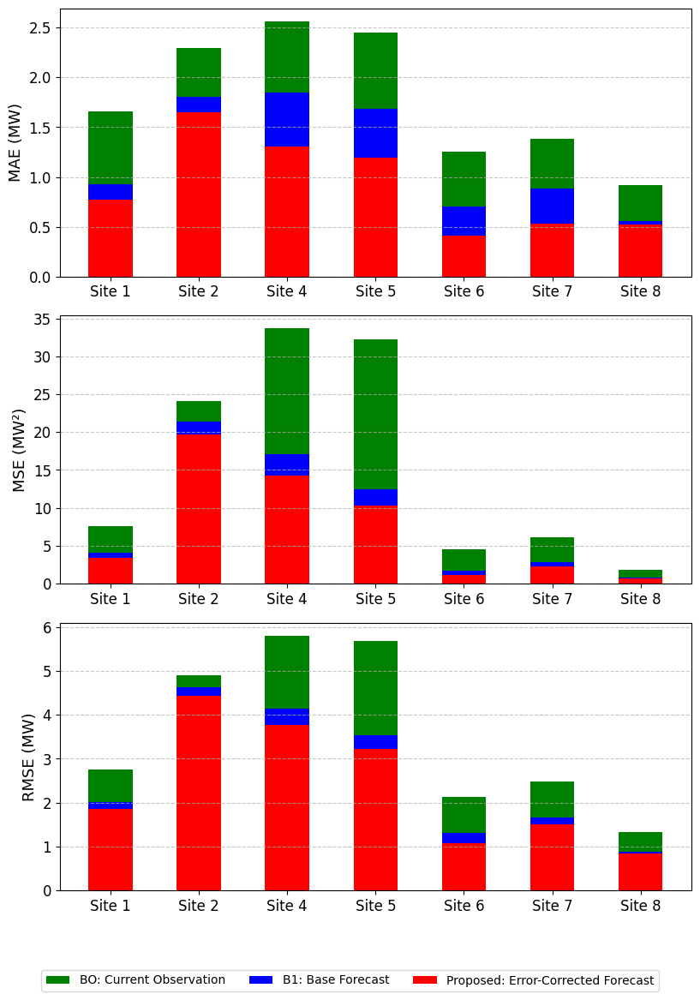

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os

df_forecast = df_list[0]
df_reforecast = df_list[1]

sites = [1, 2, 4, 5, 6, 7, 8]
models = ['MLR', 'SVR', 'LGB', 'MLP']

b0_prev_legend_name = 'BO: Current Observation'
b1_forecast_legend_name = 'B1: Base Forecast'
reforecast_legend_name = 'Proposed: Error-Corrected Forecast'

best_model_combos = [
    ('svr', 'svr'),
    ('lgb', 'svr'),
    ('mlr', 'svr'),
    ('mlr', 'svr'),
    ('mlr', 'svr'),
    ('mlr', 'svr'),
    ('lgb', 'svr')
]

compare_with_prev_15min_file = [os.path.join(datasets_path, file) for file in os.listdir(datasets_path)
                                 if file.endswith('.csv') and 'compare' in file][0]
compare_with_prev_15min_df = pd.read_csv(compare_with_prev_15min_file)

fig, axes = plt.subplots(3, 1, figsize=(8.27, 11.69))
errors = ['MAE', 'MSE', 'RMSE']
units = {'MAE': 'MW', 'MSE': 'MW²', 'RMSE': 'MW'}
colors = {
    b0_prev_legend_name: 'green',
    b1_forecast_legend_name: 'blue',
    reforecast_legend_name: 'red'
}

for idx, graph_error in enumerate(errors):
    site_labels = []
    compare_vals = []
    forecast_vals = []
    reforecast_vals = []

    for site_num, (best_forecast_model, best_reforecast_model) in zip(sites, best_model_combos):
        prev_pv_diff = compare_with_prev_15min_df.loc[
            compare_with_prev_15min_df['Site'] == site_num, graph_error
        ].values[0]

        forecast_error = df_forecast[
            (df_forecast['site'] == site_num) &
            (df_forecast['forecast_model'] == best_forecast_model.upper())
        ][graph_error].iloc[0]

        reforecast_error = df_reforecast[
            (df_reforecast['site'] == site_num) &
            (df_reforecast['forecast_model'] == best_forecast_model.upper()) &
            (df_reforecast['reforecast_model'] == best_reforecast_model.upper())
        ][graph_error].iloc[0]

        # ✅ 성능 출력
        print(f"Site {site_num} | Forecast: {best_forecast_model.upper()} | Reforecast: {best_reforecast_model.upper()} | {graph_error}: {reforecast_error:.4f}")

        site_labels.append(f'Site {site_num}')
        compare_vals.append(prev_pv_diff)
        forecast_vals.append(forecast_error)
        reforecast_vals.append(reforecast_error)

    compare_vals = np.array(compare_vals)
    forecast_vals = np.array(forecast_vals)
    reforecast_vals = np.array(reforecast_vals)
    x = np.arange(len(site_labels))
    bar_width = 0.5

    ax = axes[idx]

    for i in range(len(x)):
        values = {
            b0_prev_legend_name: compare_vals[i],
            b1_forecast_legend_name: forecast_vals[i],
            reforecast_legend_name: reforecast_vals[i]
        }

        sorted_items = sorted(values.items(), key=lambda x: x[1], reverse=True)
        for label, val in sorted_items:
            ax.bar(x[i], val, width=bar_width, color=colors[label], label=label if i == 0 else "")

    ax.set_xticks(x)
    ax.set_xticklabels(site_labels, fontsize=12)
    ax.set_ylabel(f'{graph_error} ({units[graph_error]})', fontsize=13)
    ax.tick_params(axis='y', labelsize=12)
    ax.tick_params(axis='x', labelsize=12)
    ax.grid(axis='y', linestyle='--', alpha=0.7)

fig.legend(
    [b0_prev_legend_name, b1_forecast_legend_name, reforecast_legend_name],
    loc='lower center',
    ncol=3,
    bbox_to_anchor=(0.5, -0.02),
    fontsize=10
)
fig.tight_layout(rect=[0, 0.05, 1, 0.98])
plt.show()


Site 1 | Forecast: SVR | Reforecast: SVR | MAE: 0.7717
Site 2 | Forecast: LGB | Reforecast: SVR | MAE: 1.6494
Site 4 | Forecast: MLR | Reforecast: SVR | MAE: 1.3080
Site 5 | Forecast: MLR | Reforecast: SVR | MAE: 1.1937
Site 6 | Forecast: MLR | Reforecast: SVR | MAE: 0.4099
Site 7 | Forecast: MLR | Reforecast: SVR | MAE: 0.5340
Site 8 | Forecast: LGB | Reforecast: SVR | MAE: 0.5199
Site 1 | Forecast: SVR | Reforecast: SVR | MSE: 3.4549
Site 2 | Forecast: LGB | Reforecast: SVR | MSE: 19.6902
Site 4 | Forecast: MLR | Reforecast: SVR | MSE: 14.2212
Site 5 | Forecast: MLR | Reforecast: SVR | MSE: 10.3301
Site 6 | Forecast: MLR | Reforecast: SVR | MSE: 1.1677
Site 7 | Forecast: MLR | Reforecast: SVR | MSE: 2.2506
Site 8 | Forecast: LGB | Reforecast: SVR | MSE: 0.7082
Site 1 | Forecast: SVR | Reforecast: SVR | RMSE: 1.8587
Site 2 | Forecast: LGB | Reforecast: SVR | RMSE: 4.4374
Site 4 | Forecast: MLR | Reforecast: SVR | RMSE: 3.7711
Site 5 | Forecast: MLR | Reforecast: SVR | RMSE: 3.2140
Sit

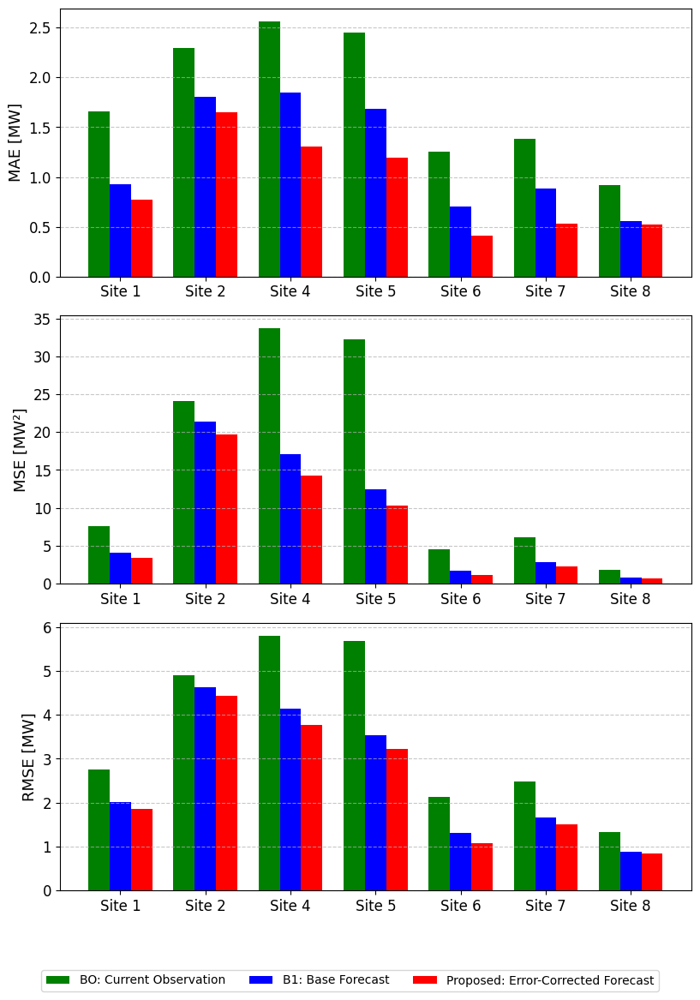

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os

df_forecast = df_list[0]
df_reforecast = df_list[1]

sites = [1, 2, 4, 5, 6, 7, 8]
models = ['MLR', 'SVR', 'LGB', 'MLP']

b0_prev_legend_name = 'BO: Current Observation'
b1_forecast_legend_name = 'B1: Base Forecast'
reforecast_legend_name = 'Proposed: Error-Corrected Forecast'

best_model_combos = [
    ('svr', 'svr'),
    ('lgb', 'svr'),
    ('mlr', 'svr'),
    ('mlr', 'svr'),
    ('mlr', 'svr'),
    ('mlr', 'svr'),
    ('lgb', 'svr')
]

compare_with_prev_15min_file = [os.path.join(datasets_path, file) for file in os.listdir(datasets_path)
                                 if file.endswith('.csv') and 'compare' in file][0]
compare_with_prev_15min_df = pd.read_csv(compare_with_prev_15min_file)

fig, axes = plt.subplots(3, 1, figsize=(8.27, 11.69))  # A4 size
errors = ['MAE', 'MSE', 'RMSE']
units = {'MAE': 'MW', 'MSE': 'MW²', 'RMSE': 'MW'}
colors = {
    b0_prev_legend_name: 'green',
    b1_forecast_legend_name: 'blue',
    reforecast_legend_name: 'red'
}

bar_width = 0.25  # 세 막대가 겹치지 않도록 너비 설정

for idx, graph_error in enumerate(errors):
    site_labels = []
    compare_vals = []
    forecast_vals = []
    reforecast_vals = []

    for site_num, (best_forecast_model, best_reforecast_model) in zip(sites, best_model_combos):
        prev_pv_diff = compare_with_prev_15min_df.loc[
            compare_with_prev_15min_df['Site'] == site_num, graph_error
        ].values[0]

        forecast_error = df_forecast[
            (df_forecast['site'] == site_num) &
            (df_forecast['forecast_model'] == best_forecast_model.upper())
        ][graph_error].iloc[0]

        reforecast_error = df_reforecast[
            (df_reforecast['site'] == site_num) &
            (df_reforecast['forecast_model'] == best_forecast_model.upper()) &
            (df_reforecast['reforecast_model'] == best_reforecast_model.upper())
        ][graph_error].iloc[0]

        print(f"Site {site_num} | Forecast: {best_forecast_model.upper()} | Reforecast: {best_reforecast_model.upper()} | {graph_error}: {reforecast_error:.4f}")

        site_labels.append(f'Site {site_num}')
        compare_vals.append(prev_pv_diff)
        forecast_vals.append(forecast_error)
        reforecast_vals.append(reforecast_error)

    compare_vals = np.array(compare_vals)
    forecast_vals = np.array(forecast_vals)
    reforecast_vals = np.array(reforecast_vals)
    x = np.arange(len(site_labels))
    ax = axes[idx]

    for i in range(len(x)):
        ax.bar(x[i] - bar_width, compare_vals[i], width=bar_width, color=colors[b0_prev_legend_name], label=b0_prev_legend_name if i == 0 else "")
        ax.bar(x[i], forecast_vals[i], width=bar_width, color=colors[b1_forecast_legend_name], label=b1_forecast_legend_name if i == 0 else "")
        ax.bar(x[i] + bar_width, reforecast_vals[i], width=bar_width, color=colors[reforecast_legend_name], label=reforecast_legend_name if i == 0 else "")

    ax.set_xticks(x)
    ax.set_xticklabels(site_labels, fontsize=12)
    ax.set_ylabel(f'{graph_error} [{units[graph_error]}]', fontsize=13)
    ax.tick_params(axis='y', labelsize=12)
    ax.tick_params(axis='x', labelsize=12)
    ax.grid(axis='y', linestyle='--', alpha=0.7)

fig.legend(
    [b0_prev_legend_name, b1_forecast_legend_name, reforecast_legend_name],
    loc='lower center',
    ncol=3,
    bbox_to_anchor=(0.5, -0.02),
    fontsize=10
)
fig.tight_layout(rect=[0, 0.05, 1, 0.98])
plt.show()


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from datetime import time
operation_hours_array = [
      ('06:00', '21:30'),
      ('00:00', '23:59'),
      ('00:00', '23:59'),
      ('00:00', '23:59'),
      ('06:00', '21:00'),
      ('06:00', '21:00'),
      ('06:00', '19:00')
  ]

best_model_combos = [
    ('svr', 'svr'),
    ('lgb', 'svr'),
    ('mlr', 'svr'),
    ('mlr', 'svr'),
    ('mlr', 'svr'),
    ('mlr', 'svr'),
    ('lgb', 'svr')
]

train_size = 22/24


# 22개월에 대해서 그래프를 그린다.

------------------------------------------------------------------------------------------------------
BEST
1
svr svr
gdrive/MyDrive/reforecast/result_of_paper/after_feature_selection_for_all_models_reforecast_with_pred_data/final_result_svr_1_.csv
slope: 0.9873192061226912 intercept: 0.14484286728985524
error_slope: -0.004032121602437231 error_intercept: 0.032436903690048244


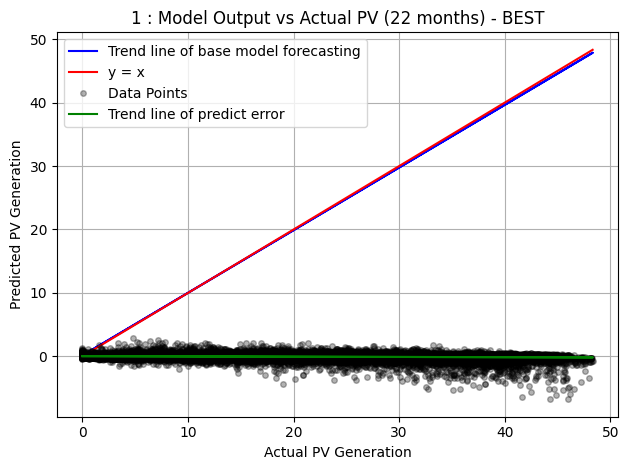

1
------------------------------------------------------------------------------------------------------
BEST
2
lgb svr
gdrive/MyDrive/reforecast/result_of_paper/after_feature_selection_for_all_models_reforecast_with_pred_data/final_result_lgb_2_.csv
slope: 0.981366882935416 intercept: 0.3740124008034287
error_slope: -0.008450979545967359 error_intercept: 0.14620470380428244


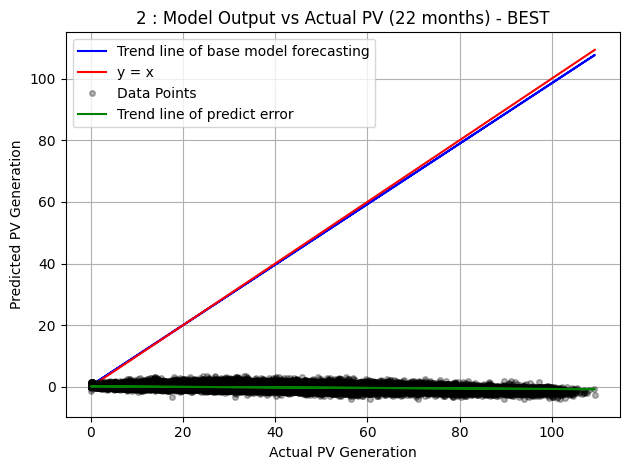

2
------------------------------------------------------------------------------------------------------
BEST
4
mlr svr
gdrive/MyDrive/reforecast/result_of_paper/after_feature_selection_for_all_models_reforecast_with_pred_data/final_result_mlr_4_.csv
slope: 0.9549236191430472 intercept: 1.0181259877994013
error_slope: -0.023157643307698334 error_intercept: 0.6391832255401778


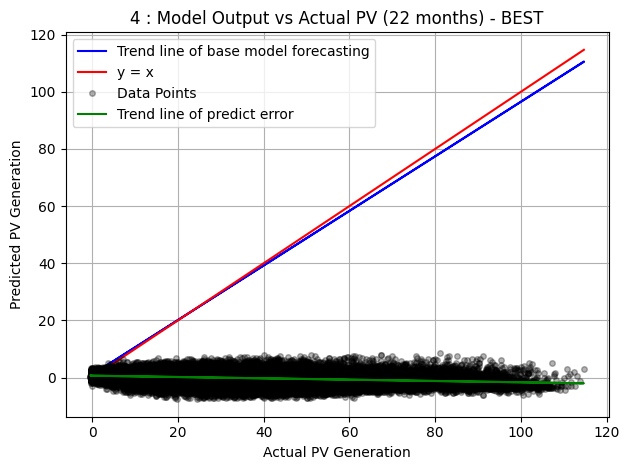

4
------------------------------------------------------------------------------------------------------
BEST
5
mlr svr
gdrive/MyDrive/reforecast/result_of_paper/after_feature_selection_for_all_models_reforecast_with_pred_data/final_result_mlr_5_.csv
slope: 0.9448165966306471 intercept: 1.0529784206550241
error_slope: -0.030059307707310353 error_intercept: 0.6313590339427123


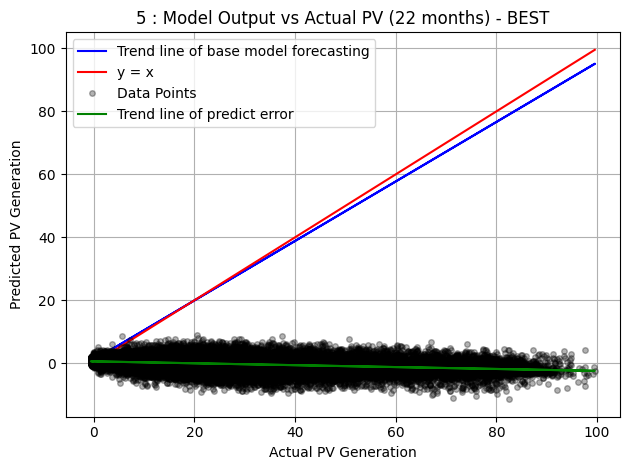

5
------------------------------------------------------------------------------------------------------
BEST
6
mlr svr
gdrive/MyDrive/reforecast/result_of_paper/after_feature_selection_for_all_models_reforecast_with_pred_data/final_result_mlr_6_.csv
slope: 0.9653253372924888 intercept: 0.28446809226749303
error_slope: -0.021761165837410654 error_intercept: 0.19083371689169862


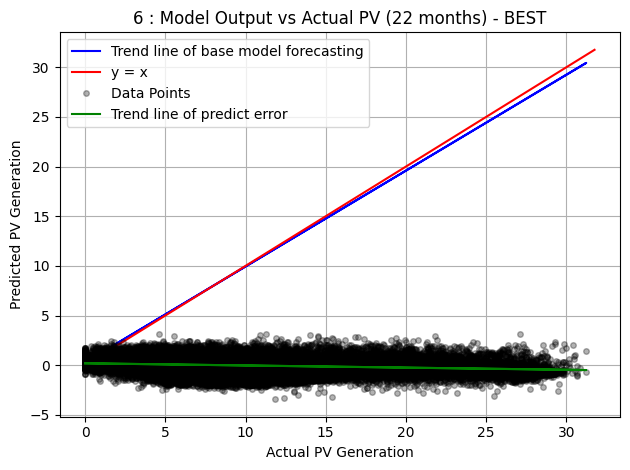

6
------------------------------------------------------------------------------------------------------
BEST
7
mlr svr
gdrive/MyDrive/reforecast/result_of_paper/after_feature_selection_for_all_models_reforecast_with_pred_data/final_result_mlr_7_.csv
slope: 0.9397971353773024 intercept: 0.4077504619776616
error_slope: -0.03235307712056284 error_intercept: 0.24281887222124168


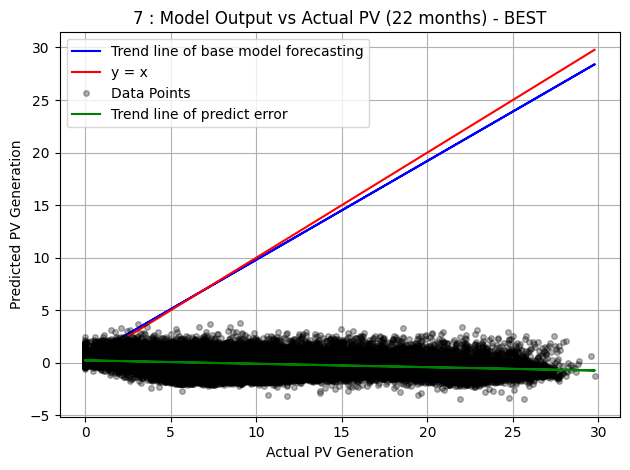

7
------------------------------------------------------------------------------------------------------
BEST
8
lgb svr
gdrive/MyDrive/reforecast/result_of_paper/after_feature_selection_for_all_models_reforecast_with_pred_data/final_result_lgb_8_.csv
slope: 0.9893667631926866 intercept: 0.046395155100277086
error_slope: 0.002914171794987532 error_intercept: -0.01762385248217286


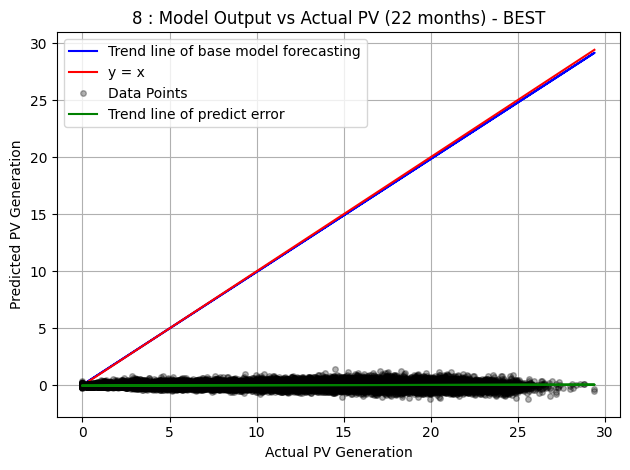

8


In [ ]:
best_or_worst = 'best'
# best_or_worst = 'worst'
for (forecast_model,reforecast_model), (start_str, end_str), site_num in zip(best_model_combos, operation_hours_array, [1,2,4,5,6,7,8]):
  print('------------------------------------------------------------------------------------------------------')
  print(f'{best_or_worst.upper()}')

  print(site_num)
  print(forecast_model, reforecast_model)

  reforecast_file = f"gdrive/MyDrive/reforecast/result_of_paper/after_feature_selection_for_all_models_reforecast_with_pred_data/final_result_{forecast_model}_{site_num}_.csv"
  forecast_22mon_file = f'gdrive/MyDrive/reforecast/0526/22_mon_forecast_result/{str(site_num)}_test.csv'

  reforecast_df = pd.read_csv(reforecast_file)
  forecast_22mon_df = pd.read_csv(forecast_22mon_file)

  df_list = [reforecast_df, forecast_22mon_df]

  for df in df_list:
    split_index = int(len(df) * train_size)
    df = df.iloc[:split_index]


  forecast_22mon_df[f'pred_{forecast_model}'] = forecast_22mon_df[f'pred_{forecast_model}'].apply(lambda x: max(x, 0))

  for d in df_list:
    df = d.copy()
    df['Time'] = pd.to_datetime(df['Time'])

    start_time = time.fromisoformat(start_str)
    end_time = time.fromisoformat(end_str)

    d = df[df['Time'].dt.time.between(start_time, end_time)]

  reforecast_df = df_list[0]
  forecast_22mon_df = df_list[1]

  print(reforecast_file)

  temp = pd.merge(
      reforecast_df[['Time', 'Power (MW)']],
      reforecast_df[['Time', f'pred_error_{reforecast_model}']],
      on='Time',
      how='inner'
  )

  merged = pd.merge(
      temp,
      forecast_22mon_df[['Time', f'pred_{forecast_model}']],
      on='Time',
      how='inner'
  )
  merged.dropna(inplace=True)


  # 추세선
  base_model_forecast_pred_df = pd.DataFrame({
      'y_true': merged['Power (MW)'], # x
      'y_pred': merged[f'pred_{forecast_model}'] # y
  }).dropna()

  slope, intercept = np.polyfit(base_model_forecast_pred_df['y_true'], base_model_forecast_pred_df['y_pred'], 1)
  trend_line = slope * base_model_forecast_pred_df['y_true'] + intercept
  print(f'slope: {slope} intercept: {intercept}')
  plt.plot(base_model_forecast_pred_df['y_true'], trend_line, 'b-', label='Trend line of base model forecasting')

  # 빨간 실선 (y = x)
  x_vals = np.linspace(min(base_model_forecast_pred_df['y_true'].min(), base_model_forecast_pred_df['y_pred'].min()), #x min, y min
                      max(base_model_forecast_pred_df['y_true'].max(), base_model_forecast_pred_df['y_pred'].max()), 100)
  plt.plot(x_vals, x_vals, 'r-', label='y = x')

  #error spot point (), error = pred - actual
  error_spot_point_df = pd.DataFrame({
      'y_true': merged['Power (MW)'], # x
      'y_pred_error': merged[f'pred_error_{reforecast_model}']
  }).dropna()

  plt.plot(error_spot_point_df['y_true'].values, error_spot_point_df['y_pred_error'].values, 'o', label='Data Points', markersize=4, color='black', alpha = 0.3)
  error_slope, error_intercept = np.polyfit(error_spot_point_df['y_true'], error_spot_point_df['y_pred_error'], 1)
  error_trend_line = error_slope * error_spot_point_df['y_true'] + error_intercept
  print(f'error_slope: {error_slope} error_intercept: {error_intercept}')
  plt.plot(error_spot_point_df['y_true'], error_trend_line, '-', label='Trend line of predict error', color = 'green')

  # reforecast : pred_pv - pred_error

  plt.xlabel('Actual PV Generation')
  plt.ylabel('Predicted PV Generation')
  plt.title(f'{site_num} : Model Output vs Actual PV (22 months) - {best_or_worst.upper()}')
  plt.legend()
  plt.grid(True)
  plt.tight_layout()
  plt.show()

  print(site_num)



------------------------------------------------------------------------------------------------------
BEST
1
svr svr
gdrive/MyDrive/reforecast/result_of_paper/after_feature_selection_for_all_models_reforecast_with_pred_data/final_result_svr_1_.csv
slope: 0.9823758940032544 intercept: 0.2921741503834448


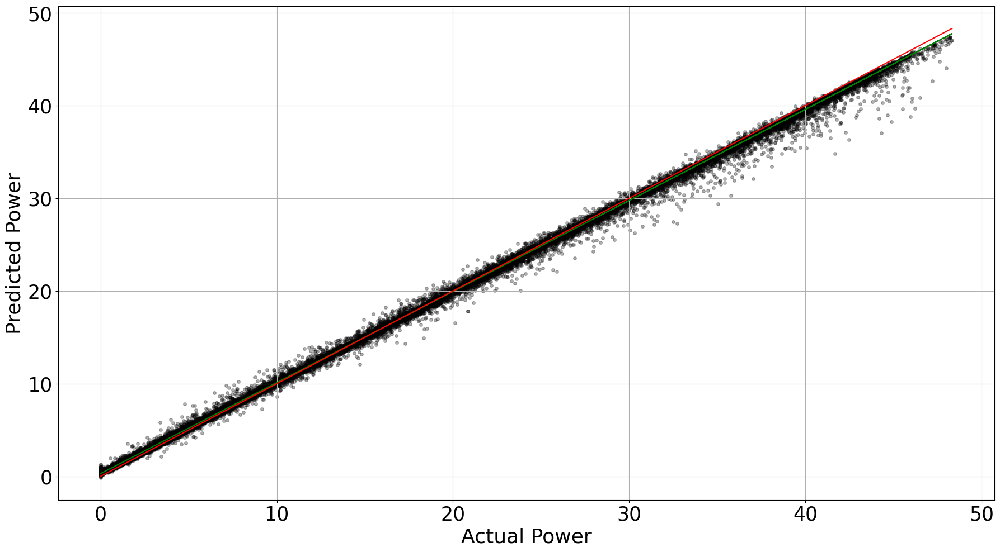

1
------------------------------------------------------------------------------------------------------
BEST
2
lgb svr
gdrive/MyDrive/reforecast/result_of_paper/after_feature_selection_for_all_models_reforecast_with_pred_data/final_result_lgb_2_.csv
slope: 0.9819926450336307 intercept: 0.3594463133419018


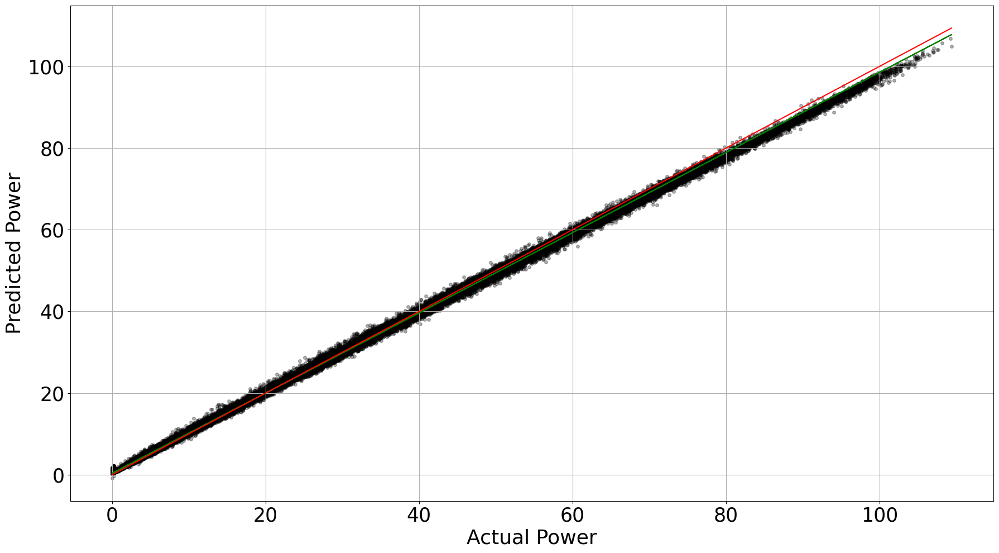

2
------------------------------------------------------------------------------------------------------
BEST
4
mlr svr
gdrive/MyDrive/reforecast/result_of_paper/after_feature_selection_for_all_models_reforecast_with_pred_data/final_result_mlr_4_.csv
slope: 0.9545569913852482 intercept: 1.0372543176048858


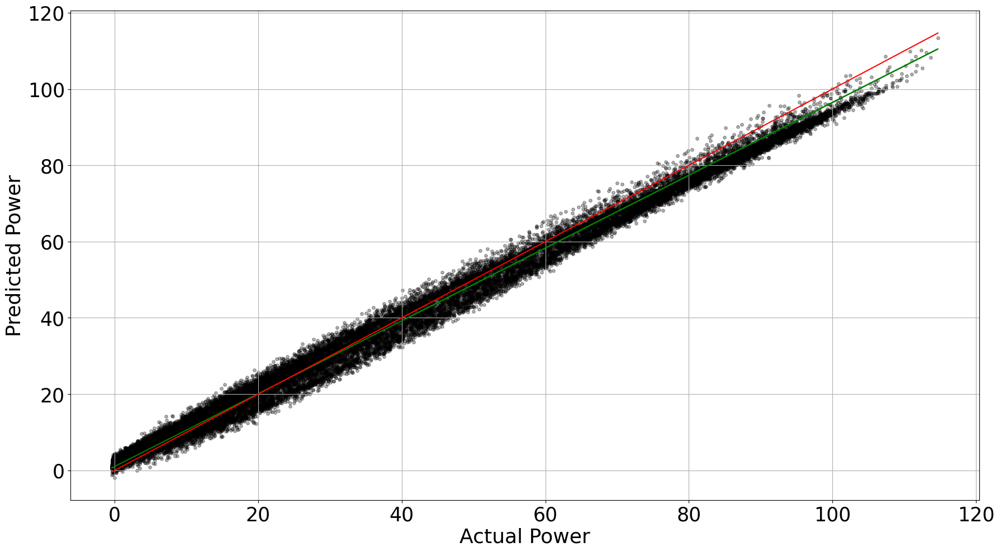

4
------------------------------------------------------------------------------------------------------
BEST
5
mlr svr
gdrive/MyDrive/reforecast/result_of_paper/after_feature_selection_for_all_models_reforecast_with_pred_data/final_result_mlr_5_.csv
slope: 0.9440997848783652 intercept: 1.076983187530723


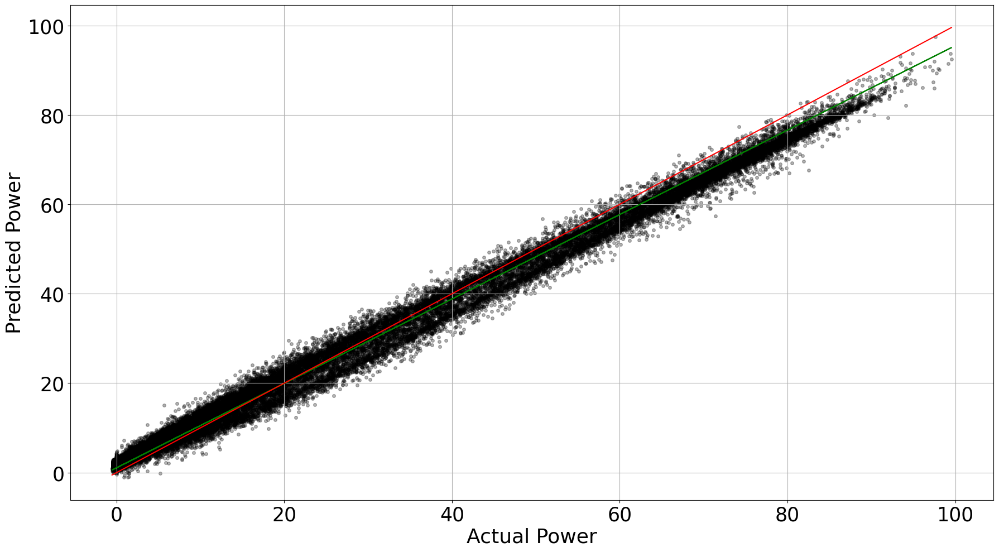

5
------------------------------------------------------------------------------------------------------
BEST
6
mlr svr
gdrive/MyDrive/reforecast/result_of_paper/after_feature_selection_for_all_models_reforecast_with_pred_data/final_result_mlr_6_.csv
slope: 0.951971581878305 intercept: 0.5391507343128277


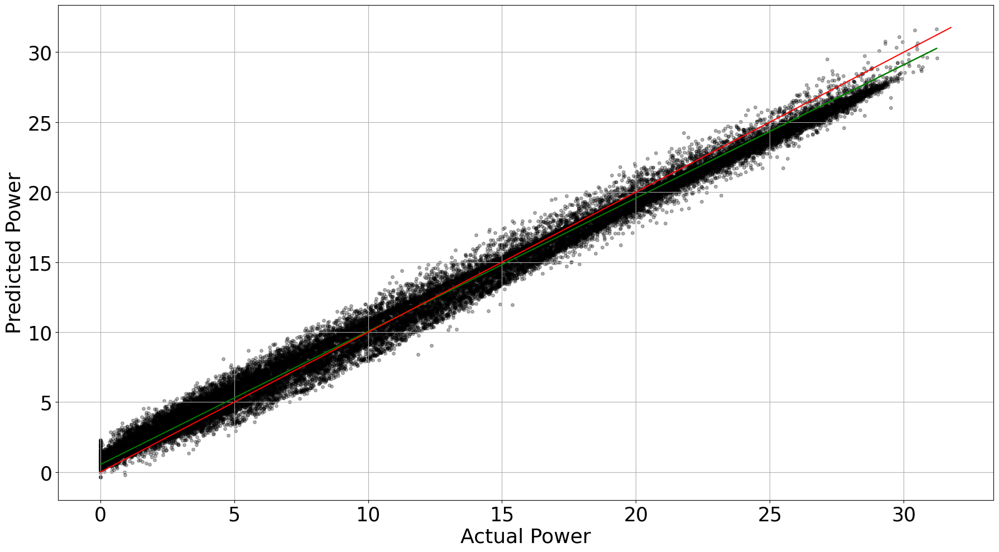

6
------------------------------------------------------------------------------------------------------
BEST
7
mlr svr
gdrive/MyDrive/reforecast/result_of_paper/after_feature_selection_for_all_models_reforecast_with_pred_data/final_result_mlr_7_.csv
slope: 0.9163752955504963 intercept: 0.7869655140700725


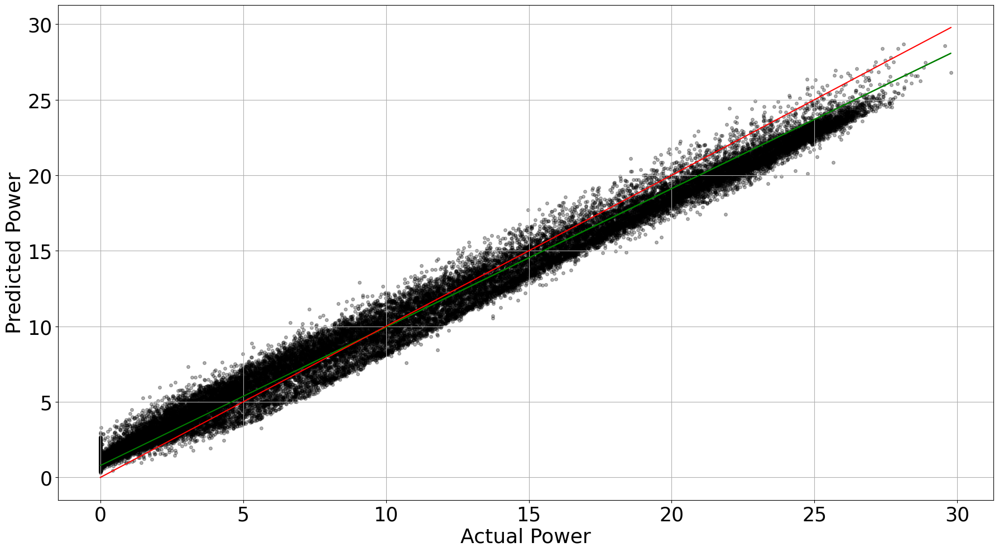

7
------------------------------------------------------------------------------------------------------
BEST
8
lgb svr
gdrive/MyDrive/reforecast/result_of_paper/after_feature_selection_for_all_models_reforecast_with_pred_data/final_result_lgb_8_.csv
slope: 0.9843221899081429 intercept: 0.11810954494284276


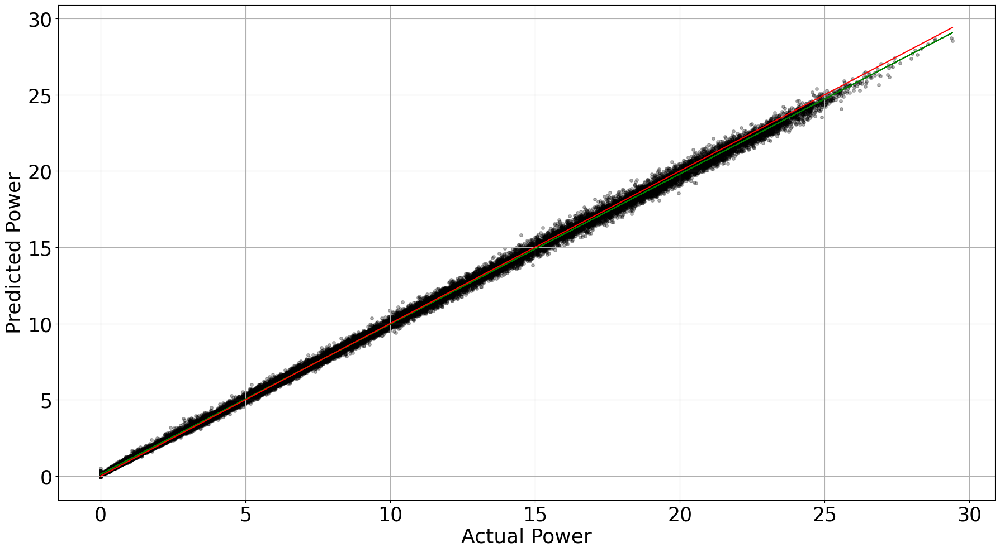

8


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import time

best_or_worst = 'best'
# best_or_worst = 'worst'
for (forecast_model, reforecast_model), (start_str, end_str), site_num in zip(best_model_combos, operation_hours_array, [1, 2, 4, 5, 6, 7, 8]):
    print('------------------------------------------------------------------------------------------------------')
    print(f'{best_or_worst.upper()}')

    print(site_num)
    print(forecast_model, reforecast_model)

    reforecast_file = f"gdrive/MyDrive/reforecast/result_of_paper/after_feature_selection_for_all_models_reforecast_with_pred_data/final_result_{forecast_model}_{site_num}_.csv"
    forecast_22mon_file = f'gdrive/MyDrive/reforecast/0526/22_mon_forecast_result/{str(site_num)}_test.csv'

    reforecast_df = pd.read_csv(reforecast_file)
    forecast_22mon_df = pd.read_csv(forecast_22mon_file)

    df_list = [reforecast_df, forecast_22mon_df]

    for i in range(2):
        split_index = int(len(df_list[i]) * train_size)
        df_list[i] = df_list[i].iloc[:split_index]

    forecast_22mon_df = df_list[1]
    forecast_22mon_df[f'pred_{forecast_model}'] = forecast_22mon_df[f'pred_{forecast_model}'].apply(lambda x: max(x, 0))

    for i in range(2):
        df = df_list[i].copy()
        df['Time'] = pd.to_datetime(df['Time'])
        start_time = time.fromisoformat(start_str)
        end_time = time.fromisoformat(end_str)
        df_list[i] = df[df['Time'].dt.time.between(start_time, end_time)]

    reforecast_df = df_list[0]
    forecast_22mon_df = df_list[1]

    print(reforecast_file)

    temp = pd.merge(
        reforecast_df[['Time', 'Power (MW)']],
        reforecast_df[['Time', f'pred_error_{reforecast_model}']],
        on='Time',
        how='inner'
    )

    merged = pd.merge(
        temp,
        forecast_22mon_df[['Time', f'pred_{forecast_model}']],
        on='Time',
        how='inner'
    )
    merged.dropna(inplace=True)

    base_model_forecast_pred_df = pd.DataFrame({
        'y_true': merged['Power (MW)'],
        'y_pred': merged[f'pred_{forecast_model}']
    }).dropna()

    slope, intercept = np.polyfit(base_model_forecast_pred_df['y_true'], base_model_forecast_pred_df['y_pred'], 1)
    print(f'slope: {slope} intercept: {intercept}')

    error_spot_point_df = pd.DataFrame({
        'y_true': merged['Power (MW)'],
        'residual': merged[f'pred_error_{reforecast_model}']
    }).dropna()

    # ▶ 비율 1.8:1 → 예시: (18, 10)
    fig, ax = plt.subplots(figsize=(18, 10))

    adjusted_y_pred = slope * error_spot_point_df['y_true'] + intercept + error_spot_point_df['residual']
    ax.plot(error_spot_point_df['y_true'].values, adjusted_y_pred.values, 'o',
            markersize=4, color='black', alpha=0.3, zorder=1)

    trend_line = slope * base_model_forecast_pred_df['y_true'] + intercept
    ax.plot(base_model_forecast_pred_df['y_true'], trend_line, '-', zorder=2, color='green')

    x_vals = np.linspace(
        min(base_model_forecast_pred_df['y_true'].min(), base_model_forecast_pred_df['y_pred'].min()),
        max(base_model_forecast_pred_df['y_true'].max(), base_model_forecast_pred_df['y_pred'].max()), 100)
    ax.plot(x_vals, x_vals, 'r-', zorder=2)

    # 축 및 스타일
    ax.set_xlabel('Actual Power', fontsize=26)
    ax.set_ylabel('Predicted Power', fontsize=26)
    ax.tick_params(axis='both', labelsize=25)
    ax.grid(True)

    # ▶ 범례 제거 (fig.legend 삭제)
    plt.tight_layout()
    plt.show()

    print(site_num)


/tmp/ipython-input-3021474356.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  splited_df['Time'] = pd.to_datetime(splited_df['Time'])
/tmp/ipython-input-3021474356.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  splited_df['Time'] = pd.to_datetime(splited_df['Time'])
/tmp/ipython-input-3021474356.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pa

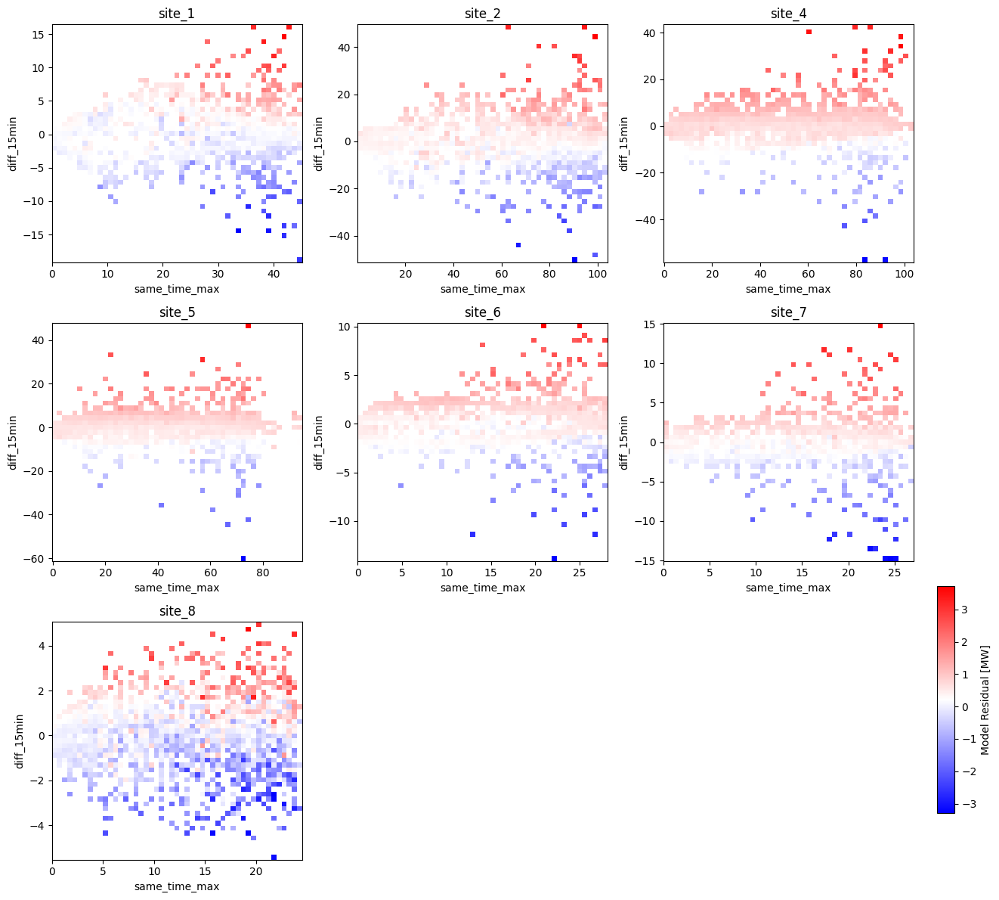

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from datetime import time

train_size = 22 / 24

operation_hours_array = [
    ('06:00', '21:30'),
    ('00:00', '23:59'),
    ('00:00', '23:59'),
    ('00:00', '23:59'),
    ('06:00', '21:00'),
    ('06:00', '21:00'),
    ('06:00', '19:00')
]

reforecast_dfs=[]
for (best_forecast_model, best_reforecast_model), site_num, (start_str, end_str) in zip(best_model_combos, [1, 2, 4, 5, 6, 7, 8], operation_hours_array):
    reforecast_file = f"gdrive/MyDrive/reforecast/result_of_paper/after_feature_selection_for_all_models_reforecast_with_pred_data/final_result_{best_forecast_model}_{site_num}_.csv"
    reforecast_df = pd.read_csv(reforecast_file)

    split_index = int(len(reforecast_df) * train_size)
    splited_df = reforecast_df.iloc[split_index:]
    splited_df['Time'] = pd.to_datetime(splited_df['Time'])

    start_time = time.fromisoformat(start_str)
    end_time = time.fromisoformat(end_str)

    filtered_df = splited_df[splited_df['Time'].dt.time.between(start_time, end_time)]
    reforecast_dfs.append(filtered_df)

fig, axes = plt.subplots(3, 3, figsize=(15, 12))
fig.subplots_adjust(hspace=0.4, wspace=0.3)

cmap = plt.get_cmap('bwr').copy()
cmap.set_bad(color='white')

last_mesh = None

for idx, ax in enumerate(axes.flat):
    if idx < len(reforecast_dfs):
        df = reforecast_dfs[idx]

        x = df['same_time_max']
        # x = df['Total solar irradiance (W/m2)']
        y = df['diff_15min']
        c = -df[f'error_{best_model_combos[idx][0]}']

        x_bins = np.linspace(x.min(), x.max(), 50)
        y_bins = np.linspace(y.min(), y.max(), 50)

        heatmap, xedges, yedges = np.histogram2d(x, y, bins=[x_bins, y_bins], weights=c)
        counts, _, _ = np.histogram2d(x, y, bins=[x_bins, y_bins])

        avg_residual = np.divide(heatmap, counts, out=np.full_like(heatmap, np.nan), where=counts != 0)
        masked_avg = np.ma.masked_invalid(avg_residual)

        mesh = ax.pcolormesh(xedges, yedges, masked_avg.T, cmap=cmap, shading='auto')
        last_mesh = mesh

        ax.set_title(f"site_{[1, 2, 4, 5, 6, 7, 8][idx]}")
        ax.set_xlabel("same_time_max")
        ax.set_ylabel("diff_15min")
    else:
        ax.axis('off')

# 공통 colorbar
cbar_ax = fig.add_axes([0.83, 0.1, 0.015, 0.25])
fig.colorbar(last_mesh, cax=cbar_ax).set_label('Model Residual [MW]')

plt.tight_layout(rect=[0, 0, 0.82, 1])
plt.show()


In [ ]:
reforecast_dfs[0].columns

Index(['Unnamed: 0', 'Total solar irradiance (W/m2)', 'Air temperature  (°C) ',
       'Atmosphere (hpa)', 'hour_sin', 'hour_cos', 'month_sin', 'month_cos',
       'same_time_mean', 'same_time_std', 'same_time_max', 'same_time_min',
       'same_weekday_mean', 'same_weekday_std', 'same_weekday_max',
       'same_weekday_min', 'overall_mean', 'overall_std', 'overall_max',
       'overall_min', 'lag_1', 'lag_2', 'lag_3', 'lag_4', 'lag_5', 'lag_6',
       'lag_7', 'lag_8', 'diff_15min', 'diff_30min', 'diff_45min',
       'diff_60min', 'diff_75min', 'diff_90min', 'diff_105min', 'pred_mlr',
       'pred_svr', 'pred_lgb', 'Time', 'error_mlr', 'error_svr', 'error_lgb',
       'error_mlr_shifted', 'error_svr_shifted', 'pred_error_mlr',
       'pred_error_svr', 'pred_error_lgb', 'reforecasted_PV_mlr',
       'reforecasted_PV_svr', 'reforecasted_PV_lgb', 'Power (MW)'],
      dtype='object')

/tmp/ipython-input-569196809.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  splited_df['Time'] = pd.to_datetime(splited_df['Time'])
/tmp/ipython-input-569196809.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  splited_df['Time'] = pd.to_datetime(splited_df['Time'])
/tmp/ipython-input-569196809.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://panda

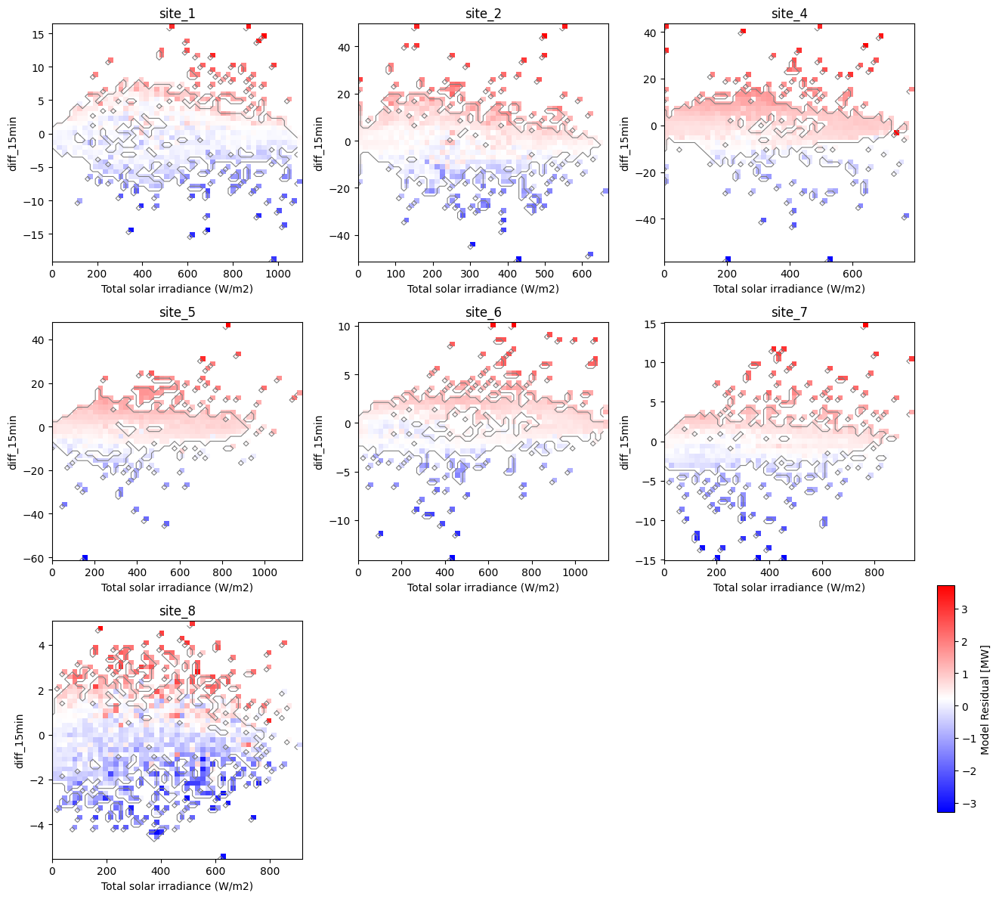

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from datetime import time
from skimage import measure  # 윤곽선 추출용

train_size = 22 / 24

operation_hours_array = [
    ('06:00', '21:30'),
    ('00:00', '23:59'),
    ('00:00', '23:59'),
    ('00:00', '23:59'),
    ('06:00', '21:00'),
    ('06:00', '21:00'),
    ('06:00', '19:00')
]

reforecast_dfs = []
for (best_forecast_model, best_reforecast_model), site_num, (start_str, end_str) in zip(best_model_combos, [1, 2, 4, 5, 6, 7, 8], operation_hours_array):
    reforecast_file = f"gdrive/MyDrive/reforecast/result_of_paper/after_feature_selection_for_all_models_reforecast_with_pred_data/final_result_{best_forecast_model}_{site_num}_.csv"
    reforecast_df = pd.read_csv(reforecast_file)

    split_index = int(len(reforecast_df) * train_size)
    splited_df = reforecast_df.iloc[split_index:]
    splited_df['Time'] = pd.to_datetime(splited_df['Time'])

    start_time = time.fromisoformat(start_str)
    end_time = time.fromisoformat(end_str)

    filtered_df = splited_df[splited_df['Time'].dt.time.between(start_time, end_time)]
    reforecast_dfs.append(filtered_df)

fig, axes = plt.subplots(3, 3, figsize=(15, 12))
fig.subplots_adjust(hspace=0.4, wspace=0.3)

cmap = plt.get_cmap('bwr').copy()
cmap.set_bad(color='white')

last_mesh = None

for idx, ax in enumerate(axes.flat):
    if idx < len(reforecast_dfs):
        df = reforecast_dfs[idx]

        x = df['Total solar irradiance (W/m2)']
        y = df['diff_15min']
        c = -df[f'error_{best_model_combos[idx][0]}']

        x_bins = np.linspace(x.min(), x.max(), 50)
        y_bins = np.linspace(y.min(), y.max(), 50)

        heatmap, xedges, yedges = np.histogram2d(x, y, bins=[x_bins, y_bins], weights=c)
        counts, _, _ = np.histogram2d(x, y, bins=[x_bins, y_bins])

        avg_residual = np.divide(heatmap, counts, out=np.full_like(heatmap, np.nan), where=counts != 0)
        masked_avg = np.ma.masked_invalid(avg_residual)

        mesh = ax.pcolormesh(xedges, yedges, masked_avg.T, cmap=cmap, shading='auto')
        last_mesh = mesh

        # ▶️ gray boundary 추가
        binary_mask = counts.T > 0  # shape: (y_bins-1, x_bins-1)
        contours = measure.find_contours(binary_mask.astype(float), 0.5)

        for contour in contours:
            contour = np.array(contour)
            cx = xedges[0] + (xedges[1] - xedges[0]) * contour[:, 1]
            cy = yedges[0] + (yedges[1] - yedges[0]) * contour[:, 0]
            ax.plot(cx, cy, color='gray', linewidth=0.8)

        ax.set_title(f"site_{[1, 2, 4, 5, 6, 7, 8][idx]}")
        ax.set_xlabel("Total solar irradiance (W/m2)")
        ax.set_ylabel("diff_15min")
    else:
        ax.axis('off')

# 공통 colorbar
cbar_ax = fig.add_axes([0.83, 0.1, 0.015, 0.25])
fig.colorbar(last_mesh, cax=cbar_ax).set_label('Model Residual [MW]')

plt.tight_layout(rect=[0, 0, 0.82, 1])
plt.show()


In [ ]:
reforecast_dfs[0].columns

Index(['Unnamed: 0', 'Total solar irradiance (W/m2)', 'Air temperature  (°C) ',
       'Atmosphere (hpa)', 'hour_sin', 'hour_cos', 'month_sin', 'month_cos',
       'same_time_mean', 'same_time_std', 'same_time_max', 'same_time_min',
       'same_weekday_mean', 'same_weekday_std', 'same_weekday_max',
       'same_weekday_min', 'overall_mean', 'overall_std', 'overall_max',
       'overall_min', 'lag_1', 'lag_2', 'lag_3', 'lag_4', 'lag_5', 'lag_6',
       'lag_7', 'lag_8', 'diff_15min', 'diff_30min', 'diff_45min',
       'diff_60min', 'diff_75min', 'diff_90min', 'diff_105min', 'pred_mlr',
       'pred_svr', 'pred_lgb', 'Time', 'error_mlr', 'error_svr', 'error_lgb',
       'error_mlr_shifted', 'error_svr_shifted', 'pred_error_mlr',
       'pred_error_svr', 'pred_error_lgb', 'reforecasted_PV_mlr',
       'reforecasted_PV_svr', 'reforecasted_PV_lgb', 'Power (MW)'],
      dtype='object')

In [ ]:
df.columns

Index(['Unnamed: 0', 'Total solar irradiance (W/m2)', 'Air temperature  (°C) ',
       'Atmosphere (hpa)', 'hour_sin', 'hour_cos', 'month_sin', 'month_cos',
       'same_time_mean', 'same_time_std', 'same_time_max', 'same_time_min',
       'same_weekday_mean', 'same_weekday_std', 'same_weekday_max',
       'same_weekday_min', 'overall_mean', 'overall_std', 'overall_max',
       'overall_min', 'lag_1', 'lag_2', 'lag_3', 'lag_4', 'lag_5', 'lag_6',
       'lag_7', 'lag_8', 'diff_15min', 'diff_30min', 'diff_45min',
       'diff_60min', 'diff_75min', 'diff_90min', 'diff_105min', 'pred_mlr',
       'pred_svr', 'pred_lgb', 'Time', 'error_mlr', 'error_svr', 'error_lgb',
       'error_mlr_shifted', 'error_svr_shifted', 'error_lgb_shifted',
       'pred_error_mlr', 'pred_error_svr', 'pred_error_lgb',
       'reforecasted_PV_mlr', 'reforecasted_PV_svr', 'reforecasted_PV_lgb',
       'Power (MW)'],
      dtype='object')

/tmp/ipython-input-3414973654.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


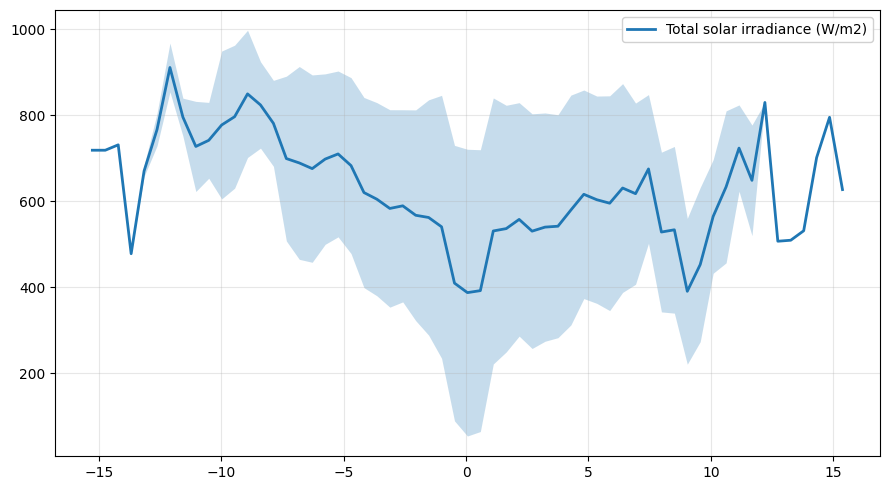

/tmp/ipython-input-3414973654.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


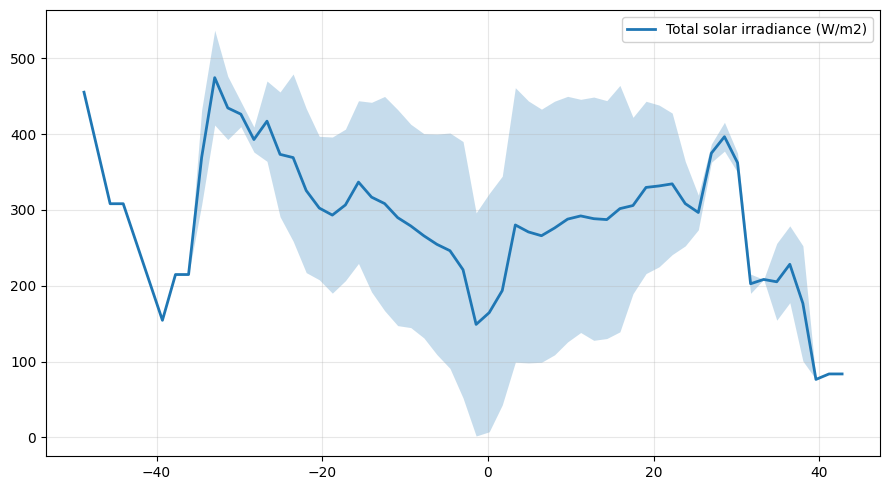

/tmp/ipython-input-3414973654.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


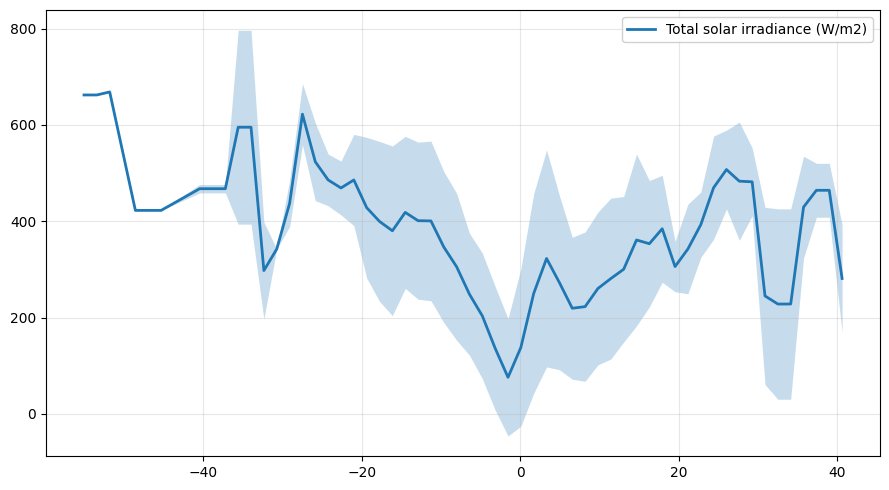

/tmp/ipython-input-3414973654.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


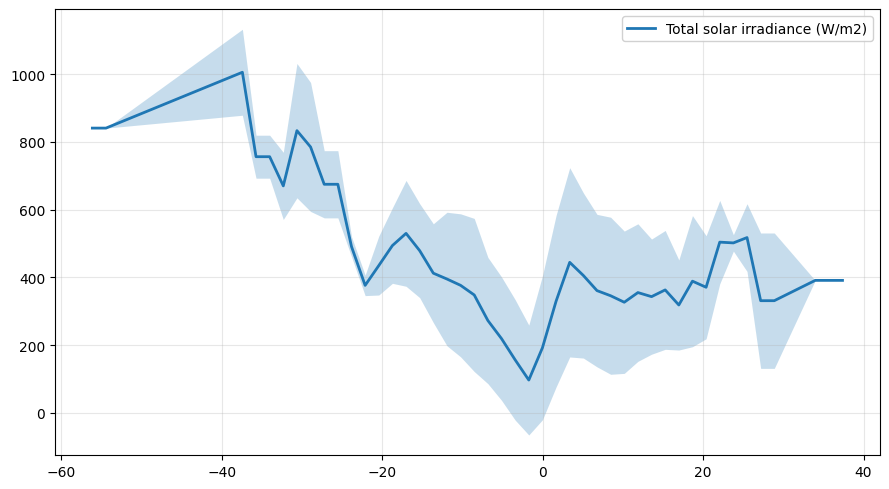

/tmp/ipython-input-3414973654.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


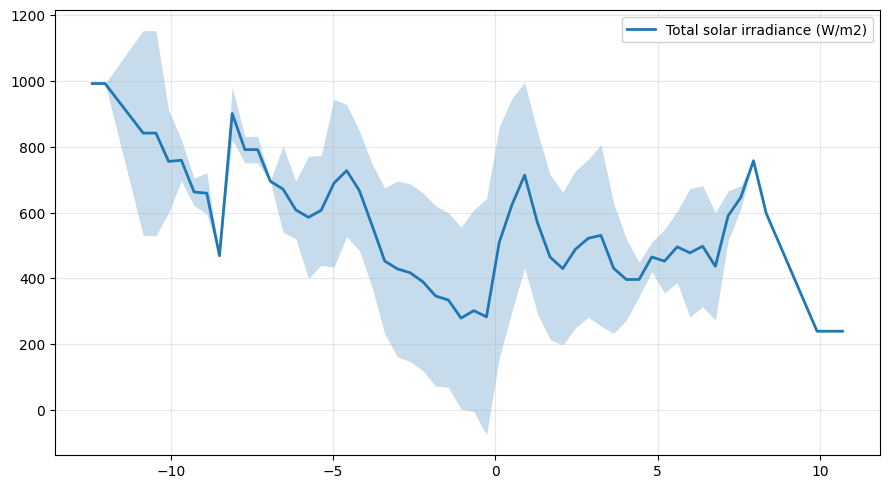

/tmp/ipython-input-3414973654.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


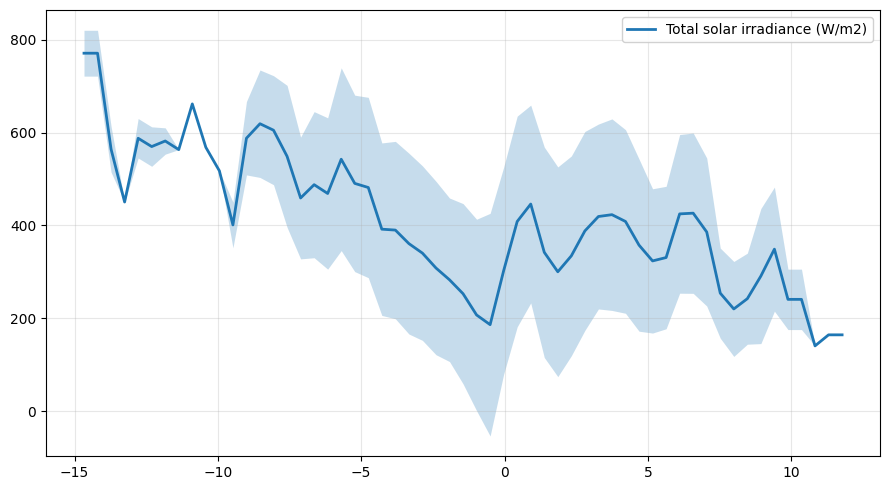

/tmp/ipython-input-3414973654.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


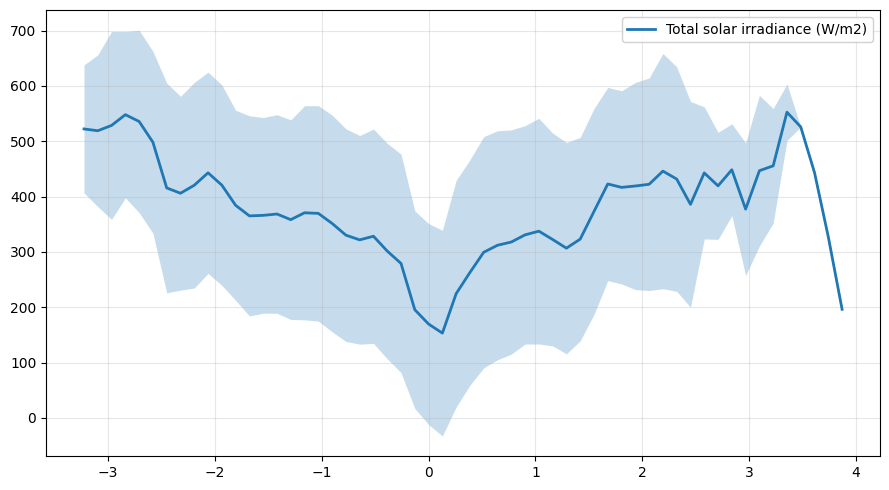

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def plot_mean_variance_band_over_c(
    df: pd.DataFrame,
    forecast_model: str,
    var_names: list,
    n_bins: int = 60,
    smooth_window: int = 3,  # 이동평균으로 살짝만 부드럽게
):
    """
    x: c = -error_{forecast_model}.shift(-1)
    y: var_names에 주어진 각 변수 컬럼
    중앙선: bin별 y의 평균
    음영: bin별 y의 분산(= var). (요청대로 '분산'을 그대로 사용)
    """

    # 1) x = c 만들기
    c = -df[f'error_{forecast_model}'].shift(-1)

    # 공통 x-bin 정의 (모든 변수에 동일 bin 사용)
    c_clean = pd.to_numeric(c, errors="coerce").replace([np.inf, -np.inf], np.nan)
    c_clean = c_clean.dropna()
    if len(c_clean) < 5:
        raise ValueError("c 데이터가 너무 적습니다.")

    # bin 경계와 bin center
    bins = np.linspace(c_clean.min(), c_clean.max(), n_bins + 1)
    bin_centers = (bins[:-1] + bins[1:]) / 2.0

    fig, ax = plt.subplots(figsize=(9, 5))

    for name in var_names:
        if name not in df.columns:
            # error_{forecast_model} 같은 포맷 대응
            if name.startswith("error_") or name.startswith("pred_error_"):
                # 이미 f-string으로 만들어졌다고 가정, 못 찾으면 스킵
                print(f"[warn] '{name}' 컬럼을 찾을 수 없습니다. 스킵합니다.")
                continue
            print(f"[warn] '{name}' 컬럼을 찾을 수 없습니다. 스킵합니다.")
            continue

        y = pd.to_numeric(df[name], errors="coerce").replace([np.inf, -np.inf], np.nan)

        # x, y 정렬 및 NaN 제거
        xy = pd.DataFrame({"c": c, "y": y}).dropna()

        if xy.empty:
            print(f"[warn] '{name}' 유효 데이터가 없습니다. 스킵합니다.")
            continue

        # 2) 같은 bin에 속한 값들로 그룹 통계(평균, 분산) 계산
        cats = pd.cut(xy["c"], bins=bins, include_lowest=True, right=False)
        grouped = xy.groupby(cats)["y"]

        y_mean = grouped.mean()
        y_std = grouped.std(ddof=0)
        y_std = y_std.reindex(pd.Categorical(cats.cat.categories, ordered=True))

        # bin이 비어 있을 수 있으므로, 전체 길이에 맞춰 재배치
        # (카테고리 순서대로 값이 있으나, 빠진 bin은 NaN)
        y_mean = y_mean.reindex(pd.Categorical(cats.cat.categories, ordered=True))
        y_std = y_std.reindex(pd.Categorical(cats.cat.categories, ordered=True))

        # 3) 간단 스무딩(이동평균) — 보기 좋게만 살짝
        if smooth_window and smooth_window > 1:
            y_mean = y_mean.rolling(smooth_window, min_periods=1, center=True).mean()
            y_std = y_std.rolling(smooth_window, min_periods=1, center=True).mean()

        # 4) 라인 + 분산 밴드 (mean ± variance) — 요청대로 'variance' 사용
        y_lower = y_mean - y_std
        y_upper = y_mean + y_std

        # 시각화를 위해 NaN 마스크 처리
        mask = ~y_mean.isna()
        x_plot = bin_centers[mask.to_numpy()]
        mean_plot = y_mean[mask].to_numpy()
        low_plot = y_lower[mask].to_numpy()
        up_plot = y_upper[mask].to_numpy()

        # 선 + 음영
        line = ax.plot(x_plot, mean_plot, label=name, linewidth=2)
        color = line[0].get_color()
        ax.fill_between(x_plot, low_plot, up_plot, alpha=0.25, linewidth=0, color=color)

    # 축/범례 설정
    ax.set_xlabel("")  # 필요하면 "c = -error.shift(-1)" 등으로 바꿔도 됨
    ax.set_ylabel("")  # 요청: y축 라벨 비우기
    ax.legend(loc="best", framealpha=0.9)
    ax.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()


# =========================
# 사용 예시 (네 루프 안에서)
# =========================
legends = ['Total solar irradiance (W/m2)']
# 마지막 항목은 f'error_{forecast_model}' 이므로 루프 안에서 추가
for site_idx, site_num in enumerate([1, 2, 4, 5, 6, 7, 8]):
    df = reforecast_dfs[site_idx]
    forecast_model = best_model_combos[site_idx][0]

    var_names = legends
    plot_mean_variance_band_over_c(
        df=df,
        forecast_model=forecast_model,
        var_names=var_names,
        n_bins=60,
        smooth_window=3
    )


/tmp/ipython-input-3634969321.py:56: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


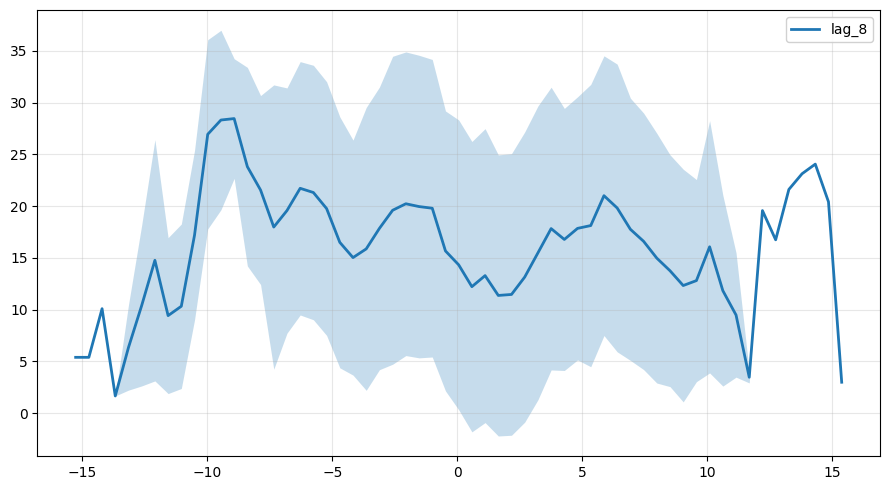

/tmp/ipython-input-3634969321.py:56: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


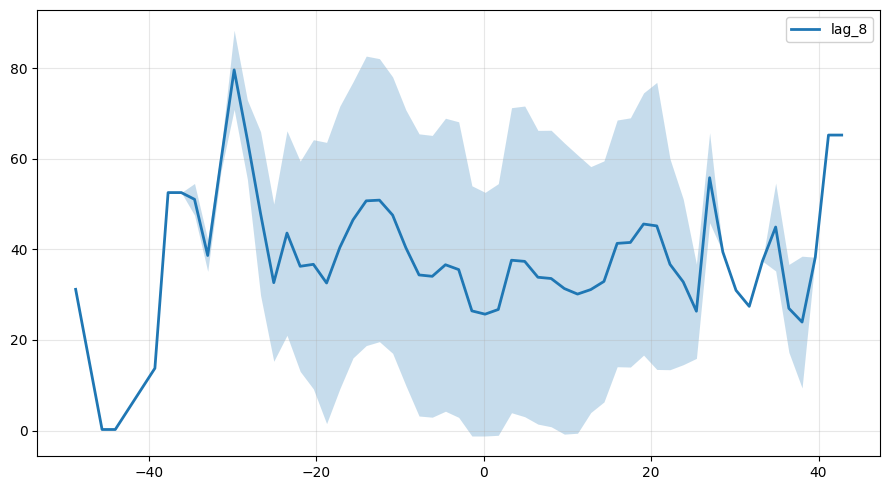

/tmp/ipython-input-3634969321.py:56: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


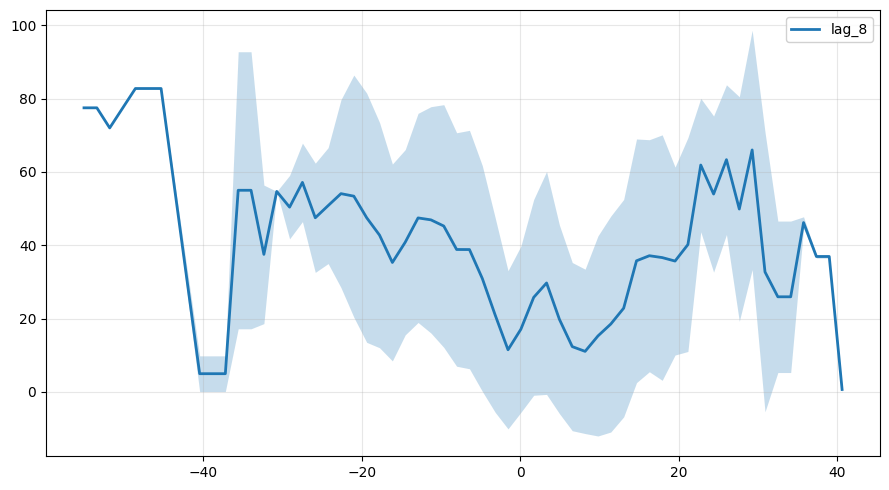

/tmp/ipython-input-3634969321.py:56: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


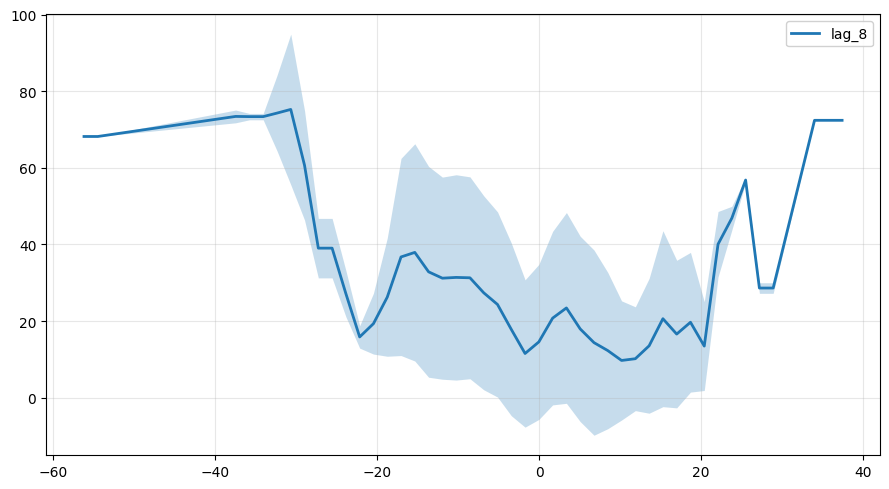

/tmp/ipython-input-3634969321.py:56: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


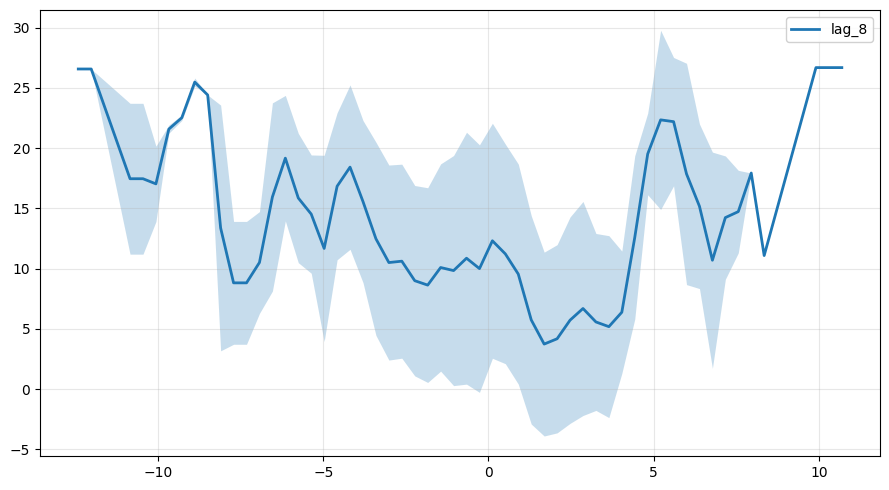

/tmp/ipython-input-3634969321.py:56: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


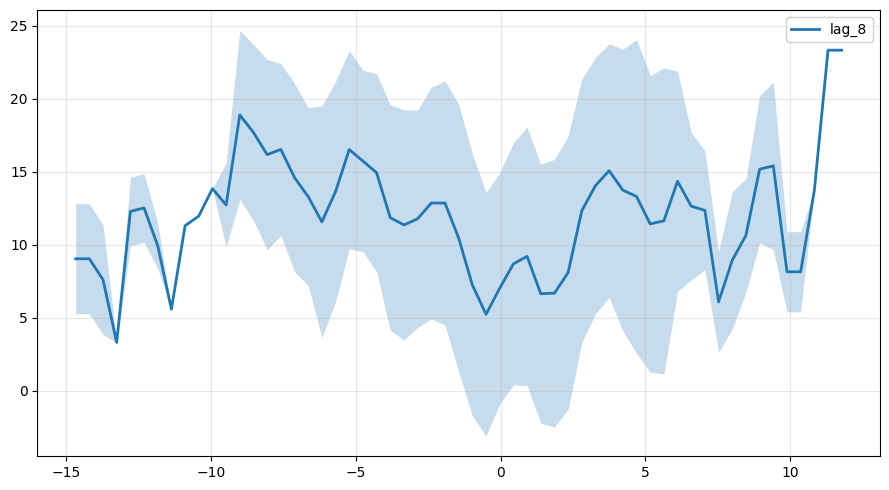

/tmp/ipython-input-3634969321.py:56: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


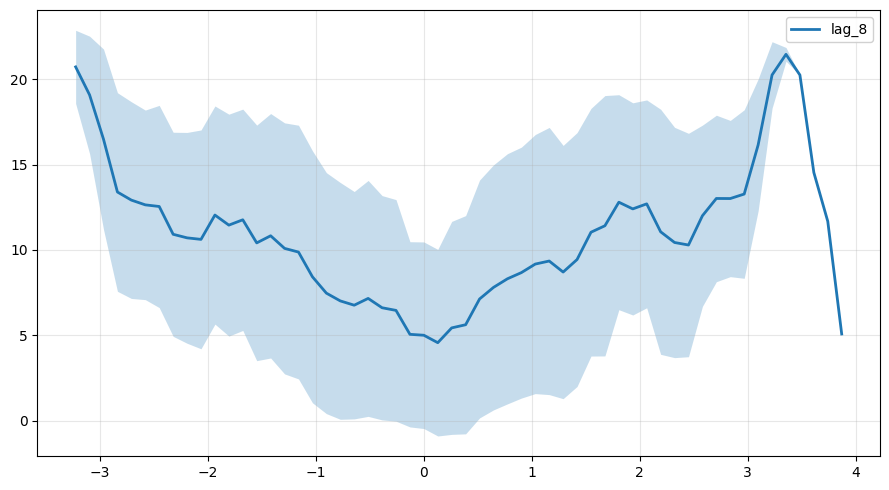

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def plot_mean_variance_band_over_c(
    df: pd.DataFrame,
    forecast_model: str,
    var_names: list,
    n_bins: int = 60,
    smooth_window: int = 3,  # 이동평균으로 살짝만 부드럽게
):
    """
    x: c = -error_{forecast_model}.shift(-1)
    y: var_names에 주어진 각 변수 컬럼
    중앙선: bin별 y의 평균
    음영: bin별 y의 분산(= var). (요청대로 '분산'을 그대로 사용)
    """

    # 1) x = c 만들기
    c = -df[f'error_{forecast_model}'].shift(-1)

    # 공통 x-bin 정의 (모든 변수에 동일 bin 사용)
    c_clean = pd.to_numeric(c, errors="coerce").replace([np.inf, -np.inf], np.nan)
    c_clean = c_clean.dropna()
    if len(c_clean) < 5:
        raise ValueError("c 데이터가 너무 적습니다.")

    # bin 경계와 bin center
    bins = np.linspace(c_clean.min(), c_clean.max(), n_bins + 1)
    bin_centers = (bins[:-1] + bins[1:]) / 2.0

    fig, ax = plt.subplots(figsize=(9, 5))

    for name in var_names:
        if name not in df.columns:
            # error_{forecast_model} 같은 포맷 대응
            if name.startswith("error_") or name.startswith("pred_error_"):
                # 이미 f-string으로 만들어졌다고 가정, 못 찾으면 스킵
                print(f"[warn] '{name}' 컬럼을 찾을 수 없습니다. 스킵합니다.")
                continue
            print(f"[warn] '{name}' 컬럼을 찾을 수 없습니다. 스킵합니다.")
            continue

        y = pd.to_numeric(df[name], errors="coerce").replace([np.inf, -np.inf], np.nan)

        # x, y 정렬 및 NaN 제거
        xy = pd.DataFrame({"c": c, "y": y}).dropna()


        if xy.empty:
            print(f"[warn] '{name}' 유효 데이터가 없습니다. 스킵합니다.")
            continue

        # 2) 같은 bin에 속한 값들로 그룹 통계(평균, 분산) 계산
        cats = pd.cut(xy["c"], bins=bins, include_lowest=True, right=False)
        grouped = xy.groupby(cats)["y"]

        y_mean = grouped.mean()
        y_std = grouped.std(ddof=0)
        y_std = y_std.reindex(pd.Categorical(cats.cat.categories, ordered=True))

        # bin이 비어 있을 수 있으므로, 전체 길이에 맞춰 재배치
        # (카테고리 순서대로 값이 있으나, 빠진 bin은 NaN)
        y_mean = y_mean.reindex(pd.Categorical(cats.cat.categories, ordered=True))
        y_std = y_std.reindex(pd.Categorical(cats.cat.categories, ordered=True))

        # 3) 간단 스무딩(이동평균) — 보기 좋게만 살짝
        if smooth_window and smooth_window > 1:
            y_mean = y_mean.rolling(smooth_window, min_periods=1, center=True).mean()
            y_std = y_std.rolling(smooth_window, min_periods=1, center=True).mean()

        # 4) 라인 + 분산 밴드 (mean ± variance) — 요청대로 'variance' 사용
        y_lower = y_mean - y_std
        y_upper = y_mean + y_std

        # 시각화를 위해 NaN 마스크 처리
        mask = ~y_mean.isna()
        x_plot = bin_centers[mask.to_numpy()]
        mean_plot = y_mean[mask].to_numpy()
        low_plot = y_lower[mask].to_numpy()
        up_plot = y_upper[mask].to_numpy()

        # 선 + 음영
        line = ax.plot(x_plot, mean_plot, label=name, linewidth=2)
        color = line[0].get_color()
        ax.fill_between(x_plot, low_plot, up_plot, alpha=0.25, linewidth=0, color=color)

    # 축/범례 설정
    ax.set_xlabel("")  # 필요하면 "c = -error.shift(-1)" 등으로 바꿔도 됨
    ax.set_ylabel("")  # 요청: y축 라벨 비우기
    ax.legend(loc="best", framealpha=0.9)
    ax.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()


# =========================
# 사용 예시 (네 루프 안에서)
# =========================
legends = ['lag_8', ]
# 마지막 항목은 f'error_{forecast_model}' 이므로 루프 안에서 추가
for site_idx, site_num in enumerate([1, 2, 4, 5, 6, 7, 8]):
    df = reforecast_dfs[site_idx]
    forecast_model = best_model_combos[site_idx][0]

    var_names = legends
    plot_mean_variance_band_over_c(
        df=df,
        forecast_model=forecast_model,
        var_names=var_names,
        n_bins=60,
        smooth_window=3
    )


/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]
/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]
/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]
/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=Fal

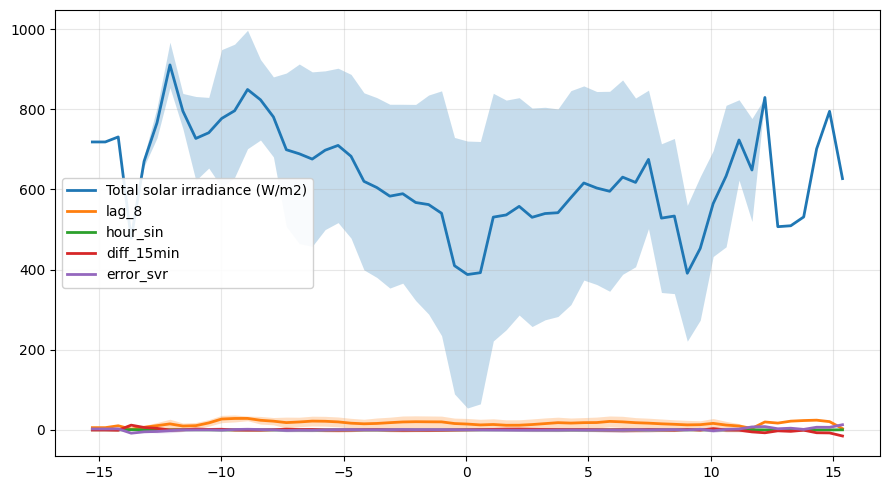

/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]
/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]
/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]
/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=Fal

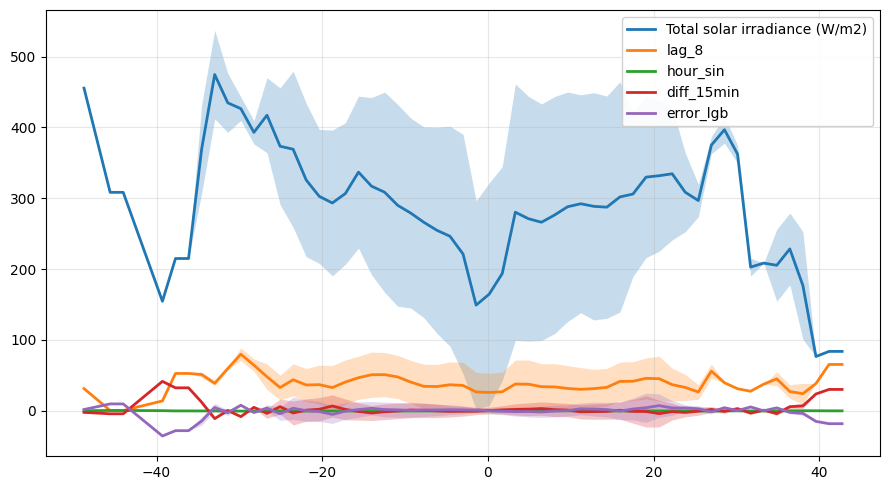

/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]
/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]
/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]
/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=Fal

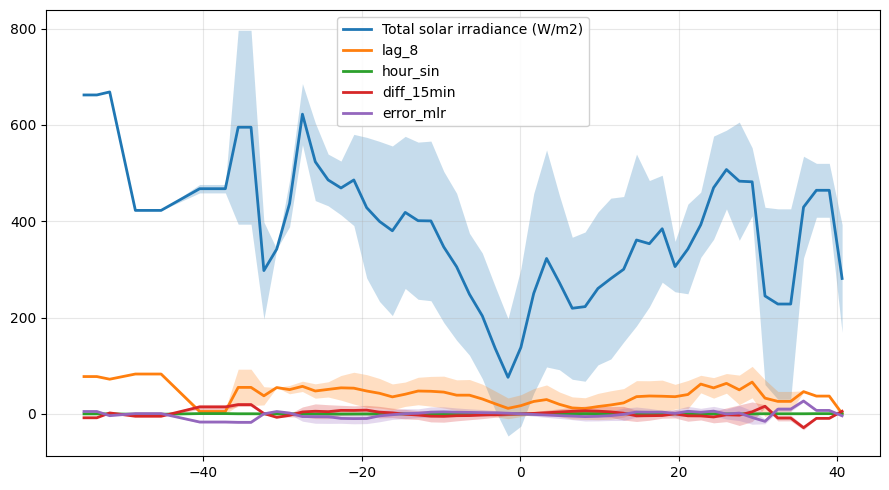

/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]
/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]
/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]
/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=Fal

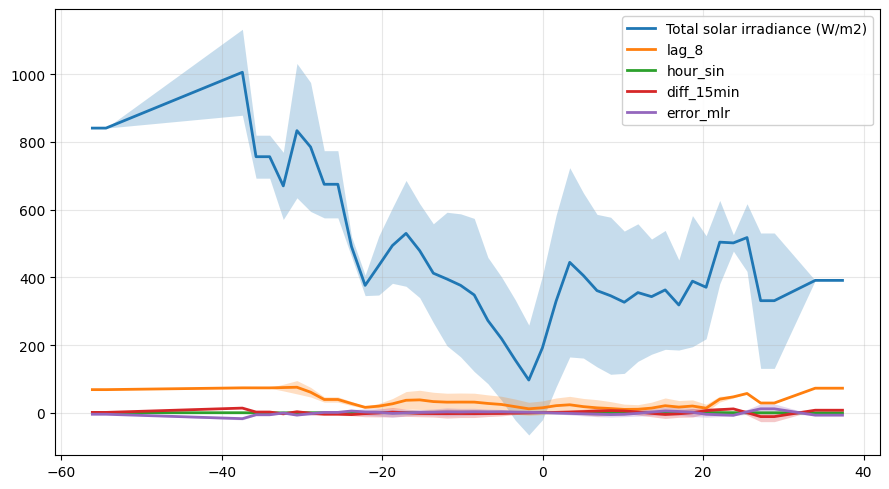

/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]
/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]
/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]
/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=Fal

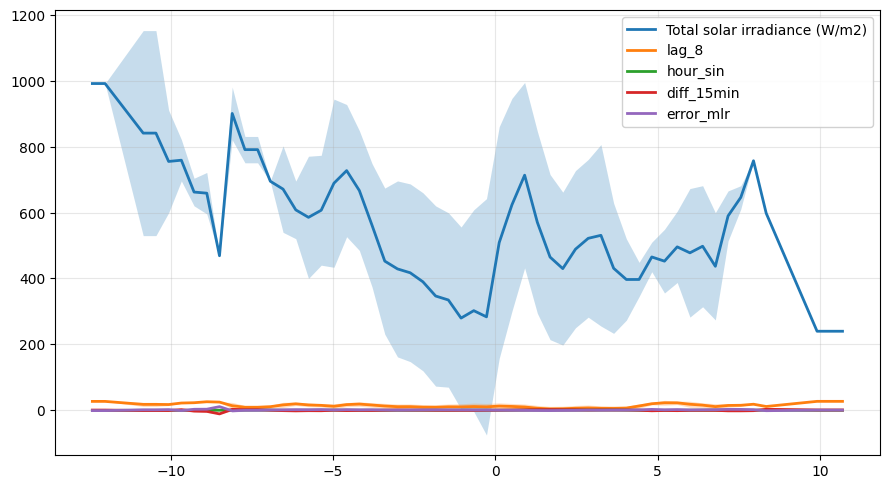

/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]
/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]
/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]
/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=Fal

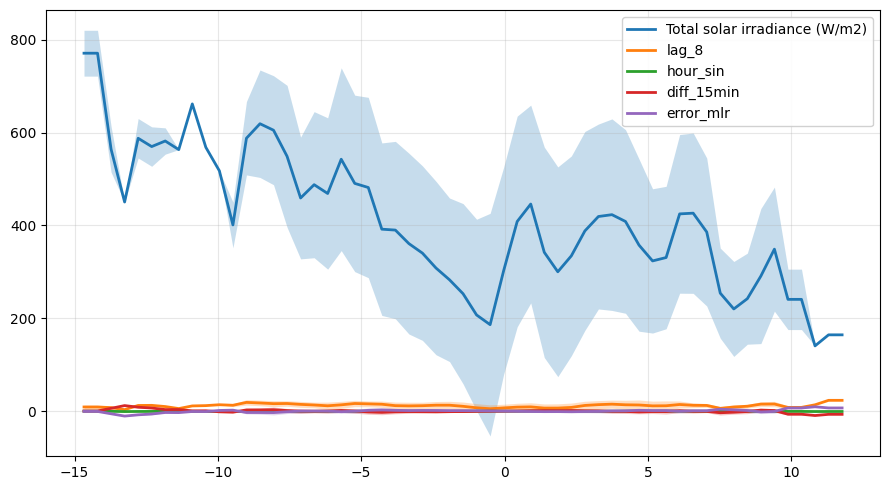

/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]
/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]
/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]
/tmp/ipython-input-4216337052.py:55: FutureWarning: The default of observed=Fal

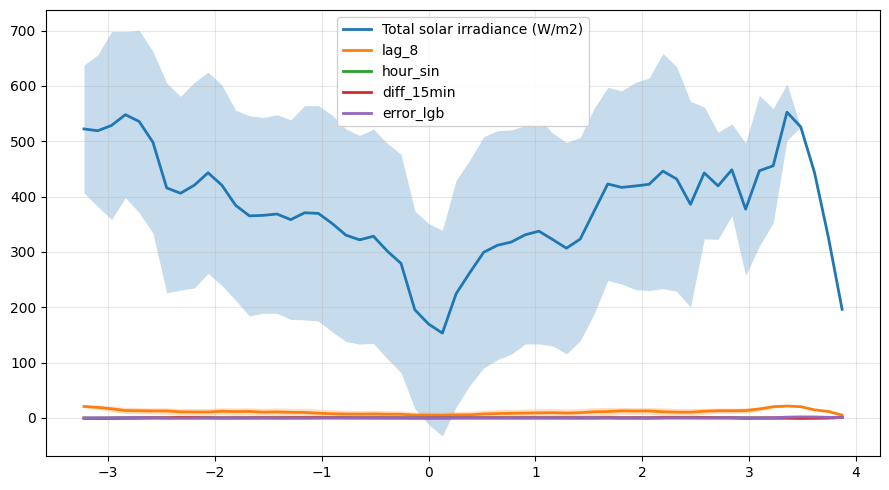

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def plot_mean_variance_band_over_c(
    df: pd.DataFrame,
    forecast_model: str,
    var_names: list,
    n_bins: int = 60,
    smooth_window: int = 3,  # 이동평균으로 살짝만 부드럽게
):
    """
    x: c = -error_{forecast_model}.shift(-1)
    y: var_names에 주어진 각 변수 컬럼
    중앙선: bin별 y의 평균
    음영: bin별 y의 분산(= var). (요청대로 '분산'을 그대로 사용)
    """

    # 1) x = c 만들기
    c = -df[f'error_{forecast_model}'].shift(-1)

    # 공통 x-bin 정의 (모든 변수에 동일 bin 사용)
    c_clean = pd.to_numeric(c, errors="coerce").replace([np.inf, -np.inf], np.nan)
    c_clean = c_clean.dropna()
    if len(c_clean) < 5:
        raise ValueError("c 데이터가 너무 적습니다.")

    # bin 경계와 bin center
    bins = np.linspace(c_clean.min(), c_clean.max(), n_bins + 1)
    bin_centers = (bins[:-1] + bins[1:]) / 2.0

    fig, ax = plt.subplots(figsize=(9, 5))

    for name in var_names:
        if name not in df.columns:
            # error_{forecast_model} 같은 포맷 대응
            if name.startswith("error_") or name.startswith("pred_error_"):
                # 이미 f-string으로 만들어졌다고 가정, 못 찾으면 스킵
                print(f"[warn] '{name}' 컬럼을 찾을 수 없습니다. 스킵합니다.")
                continue
            print(f"[warn] '{name}' 컬럼을 찾을 수 없습니다. 스킵합니다.")
            continue

        y = pd.to_numeric(df[name], errors="coerce").replace([np.inf, -np.inf], np.nan)

        # x, y 정렬 및 NaN 제거
        xy = pd.DataFrame({"c": c, "y": y}).dropna()

        if xy.empty:
            print(f"[warn] '{name}' 유효 데이터가 없습니다. 스킵합니다.")
            continue

        # 2) 같은 bin에 속한 값들로 그룹 통계(평균, 분산) 계산
        cats = pd.cut(xy["c"], bins=bins, include_lowest=True, right=False)
        grouped = xy.groupby(cats)["y"]

        y_mean = grouped.mean()
        y_std = grouped.std(ddof=0)
        y_std = y_std.reindex(pd.Categorical(cats.cat.categories, ordered=True))

        # bin이 비어 있을 수 있으므로, 전체 길이에 맞춰 재배치
        # (카테고리 순서대로 값이 있으나, 빠진 bin은 NaN)
        y_mean = y_mean.reindex(pd.Categorical(cats.cat.categories, ordered=True))
        y_std = y_std.reindex(pd.Categorical(cats.cat.categories, ordered=True))

        # 3) 간단 스무딩(이동평균) — 보기 좋게만 살짝
        if smooth_window and smooth_window > 1:
            y_mean = y_mean.rolling(smooth_window, min_periods=1, center=True).mean()
            y_std = y_std.rolling(smooth_window, min_periods=1, center=True).mean()

        # 4) 라인 + 분산 밴드 (mean ± variance) — 요청대로 'variance' 사용
        y_lower = y_mean - y_std
        y_upper = y_mean + y_std

        # 시각화를 위해 NaN 마스크 처리
        mask = ~y_mean.isna()
        x_plot = bin_centers[mask.to_numpy()]
        mean_plot = y_mean[mask].to_numpy()
        low_plot = y_lower[mask].to_numpy()
        up_plot = y_upper[mask].to_numpy()

        # 선 + 음영
        line = ax.plot(x_plot, mean_plot, label=name, linewidth=2)
        color = line[0].get_color()
        ax.fill_between(x_plot, low_plot, up_plot, alpha=0.25, linewidth=0, color=color)

    # 축/범례 설정
    ax.set_xlabel("")  # 필요하면 "c = -error.shift(-1)" 등으로 바꿔도 됨
    ax.set_ylabel("")  # 요청: y축 라벨 비우기
    ax.legend(loc="best", framealpha=0.9)
    ax.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()


# =========================
# 사용 예시 (네 루프 안에서)
# =========================
legends = ['Total solar irradiance (W/m2)','lag_8','hour_sin', 'diff_15min']
# 마지막 항목은 f'error_{forecast_model}' 이므로 루프 안에서 추가
for site_idx, site_num in enumerate([1, 2, 4, 5, 6, 7, 8]):
    df = reforecast_dfs[site_idx]
    forecast_model = best_model_combos[site_idx][0]

    var_names = legends + [f'error_{forecast_model}']  # 요청한 범례 순서 유지
    plot_mean_variance_band_over_c(
        df=df,
        forecast_model=forecast_model,
        var_names=var_names,
        n_bins=60,
        smooth_window=3
    )


/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False

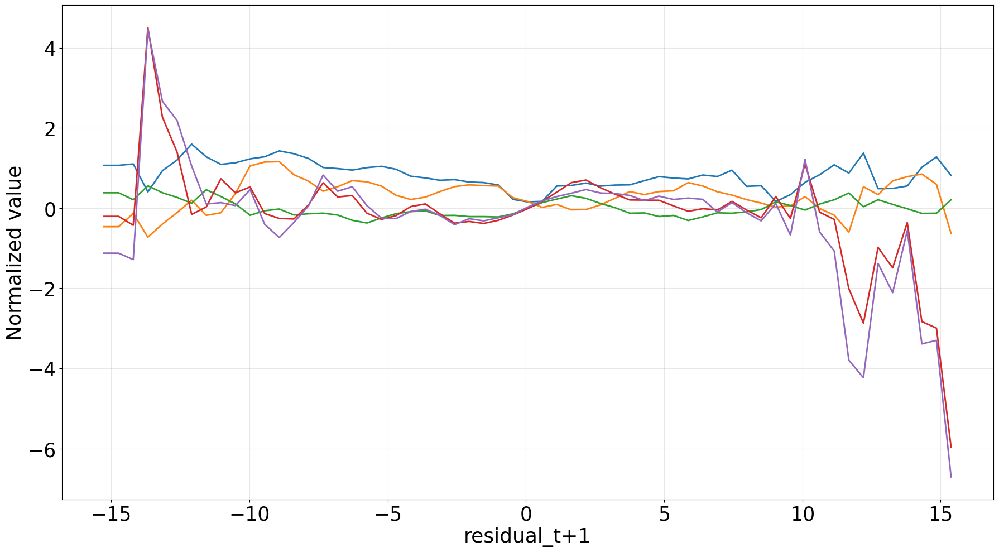

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False

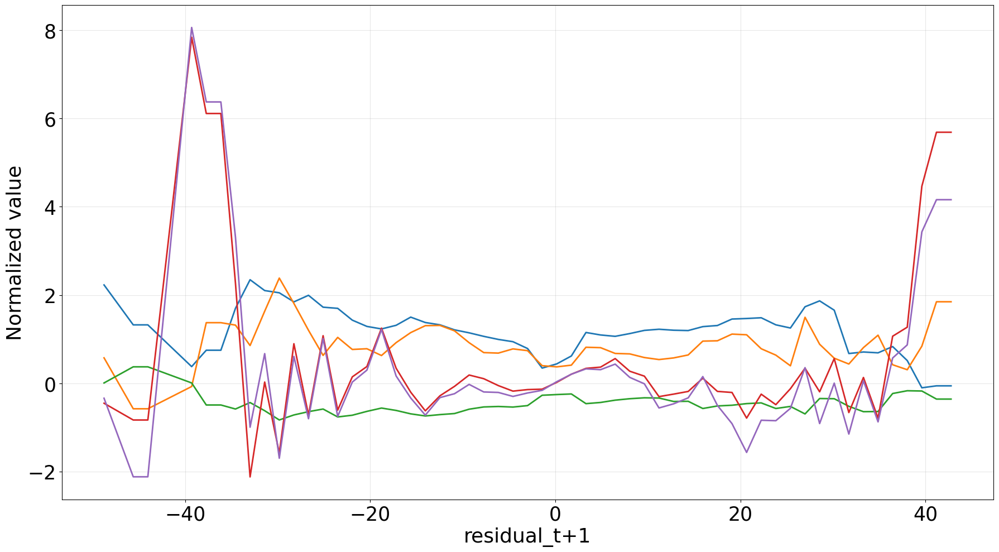

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False

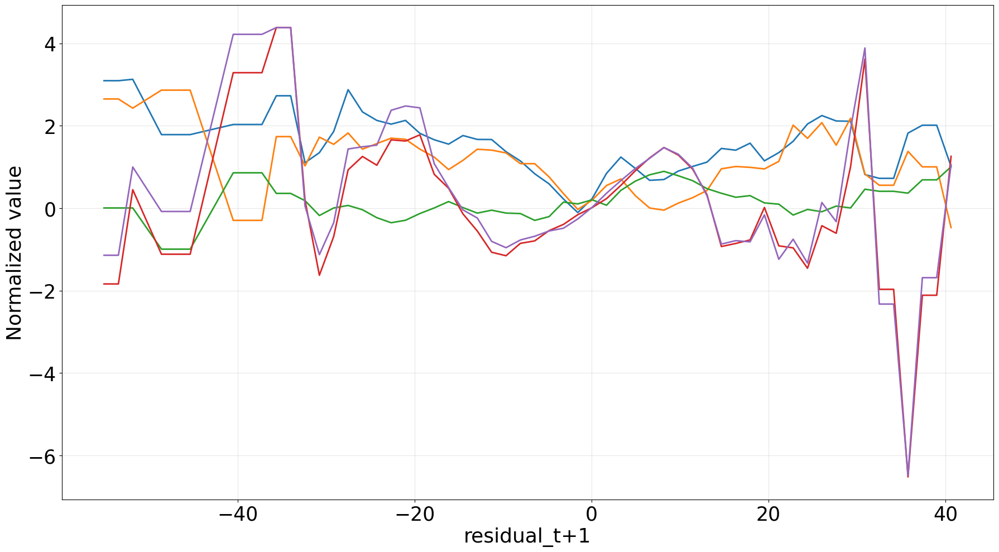

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False

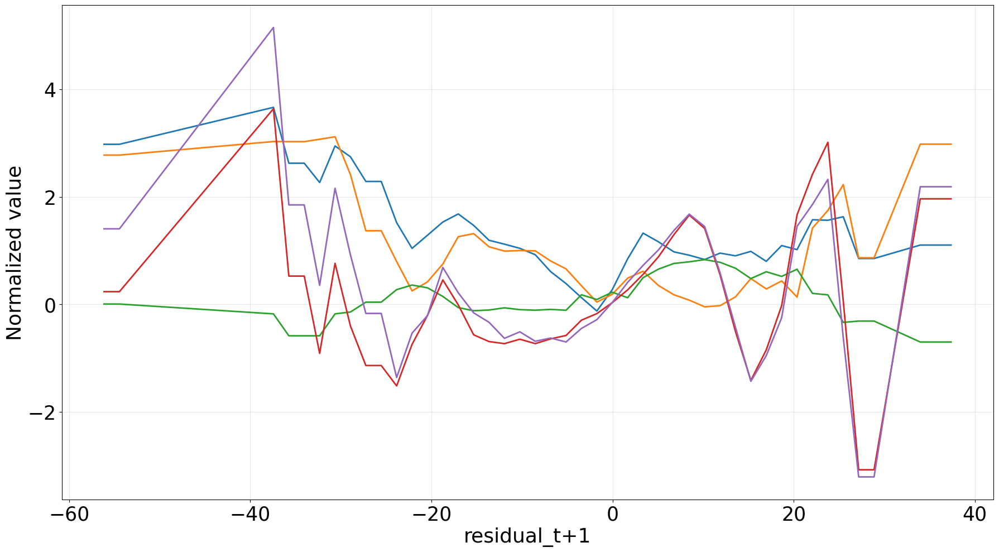

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False

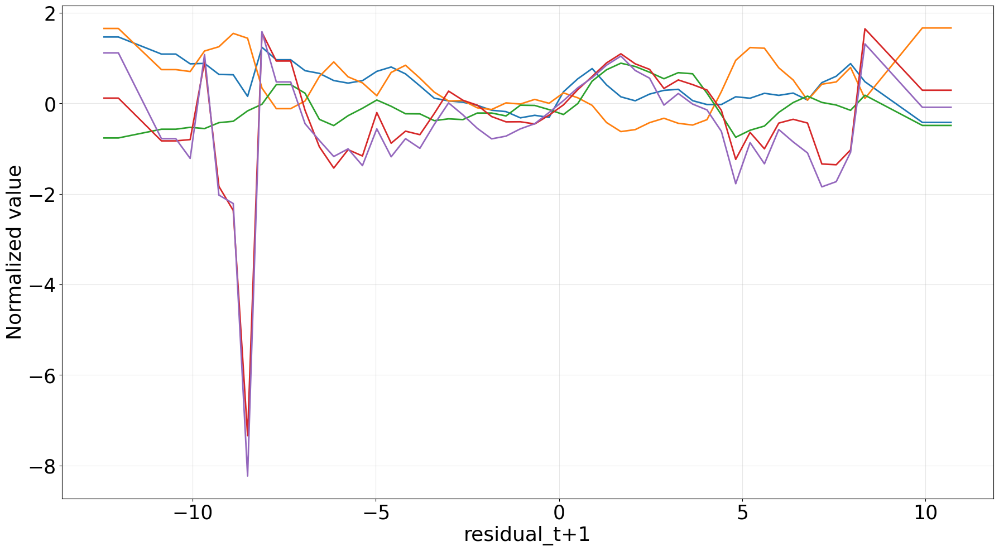

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False

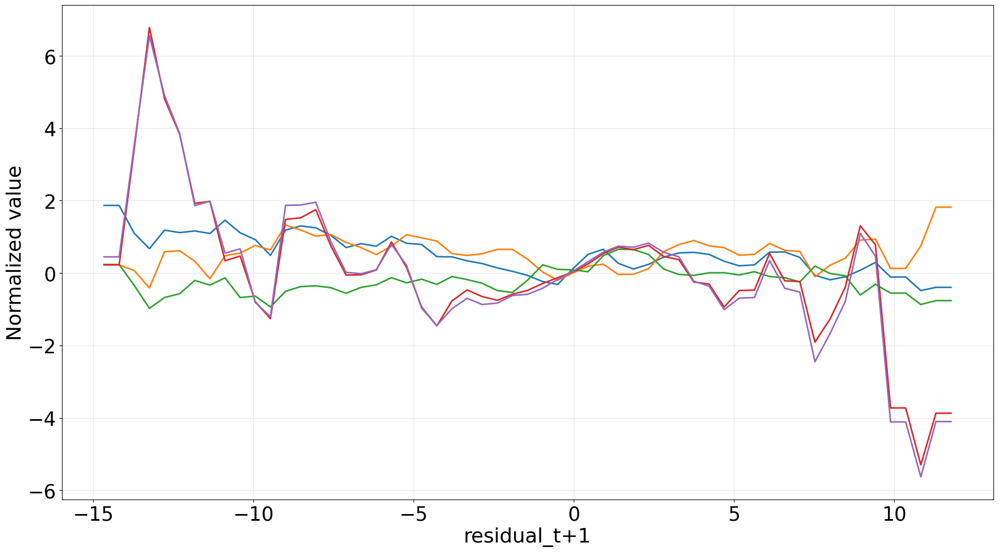

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-2931677879.py:57: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False

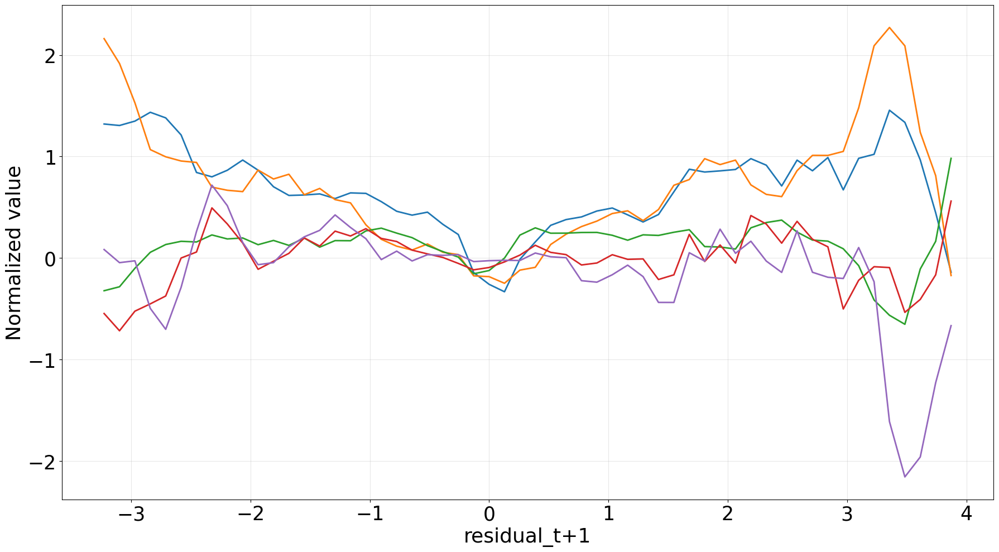

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def plot_mean_variance_band_over_c(
    df: pd.DataFrame,
    forecast_model: str,
    var_names: list,
    n_bins: int = 60,
    smooth_window: int = 3,  # 이동평균으로 살짝만 부드럽게
):
    """
    x: c = -error_{forecast_model}.shift(-1)
    y: var_names에 주어진 각 변수 컬럼
    중앙선: bin별 y의 평균
    음영: bin별 y의 표준편차 (mean ± std)
    """

    # 1) x = c 만들기
    c = -df[f'error_{forecast_model}'].shift(-1)

    # 공통 x-bin 정의 (모든 변수에 동일 bin 사용)
    c_clean = pd.to_numeric(c, errors="coerce").replace([np.inf, -np.inf], np.nan)
    c_clean = c_clean.dropna()
    if len(c_clean) < 5:
        raise ValueError("c 데이터가 너무 적습니다.")

    # bin 경계와 bin center
    bins = np.linspace(c_clean.min(), c_clean.max(), n_bins + 1)
    bin_centers = (bins[:-1] + bins[1:]) / 2.0

    fig, ax = plt.subplots(figsize=(18,10))

    for name in var_names:
        if name not in df.columns:
            if name.startswith("error_") or name.startswith("pred_error_"):
                print(f"[warn] '{name}' 컬럼을 찾을 수 없습니다. 스킵합니다.")
                continue
            print(f"[warn] '{name}' 컬럼을 찾을 수 없습니다. 스킵합니다.")
            continue

        y = pd.to_numeric(df[name], errors="coerce").replace([np.inf, -np.inf], np.nan)
        if name == f'error_{forecast_model}':
            y = -y

        xy = pd.DataFrame({"c": c, "y": y}).dropna()
        if xy.empty:
            print(f"[warn] '{name}' 유효 데이터가 없습니다. 스킵합니다.")
            continue

        mu = xy["y"].mean()
        sd = xy["y"].std(ddof=0)
        if sd > 0:
            xy["y"] = (xy["y"] - mu) / sd

        cats = pd.cut(xy["c"], bins=bins, include_lowest=True, right=False)
        grouped = xy.groupby(cats)["y"]

        y_mean = grouped.mean()
        y_std = grouped.std(ddof=0)

        y_mean = y_mean.reindex(pd.Categorical(cats.cat.categories, ordered=True))
        y_std = y_std.reindex(pd.Categorical(cats.cat.categories, ordered=True))

        if smooth_window and smooth_window > 1:
            y_mean = y_mean.rolling(smooth_window, min_periods=1, center=True).mean()
            y_std = y_std.rolling(smooth_window, min_periods=1, center=True).mean()

        y_lower = y_mean - y_std
        y_upper = y_mean + y_std

        mask = ~y_mean.isna()
        x_plot = bin_centers[mask.to_numpy()]
        mean_plot = y_mean[mask].to_numpy()
        low_plot = y_lower[mask].to_numpy()
        up_plot = y_upper[mask].to_numpy()

        line = ax.plot(x_plot, mean_plot, label=name, linewidth=2)
        color = line[0].get_color()
        # ax.fill_between(x_plot, low_plot, up_plot, alpha=0.25, linewidth=0, color=color)

    # ✅ 축 라벨만 수정

    ax.tick_params(axis='both', labelsize=25)
    ax.set_xlabel("residual_t+1", fontsize=26)
    ax.set_ylabel("Normalized value", fontsize=26)
    ax.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()


# =========================
# 사용 예시 (그대로 유지)
# =========================
legends = ['Total solar irradiance (W/m2)','lag_8','hour_sin', 'diff_15min']
for site_idx, site_num in enumerate([1, 2, 4, 5, 6, 7, 8]):
    df = reforecast_dfs[site_idx]
    forecast_model = best_model_combos[site_idx][0]

    var_names = legends + [f'error_{forecast_model}']
    plot_mean_variance_band_over_c(
        df=df,
        forecast_model=forecast_model,
        var_names=var_names,
        n_bins=60,
        smooth_window=3
    )


/tmp/ipython-input-2406375137.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


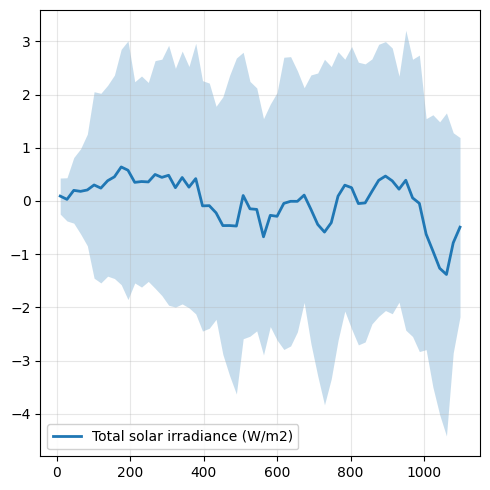

/tmp/ipython-input-2406375137.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


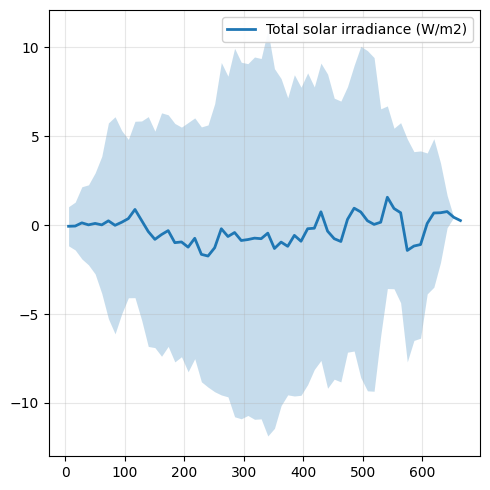

/tmp/ipython-input-2406375137.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


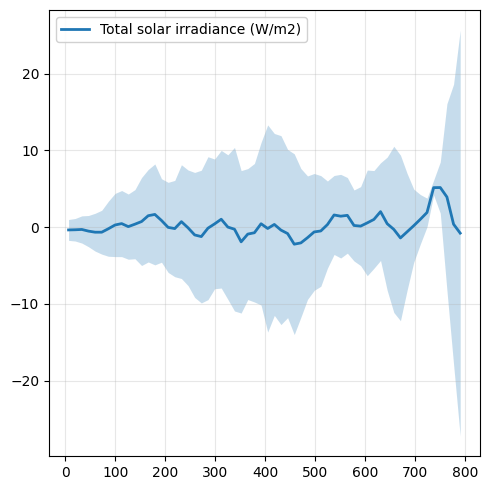

/tmp/ipython-input-2406375137.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


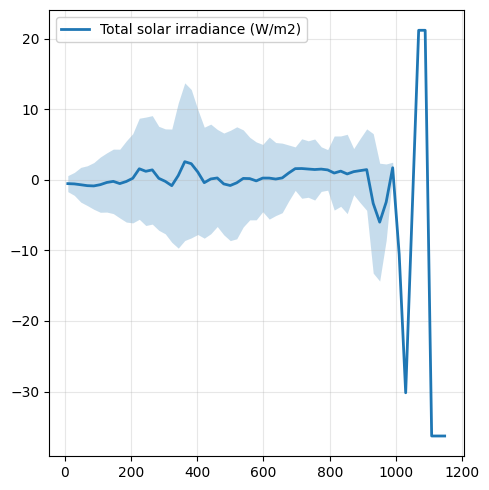

/tmp/ipython-input-2406375137.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


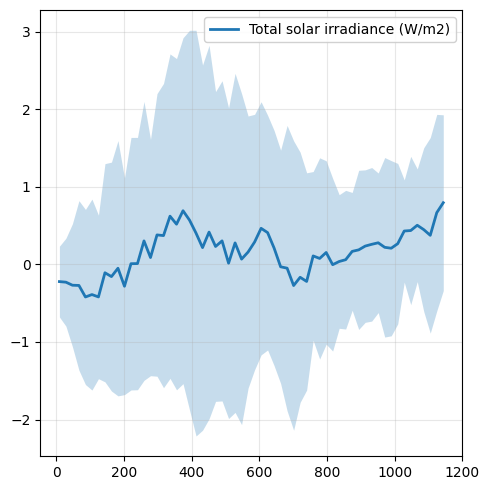

/tmp/ipython-input-2406375137.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


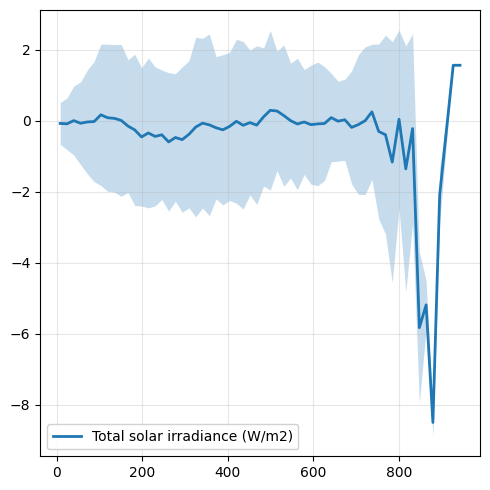

/tmp/ipython-input-2406375137.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


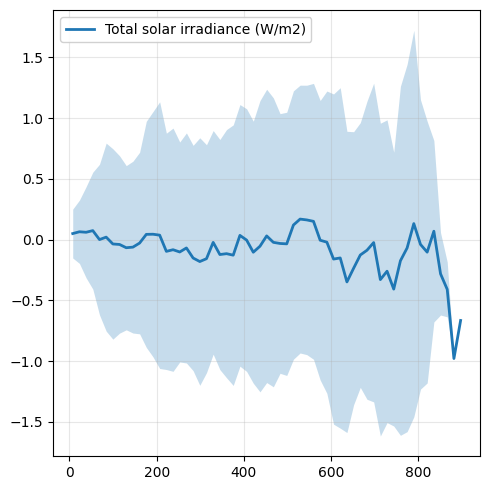

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def plot_mean_variance_band_over_c(
    df: pd.DataFrame,
    forecast_model: str,
    var_names: list,
    n_bins: int = 60,
    smooth_window: int = 3,
):
    """
    x: var_names에 주어진 각 변수 컬럼
    y: c = -error_{forecast_model}.shift(-1)
    중앙선: bin별 c의 평균
    음영: bin별 c의 표준편차 (mean ± std)
    """

    # 1) y = c 만들기 (이제 y축 값)
    c = -df[f'error_{forecast_model}'].shift(-1)

    fig, ax = plt.subplots(figsize=(5, 5))

    for name in var_names:
        if name not in df.columns:
            print(f"[warn] '{name}' 컬럼을 찾을 수 없습니다. 스킵합니다.")
            continue

        # x: 변수값, y: 오차(c)
        x = pd.to_numeric(df[name], errors="coerce").replace([np.inf, -np.inf], np.nan)
        y = pd.to_numeric(c, errors="coerce").replace([np.inf, -np.inf], np.nan)

        xy = pd.DataFrame({"x": x, "y": y}).dropna()
        if xy.empty:
            print(f"[warn] '{name}' 유효 데이터가 없습니다. 스킵합니다.")
            continue

        # 2) x 구간(bin)별로 y 통계 계산
        x_clean = xy["x"].dropna()
        if len(x_clean) < 5:
            continue
        bins = np.linspace(x_clean.min(), x_clean.max(), n_bins + 1)
        bin_centers = (bins[:-1] + bins[1:]) / 2.0

        cats = pd.cut(xy["x"], bins=bins, include_lowest=True, right=False)
        grouped = xy.groupby(cats)["y"]

        y_mean = grouped.mean()
        y_std = grouped.std(ddof=0)

        y_mean = y_mean.reindex(pd.Categorical(cats.cat.categories, ordered=True))
        y_std = y_std.reindex(pd.Categorical(cats.cat.categories, ordered=True))

        # 3) 스무딩
        if smooth_window and smooth_window > 1:
            y_mean = y_mean.rolling(smooth_window, min_periods=1, center=True).mean()
            y_std = y_std.rolling(smooth_window, min_periods=1, center=True).mean()

        # 4) 밴드 (mean ± std)
        y_lower = y_mean - y_std
        y_upper = y_mean + y_std

        mask = ~y_mean.isna()
        x_plot = bin_centers[mask.to_numpy()]
        mean_plot = y_mean[mask].to_numpy()
        low_plot = y_lower[mask].to_numpy()
        up_plot = y_upper[mask].to_numpy()

        line = ax.plot(x_plot, mean_plot, label=name, linewidth=2)
        color = line[0].get_color()
        ax.fill_between(x_plot, low_plot, up_plot, alpha=0.25, linewidth=0, color=color)

    ax.set_xlabel("")  # x축: 변수
    ax.set_ylabel("")  # y축: -error.shift(-1)
    ax.legend(loc="best", framealpha=0.9)
    ax.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()


# =========================
# 사용 예시
# =========================
legends = ['Total solar irradiance (W/m2)']
for site_idx, site_num in enumerate([1, 2, 4, 5, 6, 7, 8]):
    df = reforecast_dfs[site_idx]
    forecast_model = best_model_combos[site_idx][0]

    var_names = legends
    plot_mean_variance_band_over_c(
        df=df,
        forecast_model=forecast_model,
        var_names=var_names,
        n_bins=60,
        smooth_window=3
    )


/tmp/ipython-input-1668984247.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


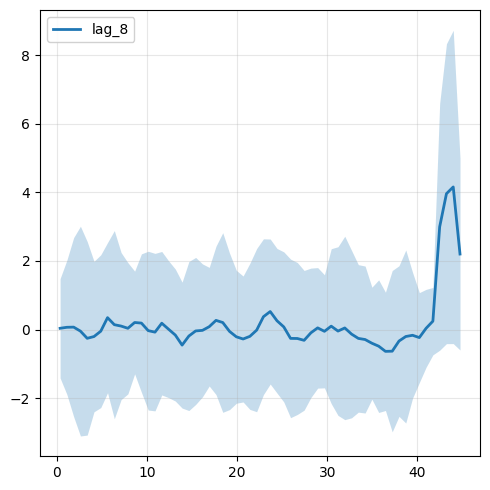

/tmp/ipython-input-1668984247.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


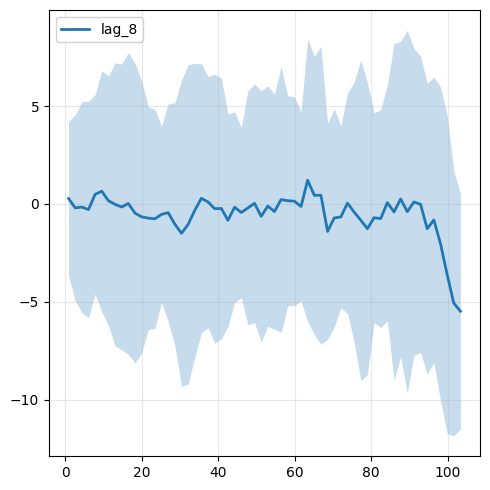

/tmp/ipython-input-1668984247.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


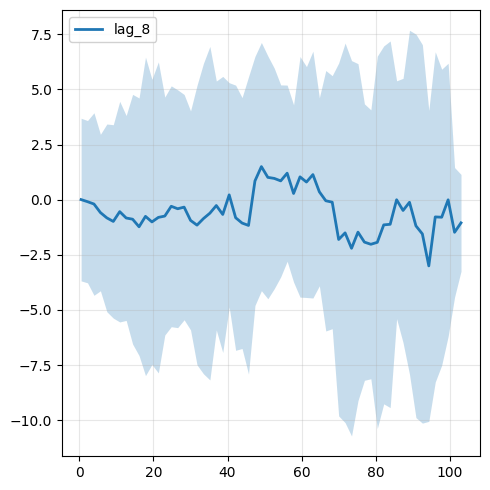

/tmp/ipython-input-1668984247.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


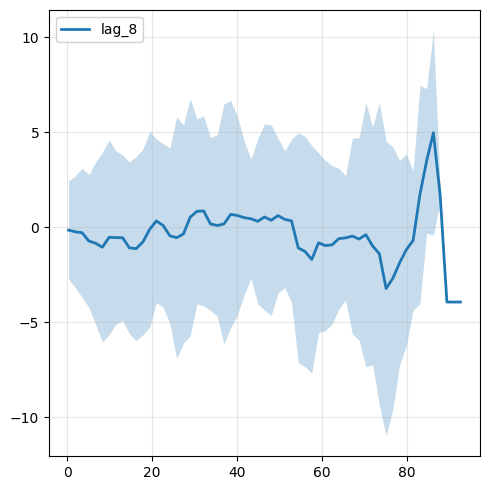

/tmp/ipython-input-1668984247.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


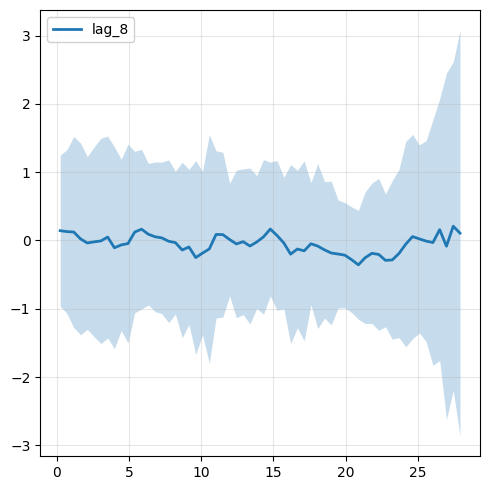

/tmp/ipython-input-1668984247.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


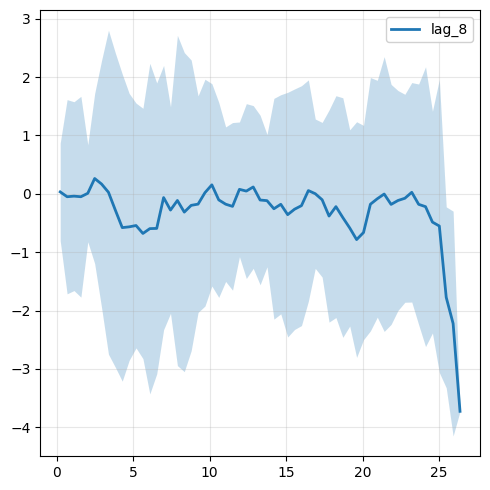

/tmp/ipython-input-1668984247.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


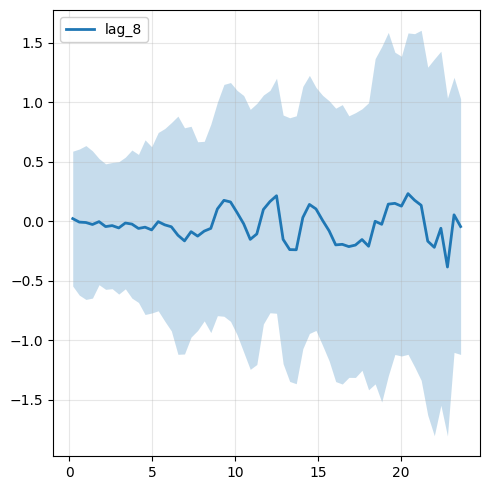

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def plot_mean_variance_band_over_c(
    df: pd.DataFrame,
    forecast_model: str,
    var_names: list,
    n_bins: int = 60,
    smooth_window: int = 3,
):
    """
    x: var_names에 주어진 각 변수 컬럼
    y: c = -error_{forecast_model}.shift(-1)
    중앙선: bin별 c의 평균
    음영: bin별 c의 표준편차 (mean ± std)
    """

    # 1) y = c 만들기 (이제 y축 값)
    c = -df[f'error_{forecast_model}'].shift(-1)

    fig, ax = plt.subplots(figsize=(5, 5))

    for name in var_names:
        if name not in df.columns:
            print(f"[warn] '{name}' 컬럼을 찾을 수 없습니다. 스킵합니다.")
            continue

        # x: 변수값, y: 오차(c)
        x = pd.to_numeric(df[name], errors="coerce").replace([np.inf, -np.inf], np.nan)
        y = pd.to_numeric(c, errors="coerce").replace([np.inf, -np.inf], np.nan)

        xy = pd.DataFrame({"x": x, "y": y}).dropna()
        if xy.empty:
            print(f"[warn] '{name}' 유효 데이터가 없습니다. 스킵합니다.")
            continue

        # 2) x 구간(bin)별로 y 통계 계산
        x_clean = xy["x"].dropna()
        if len(x_clean) < 5:
            continue
        bins = np.linspace(x_clean.min(), x_clean.max(), n_bins + 1)
        bin_centers = (bins[:-1] + bins[1:]) / 2.0

        cats = pd.cut(xy["x"], bins=bins, include_lowest=True, right=False)
        grouped = xy.groupby(cats)["y"]

        y_mean = grouped.mean()
        y_std = grouped.std(ddof=0)

        y_mean = y_mean.reindex(pd.Categorical(cats.cat.categories, ordered=True))
        y_std = y_std.reindex(pd.Categorical(cats.cat.categories, ordered=True))

        # 3) 스무딩
        if smooth_window and smooth_window > 1:
            y_mean = y_mean.rolling(smooth_window, min_periods=1, center=True).mean()
            y_std = y_std.rolling(smooth_window, min_periods=1, center=True).mean()

        # 4) 밴드 (mean ± std)
        y_lower = y_mean - y_std
        y_upper = y_mean + y_std

        mask = ~y_mean.isna()
        x_plot = bin_centers[mask.to_numpy()]
        mean_plot = y_mean[mask].to_numpy()
        low_plot = y_lower[mask].to_numpy()
        up_plot = y_upper[mask].to_numpy()

        line = ax.plot(x_plot, mean_plot, label=name, linewidth=2)
        color = line[0].get_color()
        ax.fill_between(x_plot, low_plot, up_plot, alpha=0.25, linewidth=0, color=color)

    ax.set_xlabel("")  # x축: 변수
    ax.set_ylabel("")  # y축: -error.shift(-1)
    ax.legend(loc="best", framealpha=0.9)
    ax.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()


# =========================
# 사용 예시
# =========================
legends = [ 'lag_8']
for site_idx, site_num in enumerate([1, 2, 4, 5, 6, 7, 8]):
    df = reforecast_dfs[site_idx]
    forecast_model = best_model_combos[site_idx][0]

    var_names = legends
    plot_mean_variance_band_over_c(
        df=df,
        forecast_model=forecast_model,
        var_names=var_names,
        n_bins=60,
        smooth_window=3
    )


/tmp/ipython-input-2647820524.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


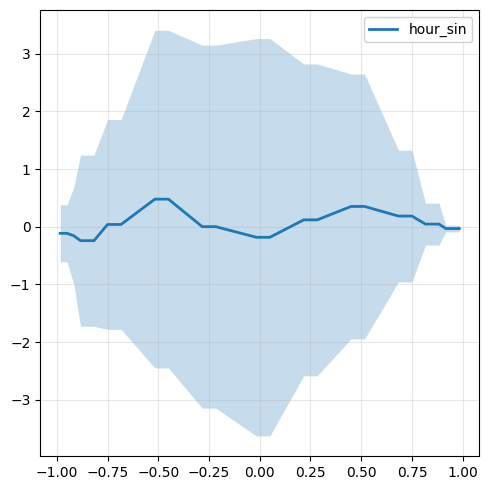

/tmp/ipython-input-2647820524.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


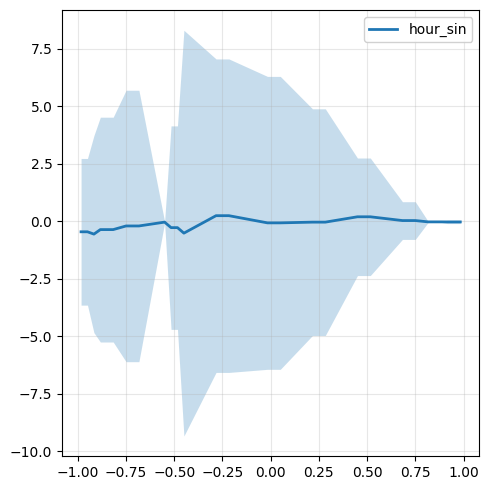

/tmp/ipython-input-2647820524.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


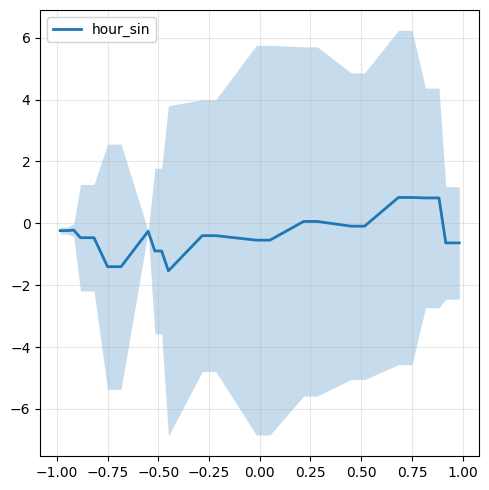

/tmp/ipython-input-2647820524.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


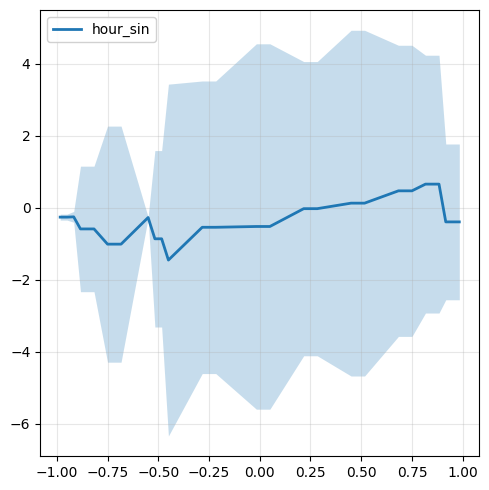

/tmp/ipython-input-2647820524.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


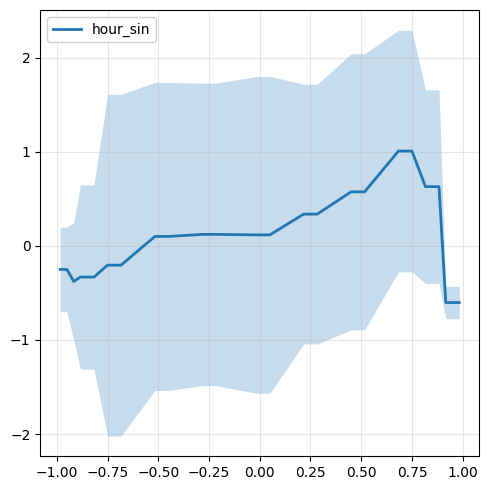

/tmp/ipython-input-2647820524.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


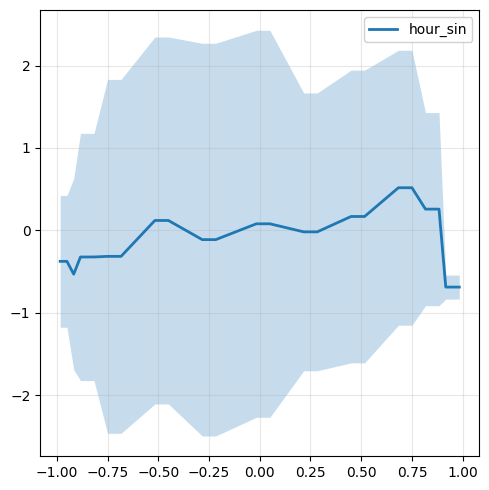

/tmp/ipython-input-2647820524.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


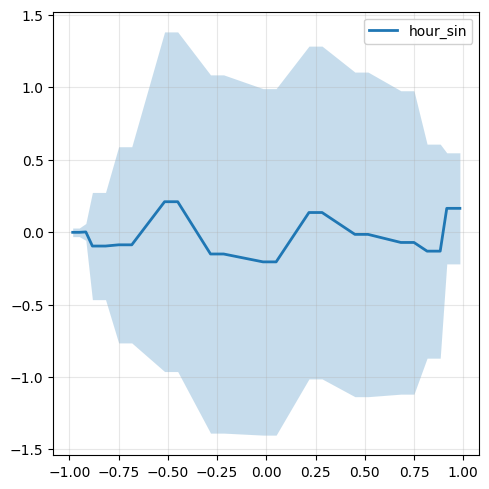

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def plot_mean_variance_band_over_c(
    df: pd.DataFrame,
    forecast_model: str,
    var_names: list,
    n_bins: int = 60,
    smooth_window: int = 3,
):
    """
    x: var_names에 주어진 각 변수 컬럼
    y: c = -error_{forecast_model}.shift(-1)
    중앙선: bin별 c의 평균
    음영: bin별 c의 표준편차 (mean ± std)
    """

    # 1) y = c 만들기 (이제 y축 값)
    c = -df[f'error_{forecast_model}'].shift(-1)

    fig, ax = plt.subplots(figsize=(5, 5))

    for name in var_names:
        if name not in df.columns:
            print(f"[warn] '{name}' 컬럼을 찾을 수 없습니다. 스킵합니다.")
            continue

        # x: 변수값, y: 오차(c)
        x = pd.to_numeric(df[name], errors="coerce").replace([np.inf, -np.inf], np.nan)
        y = pd.to_numeric(c, errors="coerce").replace([np.inf, -np.inf], np.nan)

        xy = pd.DataFrame({"x": x, "y": y}).dropna()
        if xy.empty:
            print(f"[warn] '{name}' 유효 데이터가 없습니다. 스킵합니다.")
            continue

        # 2) x 구간(bin)별로 y 통계 계산
        x_clean = xy["x"].dropna()
        if len(x_clean) < 5:
            continue
        bins = np.linspace(x_clean.min(), x_clean.max(), n_bins + 1)
        bin_centers = (bins[:-1] + bins[1:]) / 2.0

        cats = pd.cut(xy["x"], bins=bins, include_lowest=True, right=False)
        grouped = xy.groupby(cats)["y"]

        y_mean = grouped.mean()
        y_std = grouped.std(ddof=0)

        y_mean = y_mean.reindex(pd.Categorical(cats.cat.categories, ordered=True))
        y_std = y_std.reindex(pd.Categorical(cats.cat.categories, ordered=True))

        # 3) 스무딩
        if smooth_window and smooth_window > 1:
            y_mean = y_mean.rolling(smooth_window, min_periods=1, center=True).mean()
            y_std = y_std.rolling(smooth_window, min_periods=1, center=True).mean()

        # 4) 밴드 (mean ± std)
        y_lower = y_mean - y_std
        y_upper = y_mean + y_std

        mask = ~y_mean.isna()
        x_plot = bin_centers[mask.to_numpy()]
        mean_plot = y_mean[mask].to_numpy()
        low_plot = y_lower[mask].to_numpy()
        up_plot = y_upper[mask].to_numpy()

        line = ax.plot(x_plot, mean_plot, label=name, linewidth=2)
        color = line[0].get_color()
        ax.fill_between(x_plot, low_plot, up_plot, alpha=0.25, linewidth=0, color=color)

    ax.set_xlabel("")  # x축: 변수
    ax.set_ylabel("")  # y축: -error.shift(-1)
    ax.legend(loc="best", framealpha=0.9)
    ax.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()


# =========================
# 사용 예시
# =========================
legends = [ 'hour_sin']
for site_idx, site_num in enumerate([1, 2, 4, 5, 6, 7, 8]):
    df = reforecast_dfs[site_idx]
    forecast_model = best_model_combos[site_idx][0]

    var_names = legends
    plot_mean_variance_band_over_c(
        df=df,
        forecast_model=forecast_model,
        var_names=var_names,
        n_bins=60,
        smooth_window=3
    )


/tmp/ipython-input-109174448.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


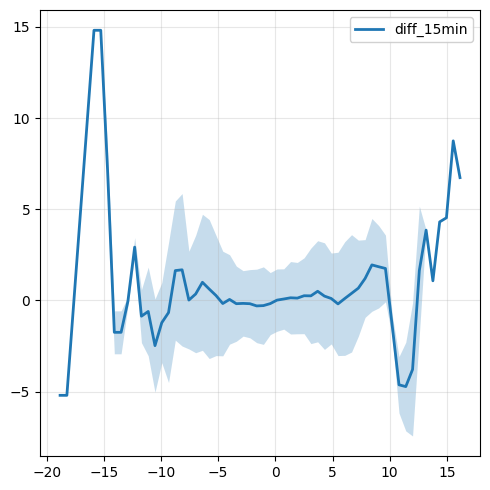

/tmp/ipython-input-109174448.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


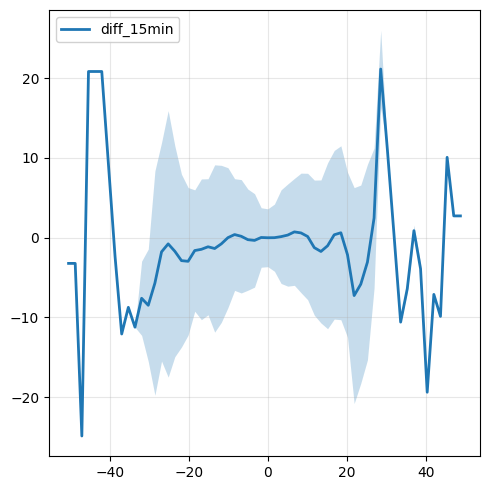

/tmp/ipython-input-109174448.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


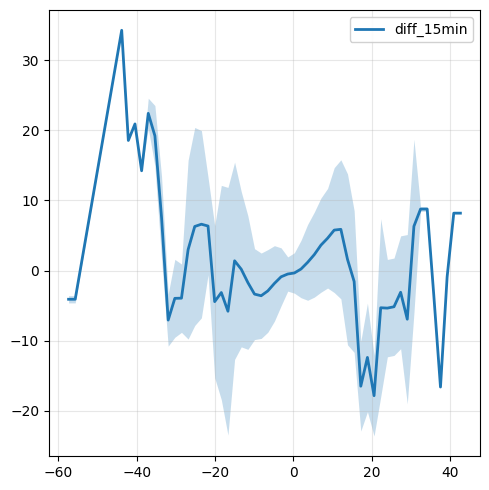

/tmp/ipython-input-109174448.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


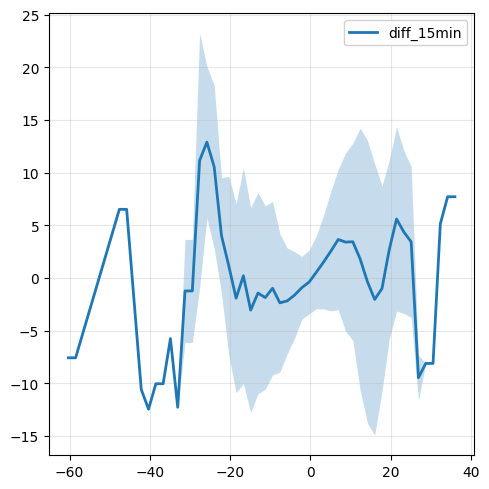

/tmp/ipython-input-109174448.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


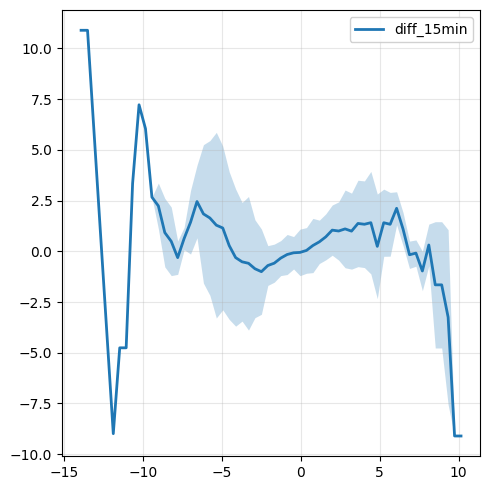

/tmp/ipython-input-109174448.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


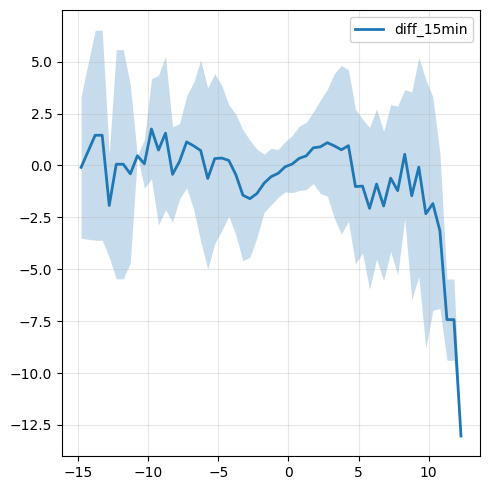

/tmp/ipython-input-109174448.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = xy.groupby(cats)["y"]


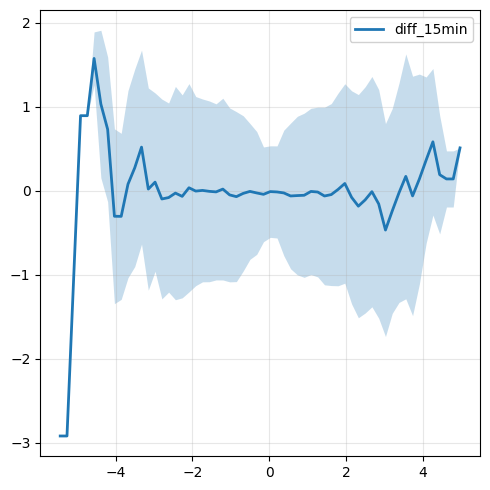

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def plot_mean_variance_band_over_c(
    df: pd.DataFrame,
    forecast_model: str,
    var_names: list,
    n_bins: int = 60,
    smooth_window: int = 3,
):
    """
    x: var_names에 주어진 각 변수 컬럼
    y: c = -error_{forecast_model}.shift(-1)
    중앙선: bin별 c의 평균
    음영: bin별 c의 표준편차 (mean ± std)
    """

    # 1) y = c 만들기 (이제 y축 값)
    c = -df[f'error_{forecast_model}'].shift(-1)

    fig, ax = plt.subplots(figsize=(5, 5))

    for name in var_names:
        if name not in df.columns:
            print(f"[warn] '{name}' 컬럼을 찾을 수 없습니다. 스킵합니다.")
            continue

        # x: 변수값, y: 오차(c)
        x = pd.to_numeric(df[name], errors="coerce").replace([np.inf, -np.inf], np.nan)
        y = pd.to_numeric(c, errors="coerce").replace([np.inf, -np.inf], np.nan)

        xy = pd.DataFrame({"x": x, "y": y}).dropna()
        if xy.empty:
            print(f"[warn] '{name}' 유효 데이터가 없습니다. 스킵합니다.")
            continue

        # 2) x 구간(bin)별로 y 통계 계산
        x_clean = xy["x"].dropna()
        if len(x_clean) < 5:
            continue
        bins = np.linspace(x_clean.min(), x_clean.max(), n_bins + 1)
        bin_centers = (bins[:-1] + bins[1:]) / 2.0

        cats = pd.cut(xy["x"], bins=bins, include_lowest=True, right=False)
        grouped = xy.groupby(cats)["y"]

        y_mean = grouped.mean()
        y_std = grouped.std(ddof=0)

        y_mean = y_mean.reindex(pd.Categorical(cats.cat.categories, ordered=True))
        y_std = y_std.reindex(pd.Categorical(cats.cat.categories, ordered=True))

        # 3) 스무딩
        if smooth_window and smooth_window > 1:
            y_mean = y_mean.rolling(smooth_window, min_periods=1, center=True).mean()
            y_std = y_std.rolling(smooth_window, min_periods=1, center=True).mean()

        # 4) 밴드 (mean ± std)
        y_lower = y_mean - y_std
        y_upper = y_mean + y_std

        mask = ~y_mean.isna()
        x_plot = bin_centers[mask.to_numpy()]
        mean_plot = y_mean[mask].to_numpy()
        low_plot = y_lower[mask].to_numpy()
        up_plot = y_upper[mask].to_numpy()

        line = ax.plot(x_plot, mean_plot, label=name, linewidth=2)
        color = line[0].get_color()
        ax.fill_between(x_plot, low_plot, up_plot, alpha=0.25, linewidth=0, color=color)

    ax.set_xlabel("")  # x축: 변수
    ax.set_ylabel("")  # y축: -error.shift(-1)
    ax.legend(loc="best", framealpha=0.9)
    ax.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()


# =========================
# 사용 예시
# =========================
legends = [ 'diff_15min']
for site_idx, site_num in enumerate([1, 2, 4, 5, 6, 7, 8]):
    df = reforecast_dfs[site_idx]
    forecast_model = best_model_combos[site_idx][0]

    var_names = legends
    plot_mean_variance_band_over_c(
        df=df,
        forecast_model=forecast_model,
        var_names=var_names,
        n_bins=60,
        smooth_window=3
    )


/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False

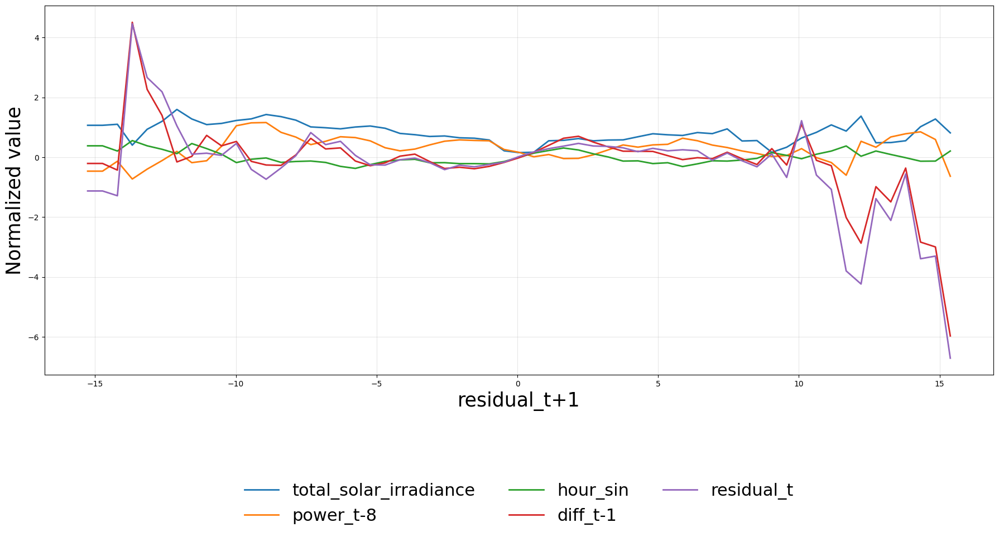

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False

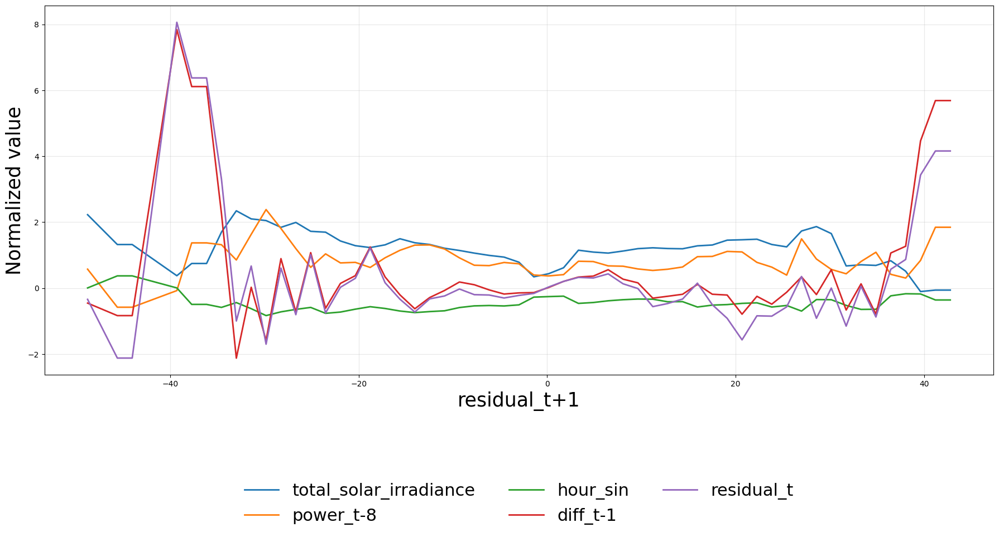

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False

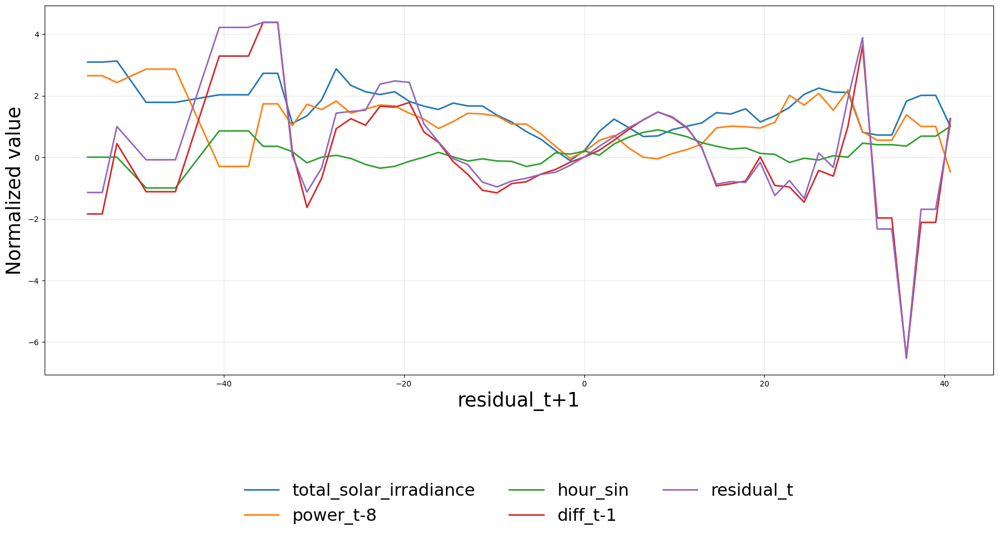

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False

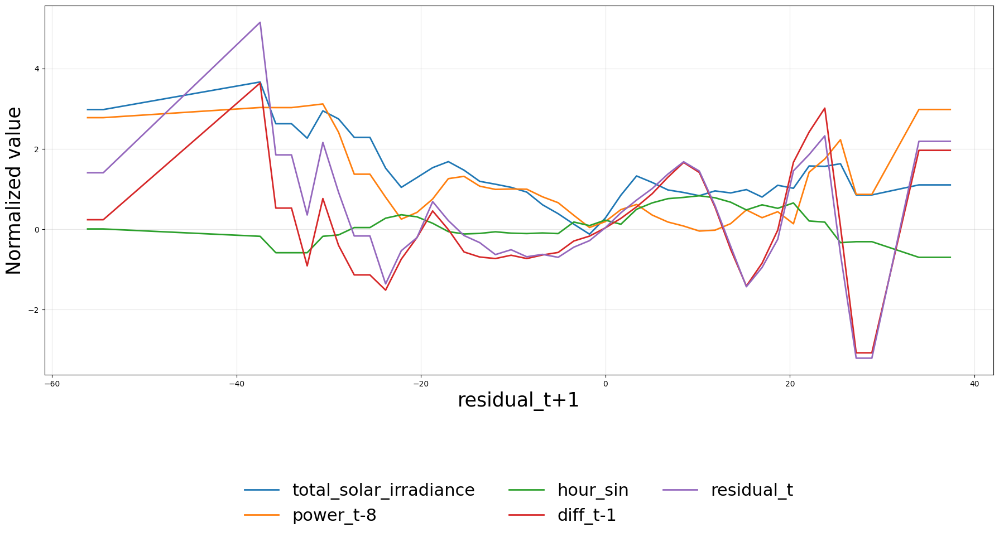

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False

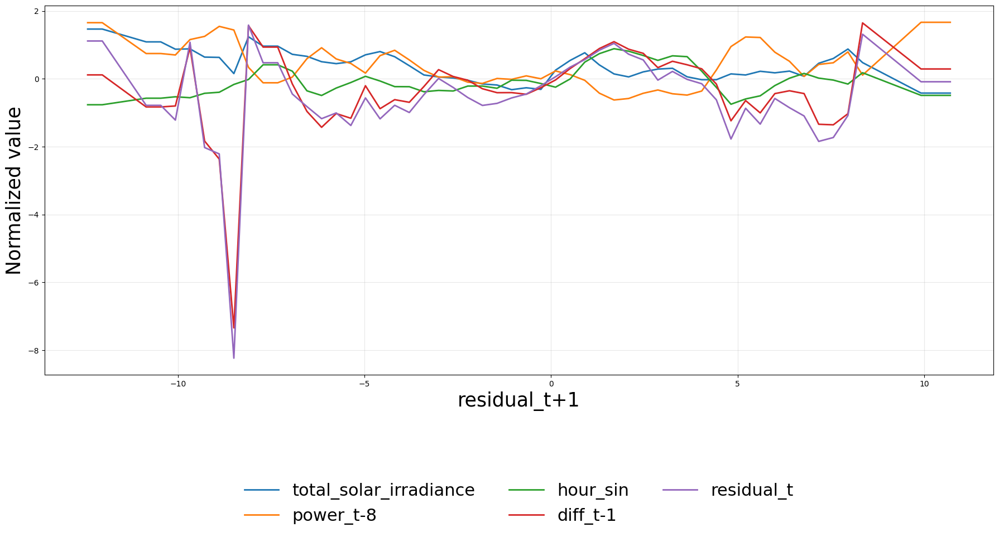

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False

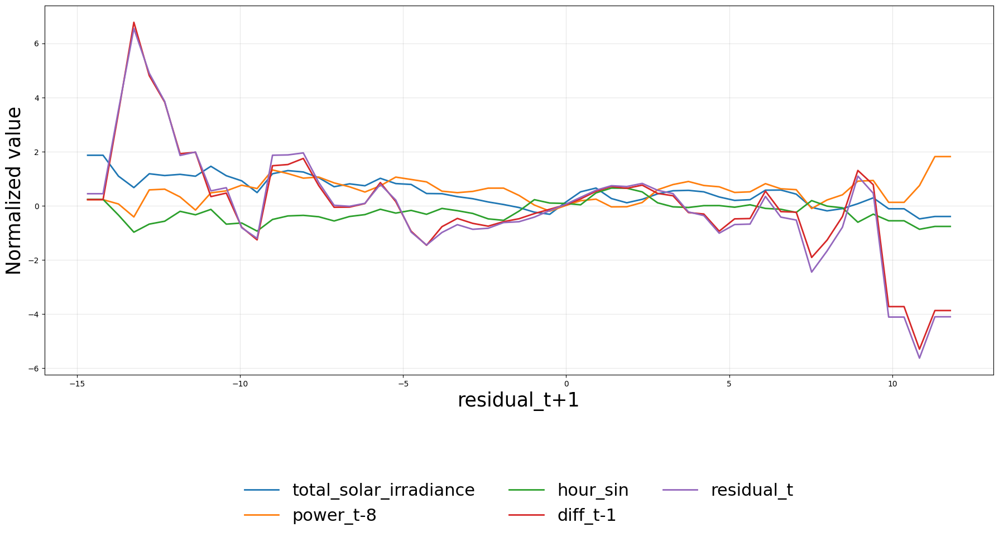

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-1800091795.py:52: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False

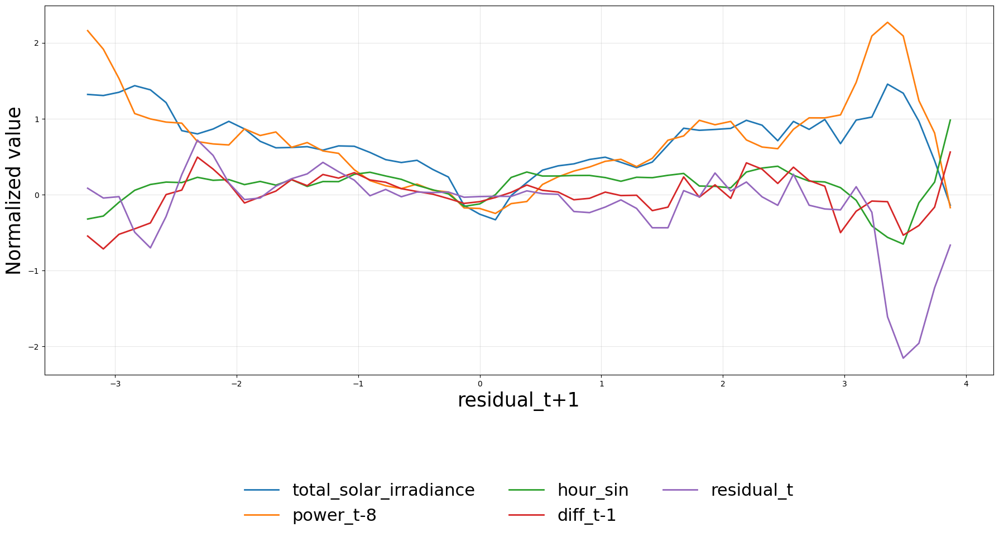

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def plot_mean_variance_band_over_c(
    df: pd.DataFrame,
    forecast_model: str,
    var_names: list,
    legend_labels: list,  # ✅ 새로 추가 (범례 이름 지정)
    n_bins: int = 60,
    smooth_window: int = 3,
):
    """
    x: c = -error_{forecast_model}.shift(-1)
    y: var_names에 주어진 각 변수 컬럼
    중앙선: bin별 y의 평균
    음영: bin별 y의 표준편차 (mean ± std)
    """

    # 1) x = c 만들기
    c = -df[f'error_{forecast_model}'].shift(-1)

    c_clean = pd.to_numeric(c, errors="coerce").replace([np.inf, -np.inf], np.nan).dropna()
    if len(c_clean) < 5:
        raise ValueError("c 데이터가 너무 적습니다.")

    bins = np.linspace(c_clean.min(), c_clean.max(), n_bins + 1)
    bin_centers = (bins[:-1] + bins[1:]) / 2.0

    fig, ax = plt.subplots(figsize=(18, 10))

    for i, name in enumerate(var_names):
        if name not in df.columns:
            print(f"[warn] '{name}' 컬럼을 찾을 수 없습니다. 스킵합니다.")
            continue

        y = pd.to_numeric(df[name], errors="coerce").replace([np.inf, -np.inf], np.nan)
        if name == f'error_{forecast_model}':
            y = -y

        xy = pd.DataFrame({"c": c, "y": y}).dropna()
        if xy.empty:
            print(f"[warn] '{name}' 유효 데이터가 없습니다. 스킵합니다.")
            continue

        mu = xy["y"].mean()
        sd = xy["y"].std(ddof=0)
        if sd > 0:
            xy["y"] = (xy["y"] - mu) / sd

        cats = pd.cut(xy["c"], bins=bins, include_lowest=True, right=False)
        grouped = xy.groupby(cats)["y"]

        y_mean = grouped.mean()
        y_std = grouped.std(ddof=0)

        y_mean = y_mean.reindex(pd.Categorical(cats.cat.categories, ordered=True))
        y_std = y_std.reindex(pd.Categorical(cats.cat.categories, ordered=True))

        if smooth_window and smooth_window > 1:
            y_mean = y_mean.rolling(smooth_window, min_periods=1, center=True).mean()
            y_std = y_std.rolling(smooth_window, min_periods=1, center=True).mean()

        y_lower = y_mean - y_std
        y_upper = y_mean + y_std

        mask = ~y_mean.isna()
        x_plot = bin_centers[mask.to_numpy()]
        mean_plot = y_mean[mask].to_numpy()

        line = ax.plot(x_plot, mean_plot, label=legend_labels[i], linewidth=2)
        color = line[0].get_color()
        # ax.fill_between(x_plot, y_lower[mask], y_upper[mask], alpha=0.25, linewidth=0, color=color)

    # ✅ 축 라벨 및 범례 스타일 수정
    ax.set_xlabel("residual_t+1", fontsize=25)
    ax.set_ylabel("Normalized value", fontsize=25)
    ax.grid(True, alpha=0.3)

    # ✅ 범례: 그래프 아래, 바깥쪽에 위치 (폰트 크기 22)
    ax.legend(
        loc='upper center',
        bbox_to_anchor=(0.5, -0.25),
        ncol=3,
        fontsize=22,
        frameon=False
    )

    plt.tight_layout()
    plt.show()


# =========================
# 사용 예시 (범례 이름 교체 포함)
# =========================
legends = ['Total solar irradiance (W/m2)','lag_8','hour_sin','diff_15min', f'error_{{forecast_model}}']
legend_labels = ['total_solar_irradiance', 'power_t-8', 'hour_sin', 'diff_t-1', 'residual_t']

for site_idx, site_num in enumerate([1, 2, 4, 5, 6, 7, 8]):
    df = reforecast_dfs[site_idx]
    forecast_model = best_model_combos[site_idx][0]

    var_names = ['Total solar irradiance (W/m2)','lag_8','hour_sin','diff_15min', f'error_{forecast_model}']
    plot_mean_variance_band_over_c(
        df=df,
        forecast_model=forecast_model,
        var_names=var_names,
        legend_labels=legend_labels,  # ✅ 새로 추가된 인자
        n_bins=60,
        smooth_window=3
    )


/usr/local/lib/python3.12/dist-packages/pandas/core/nanops.py:1632: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  return spearmanr(a, b)[0]


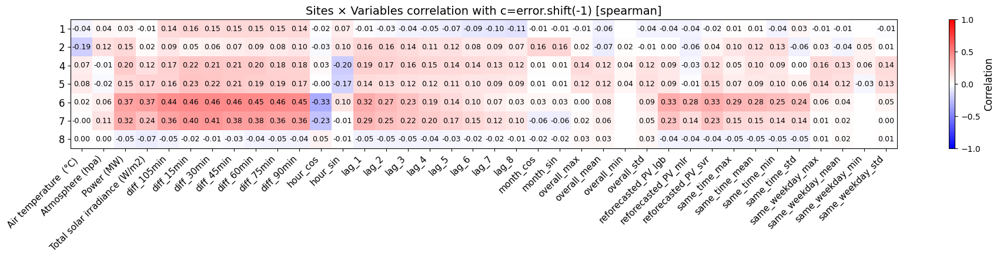

In [ ]:
# =========================
# 사이트별 corr 계산 → 통합 히트맵만 출력
# =========================
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd

def compute_corr_with_c(df, c_series, vars_to_check=None, method="spearman"):
    """사이트별 corr 계산 (NaN 자동 제거)"""
    if vars_to_check is None:
        vars_to_check = [
            col for col in df.select_dtypes(include=[np.number]).columns
            if not any(k in col for k in ["pred_", "error_", "generation", "Unnamed:"])
        ]
    def clean(s):
        s = pd.to_numeric(s, errors="coerce")
        s = s.replace([np.inf, -np.inf], np.nan)
        return s
    c_clean = clean(c_series)
    corr_vals = {}
    for col in vars_to_check:
        x = clean(df[col])
        valid = x.notna() & c_clean.notna()
        if valid.sum() > 3:
            corr_vals[col] = c_clean[valid].corr(x[valid], method=method)
        else:
            corr_vals[col] = np.nan
    return pd.Series(corr_vals)

def plot_corr_heatmap_sites_by_vars(corr_matrix, method="spearman"):
    fig, ax = plt.subplots(figsize=(max(10, 0.5*len(corr_matrix.columns)), 4.5))
    im = ax.imshow(corr_matrix.to_numpy(), aspect='auto', cmap='bwr', vmin=-1, vmax=1)

    # 축 레이블
    ax.set_yticks(range(len(corr_matrix.index)))
    ax.set_yticklabels(corr_matrix.index, fontsize=12)
    ax.set_xticks(range(len(corr_matrix.columns)))
    ax.set_xticklabels(corr_matrix.columns, rotation=45, ha='right', fontsize=11)
    ax.set_title(f"Sites × Variables correlation with c=error.shift(-1) [{method}]", fontsize=14)

    # 색상바
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label("Correlation", fontsize=12)
    cbar.ax.tick_params(labelsize=10)

    # 각 셀에 숫자 표시
    data = corr_matrix.to_numpy()
    nrows, ncols = data.shape
    for i in range(nrows):
        for j in range(ncols):
            val = data[i, j]
            if not np.isnan(val):
                ax.text(
                    j, i, f"{val:.2f}",
                    ha='center', va='center',
                    color='black' if abs(val) < 0.6 else 'white',  # 대비 조정
                    fontsize=9
                )

    plt.tight_layout()
    plt.show()



# =========================
# 실행 파트
# =========================
all_sites = [1, 2, 4, 5, 6, 7, 8]
method = "spearman"

# 공통 변수 자동 추출
numeric_sets = []
for site_idx in range(len(all_sites)):
    df = reforecast_dfs[site_idx]
    num_cols = set(df.select_dtypes(include=[np.number]).columns)
    filtered = {c for c in num_cols if not any(k in c for k in ["pred_", "error_", "generation", "Unnamed:"])}
    numeric_sets.append(filtered)
common_vars = sorted(set.intersection(*numeric_sets))

rows = []
row_index = []
for site_idx, site_num in enumerate(all_sites):
    df = reforecast_dfs[site_idx]
    forecast_model = best_model_combos[site_idx][0]
    c = -df[f'error_{forecast_model}'].shift(-1)
    corr_s = compute_corr_with_c(df, c, vars_to_check=common_vars, method=method)
    rows.append(corr_s.to_numpy())
    row_index.append(site_num)

corr_mat = pd.DataFrame(np.vstack(rows), index=row_index, columns=common_vars)
plot_corr_heatmap_sites_by_vars(corr_mat, method=method)


/usr/local/lib/python3.12/dist-packages/pandas/core/nanops.py:1632: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  return spearmanr(a, b)[0]


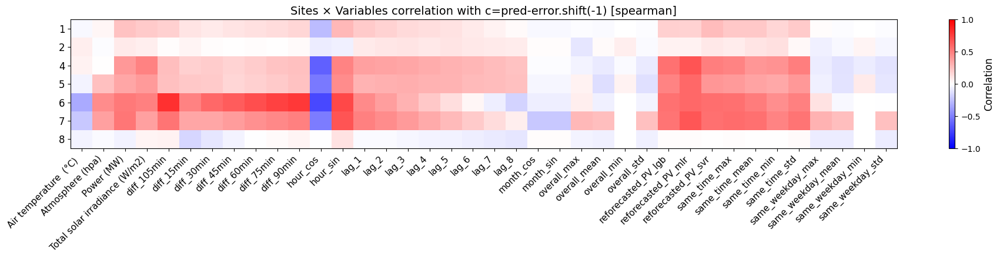

In [ ]:
# =========================
# 사이트별 corr 계산 → 통합 히트맵만 출력
# =========================
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd

def compute_corr_with_c(df, c_series, vars_to_check=None, method="spearman"):
    """사이트별 corr 계산 (NaN 자동 제거)"""
    if vars_to_check is None:
        vars_to_check = [
            col for col in df.select_dtypes(include=[np.number]).columns
            if not any(k in col for k in ["pred_", "error_", "generation", "Unnamed:"])
        ]
    def clean(s):
        s = pd.to_numeric(s, errors="coerce")
        s = s.replace([np.inf, -np.inf], np.nan)
        return s
    c_clean = clean(c_series)
    corr_vals = {}
    for col in vars_to_check:
        x = clean(df[col])
        valid = x.notna() & c_clean.notna()
        if valid.sum() > 3:
            corr_vals[col] = c_clean[valid].corr(x[valid], method=method)
        else:
            corr_vals[col] = np.nan
    return pd.Series(corr_vals)

def plot_corr_heatmap_sites_by_vars(corr_matrix, method="spearman"):
    fig, ax = plt.subplots(figsize=(max(10, 0.5*len(corr_matrix.columns)), 4.5))
    im = ax.imshow(corr_matrix.to_numpy(), aspect='auto', cmap='bwr', vmin=-1, vmax=1)
    ax.set_yticks(range(len(corr_matrix.index)))
    ax.set_yticklabels(corr_matrix.index, fontsize=12)
    ax.set_xticks(range(len(corr_matrix.columns)))
    ax.set_xticklabels(corr_matrix.columns, rotation=45, ha='right', fontsize=11)
    ax.set_title(f"Sites × Variables correlation with c=pred-error.shift(-1) [{method}]", fontsize=14)
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label("Correlation", fontsize=12)
    cbar.ax.tick_params(labelsize=10)
    plt.tight_layout()
    plt.show()


# =========================
# 실행 파트
# =========================
all_sites = [1, 2, 4, 5, 6, 7, 8]
method = "spearman"

# 공통 변수 자동 추출
numeric_sets = []
for site_idx in range(len(all_sites)):
    df = reforecast_dfs[site_idx]
    num_cols = set(df.select_dtypes(include=[np.number]).columns)
    filtered = {c for c in num_cols if not any(k in c for k in ["pred_", "error_", "generation", "Unnamed:"])}
    numeric_sets.append(filtered)
common_vars = sorted(set.intersection(*numeric_sets))

rows = []
row_index = []
for site_idx, site_num in enumerate(all_sites):
    df = reforecast_dfs[site_idx]
    forecast_model = best_model_combos[site_idx][0]
    c = -df[f'pred_error_{forecast_model}'].shift(-1)
    corr_s = compute_corr_with_c(df, c, vars_to_check=common_vars, method=method)
    rows.append(corr_s.to_numpy())
    row_index.append(site_num)

corr_mat = pd.DataFrame(np.vstack(rows), index=row_index, columns=common_vars)
plot_corr_heatmap_sites_by_vars(corr_mat, method=method)


/tmp/ipython-input-3430322741.py:48: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipython-input-3430322741.py:48: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipython-input-3430322741.py:48: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipython-input-

--------------------------------------------------
Feature: Total solar irradiance (W/m2)
  [Site 1]


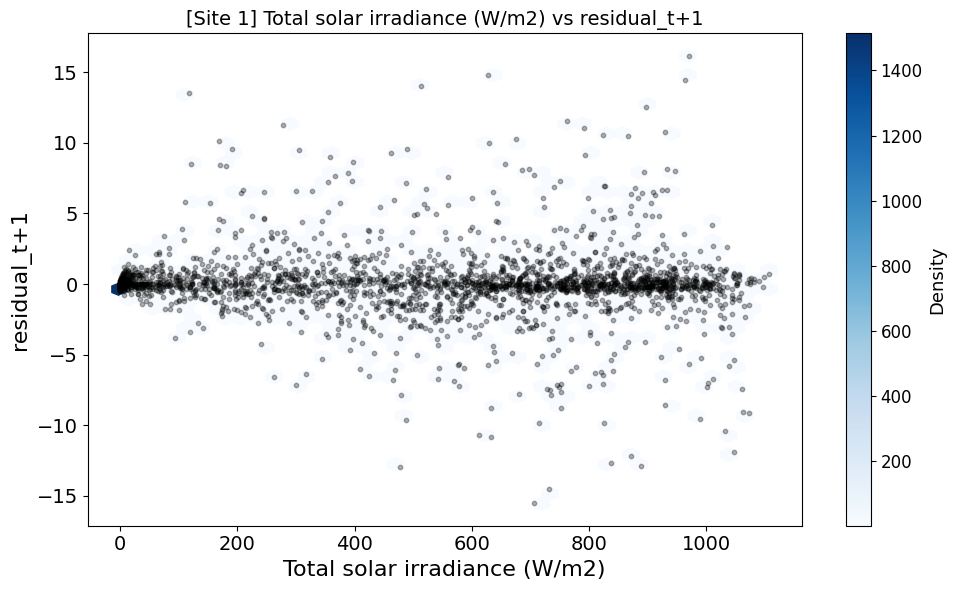

  [Site 2]


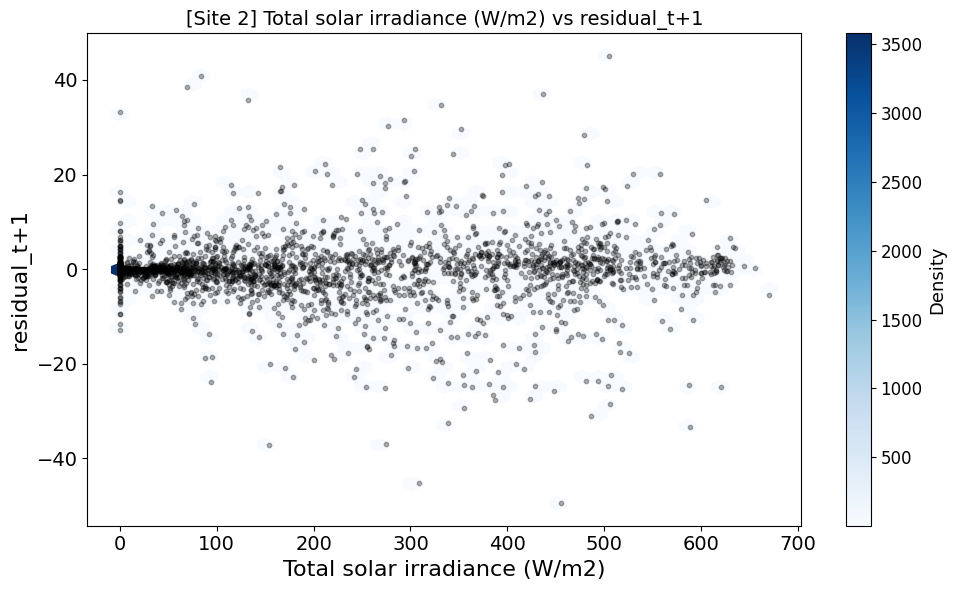

  [Site 4]


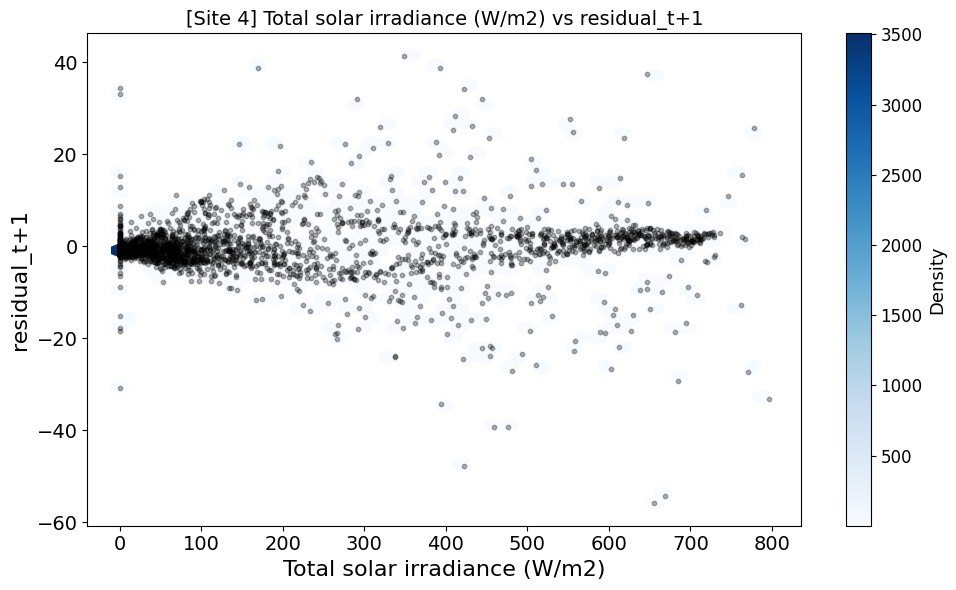

  [Site 5]


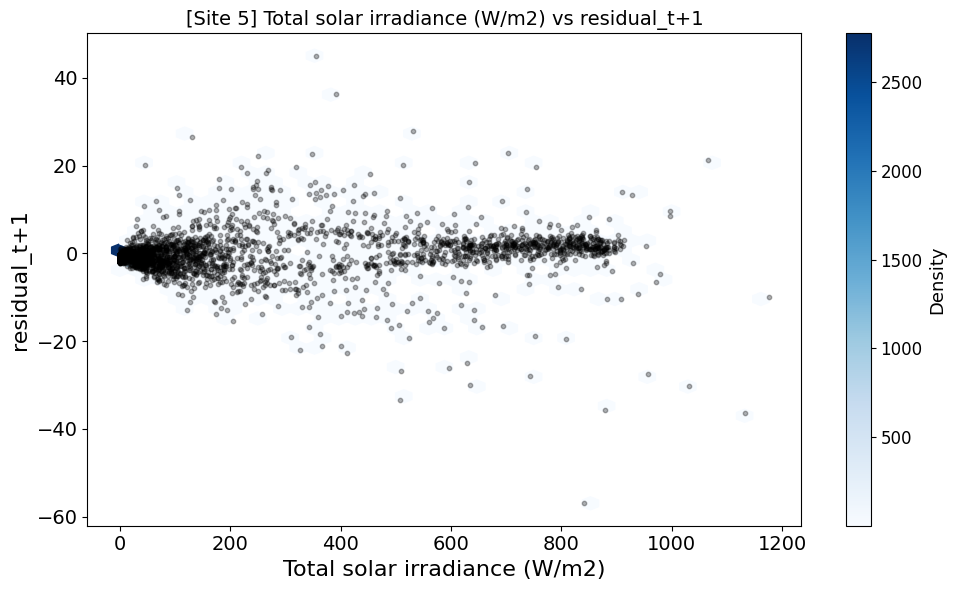

  [Site 6]


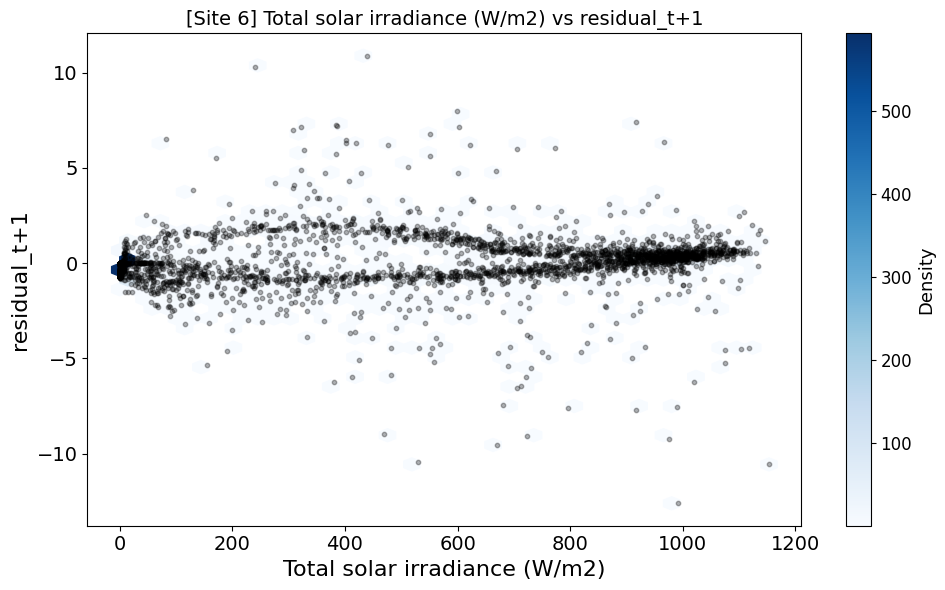

  [Site 7]


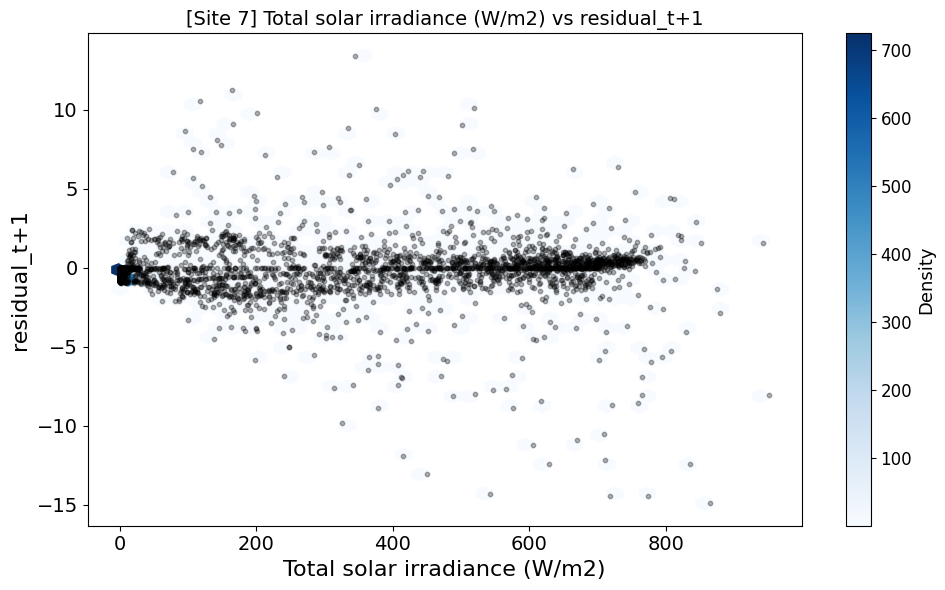

  [Site 8]


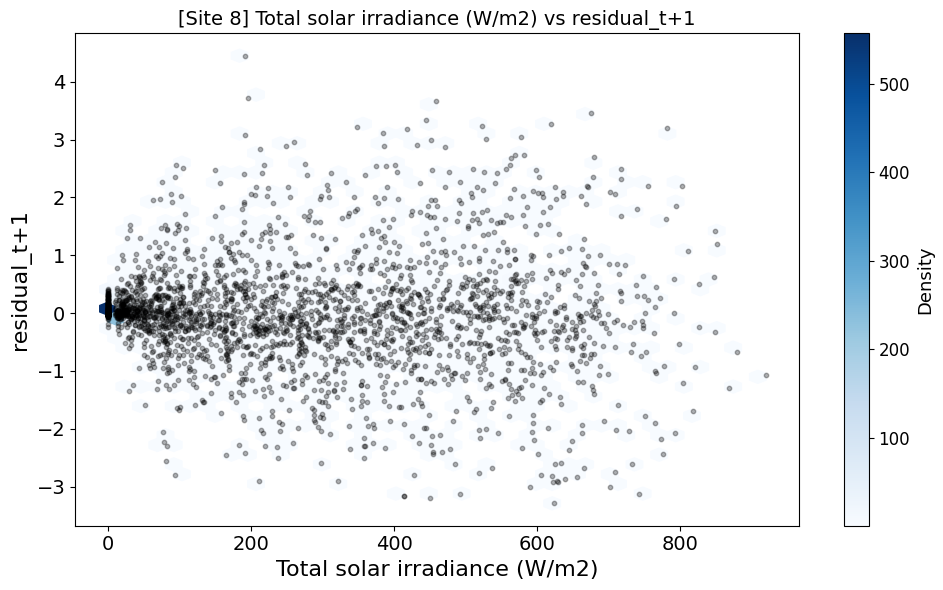

--------------------------------------------------
Feature: same_time_mean
  [Site 1]


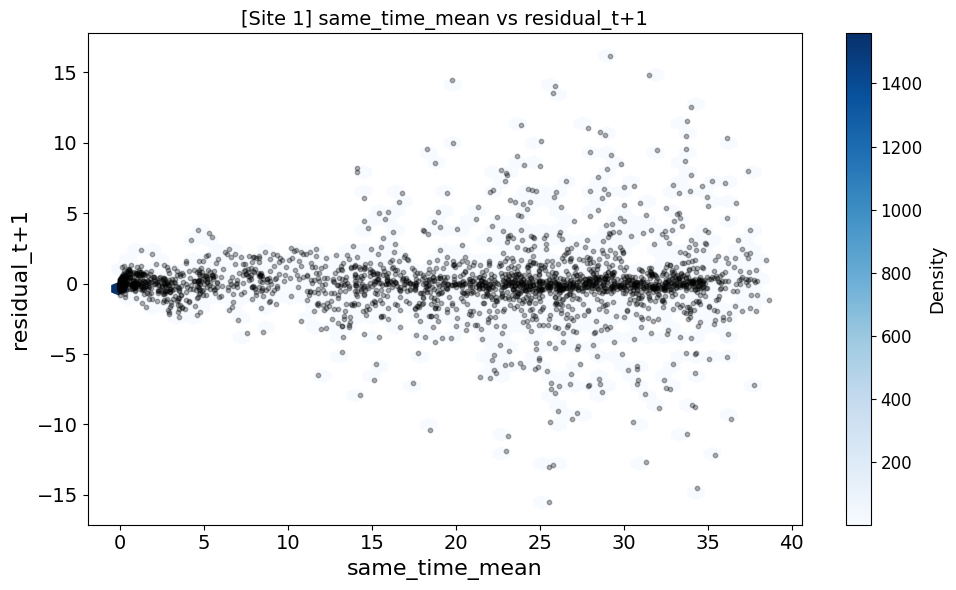

  [Site 2]


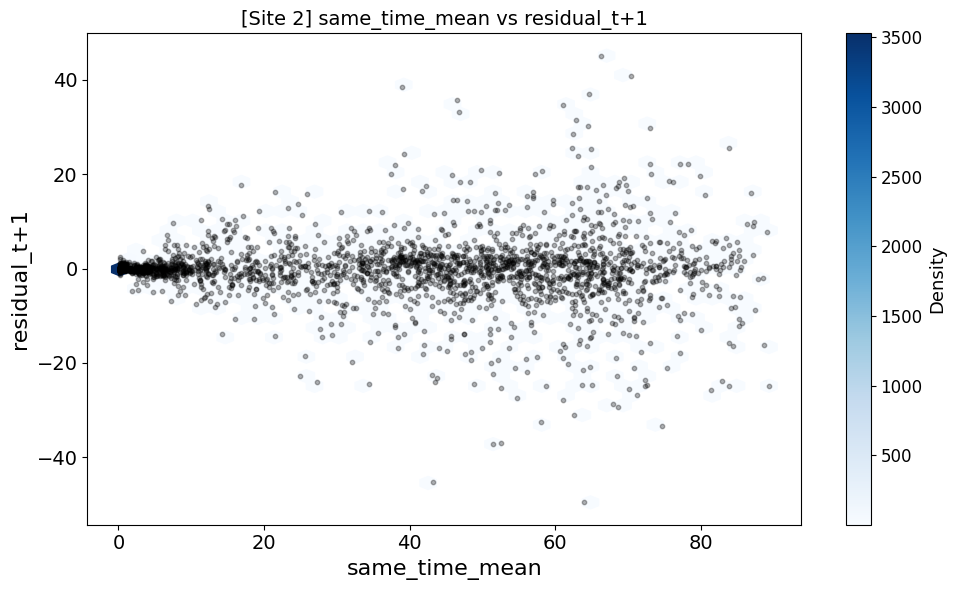

  [Site 4]


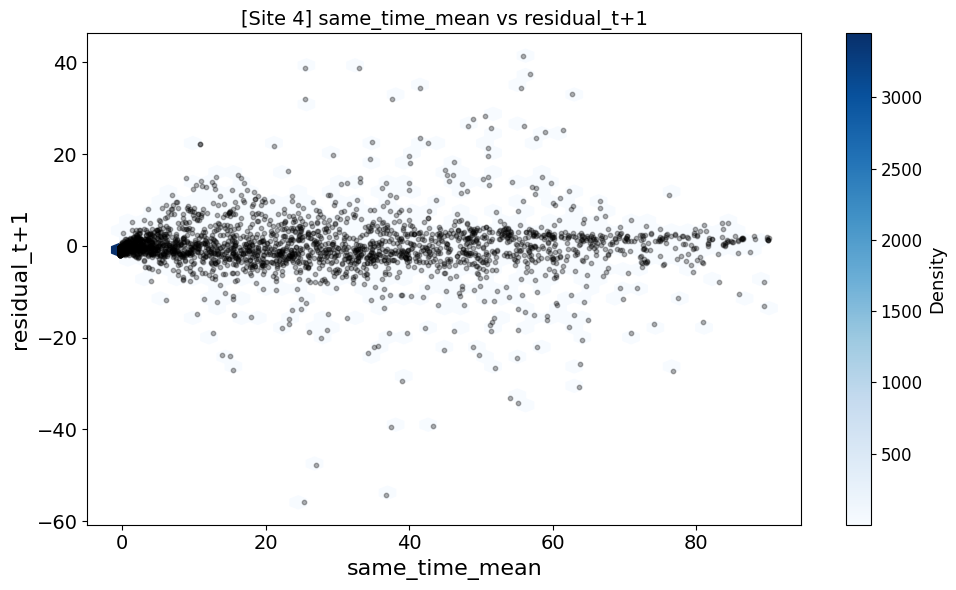

  [Site 5]


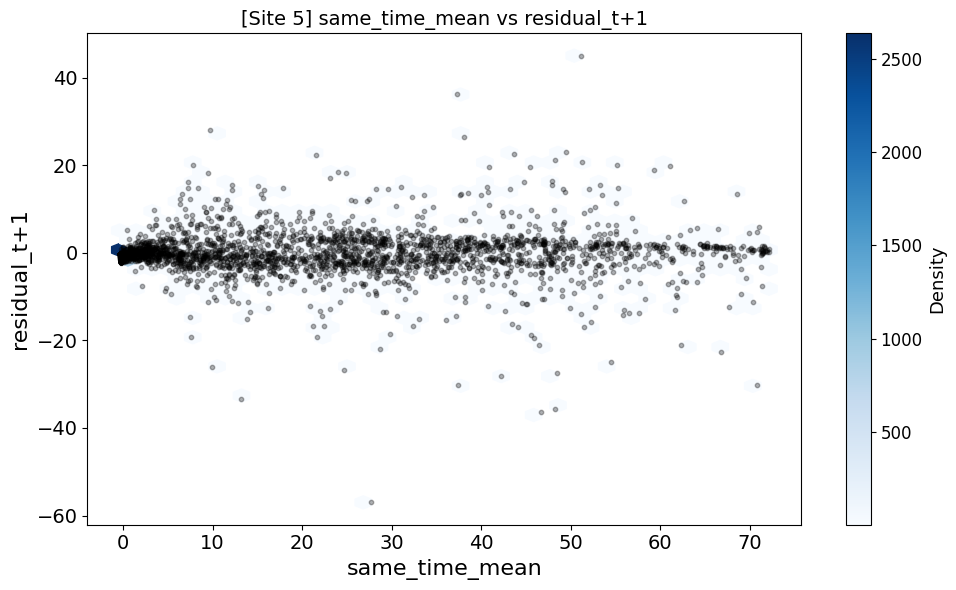

  [Site 6]


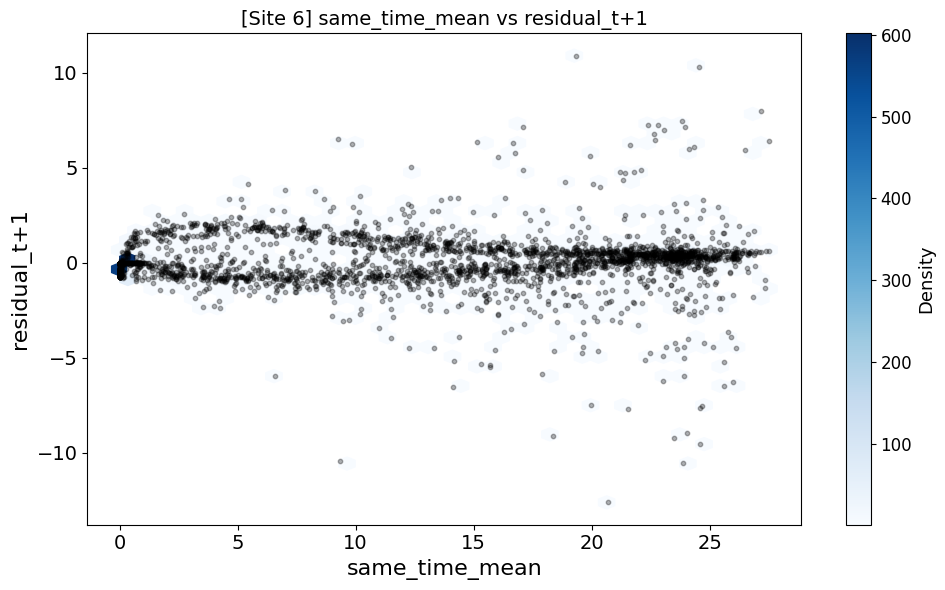

  [Site 7]


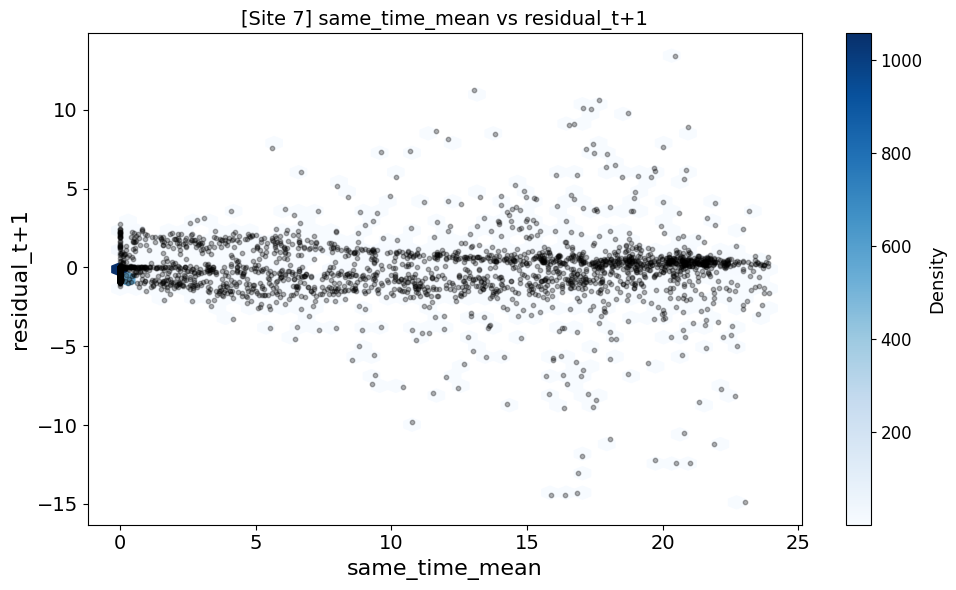

  [Site 8]


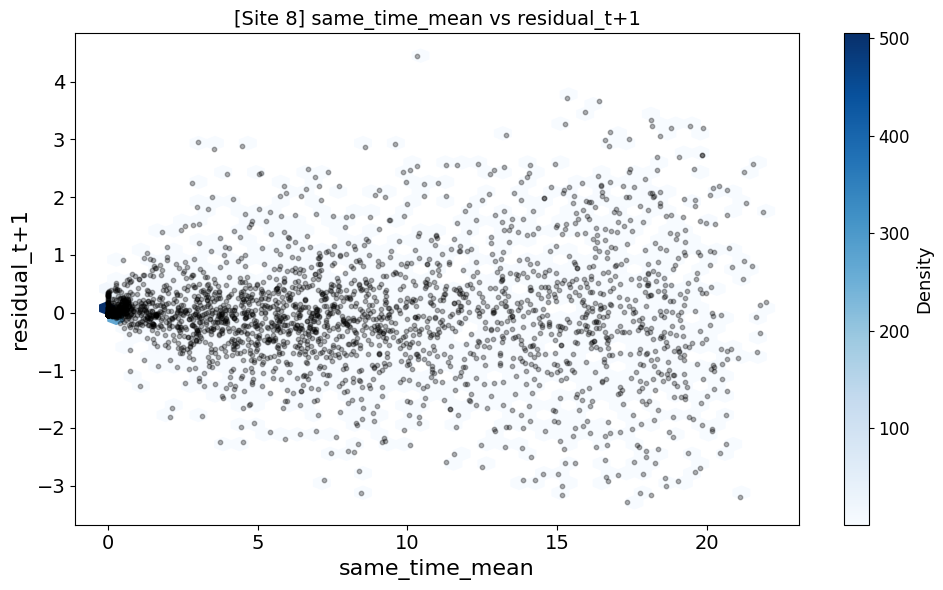

--------------------------------------------------
Feature: same_time_max
  [Site 1]


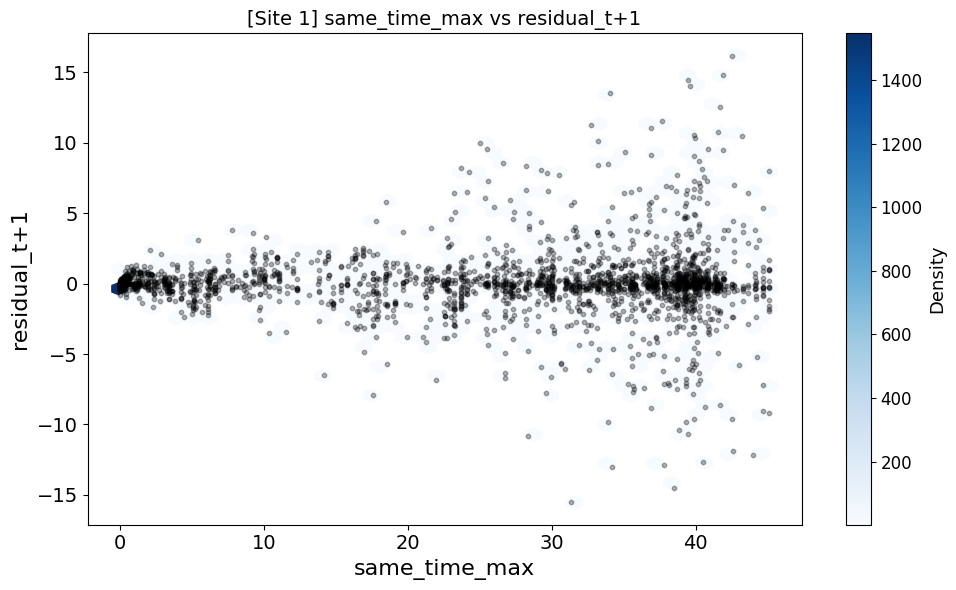

  [Site 2]


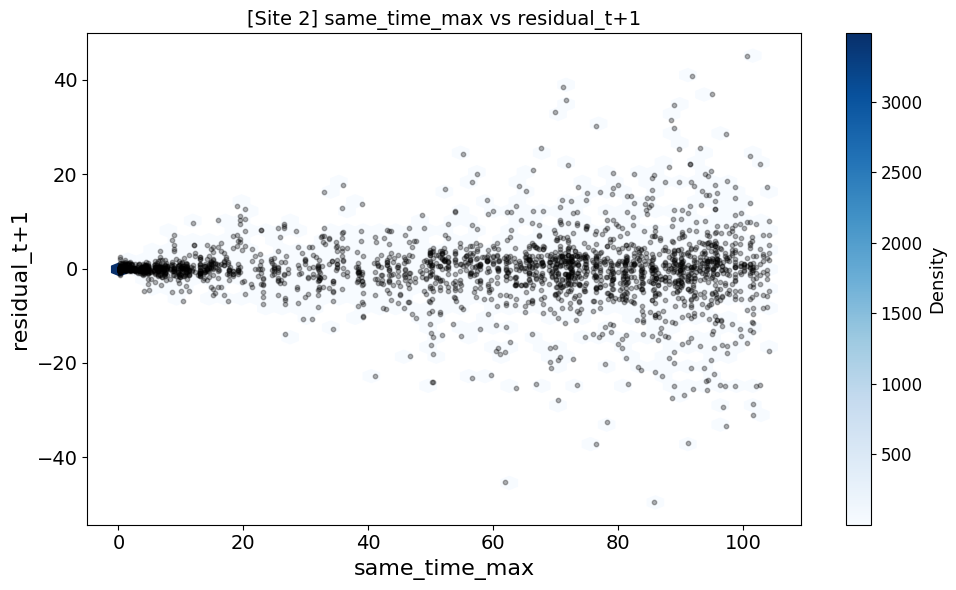

  [Site 4]


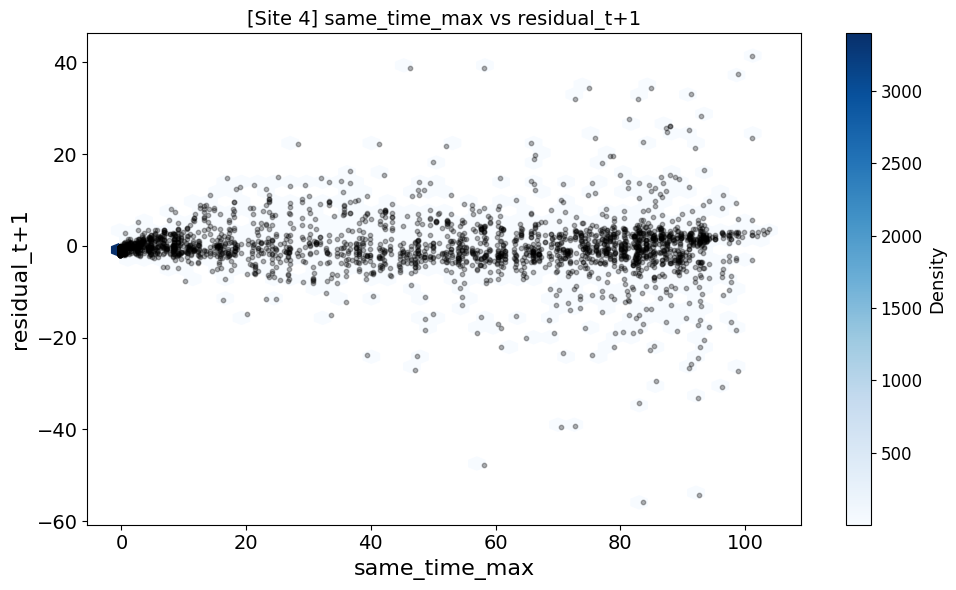

  [Site 5]


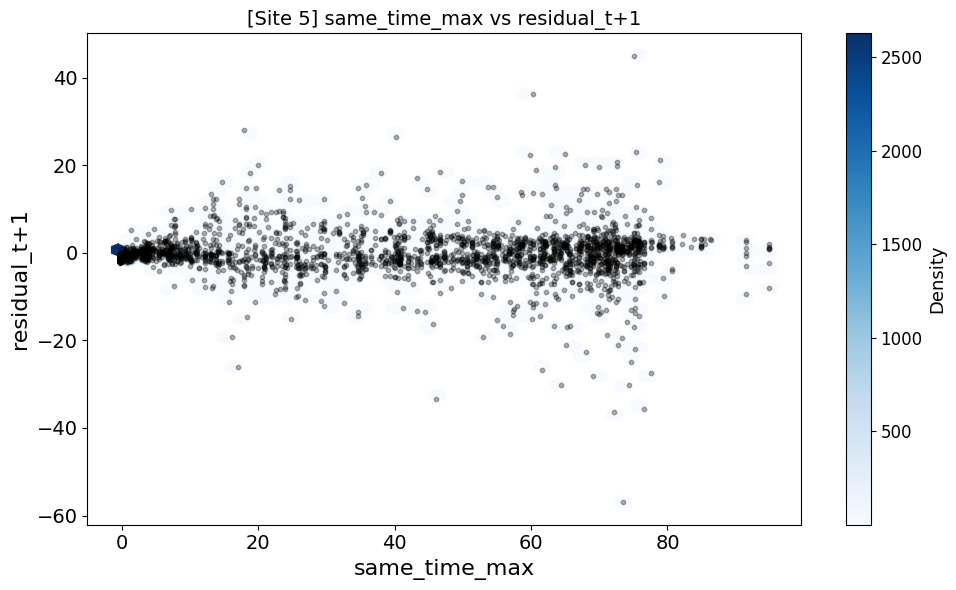

  [Site 6]


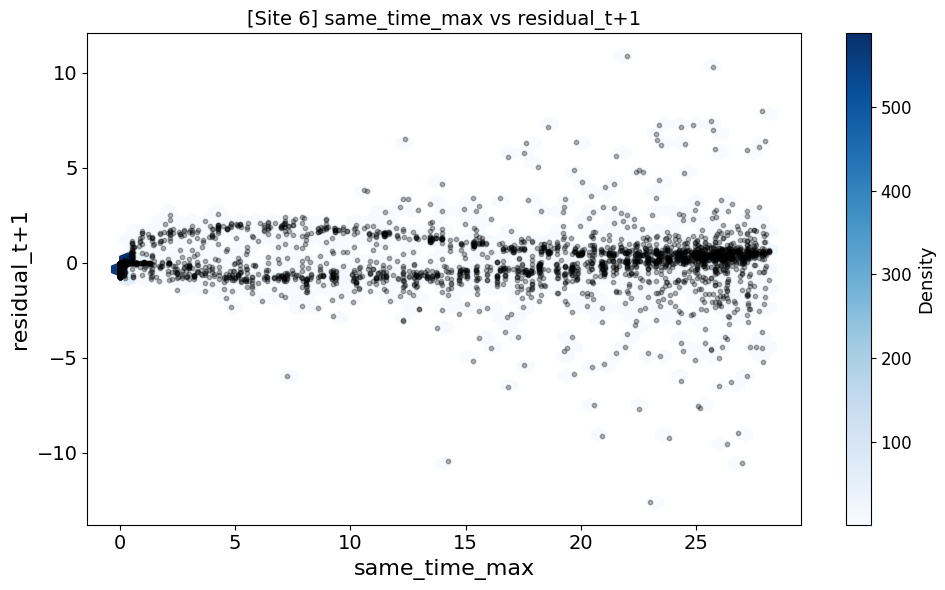

  [Site 7]


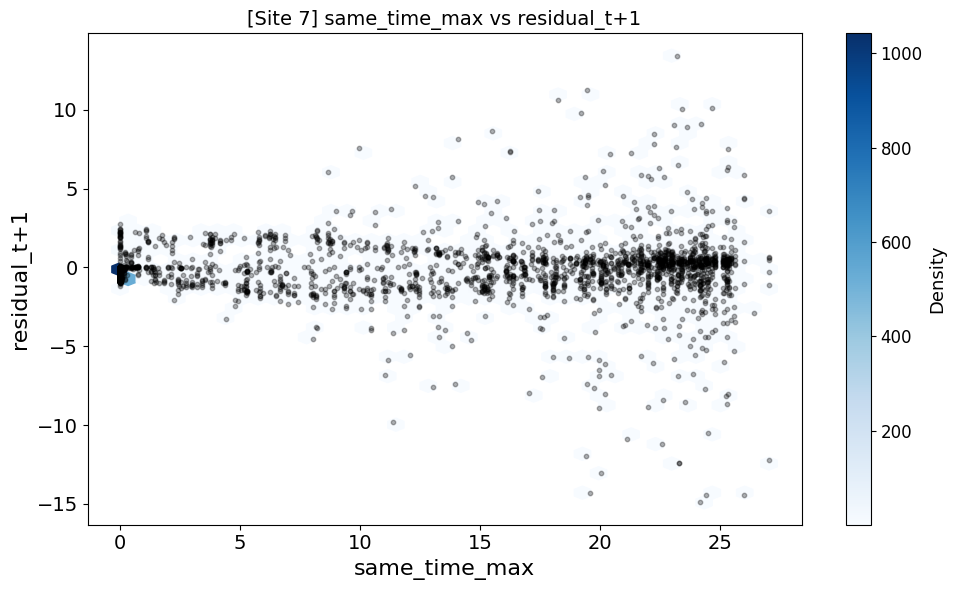

  [Site 8]


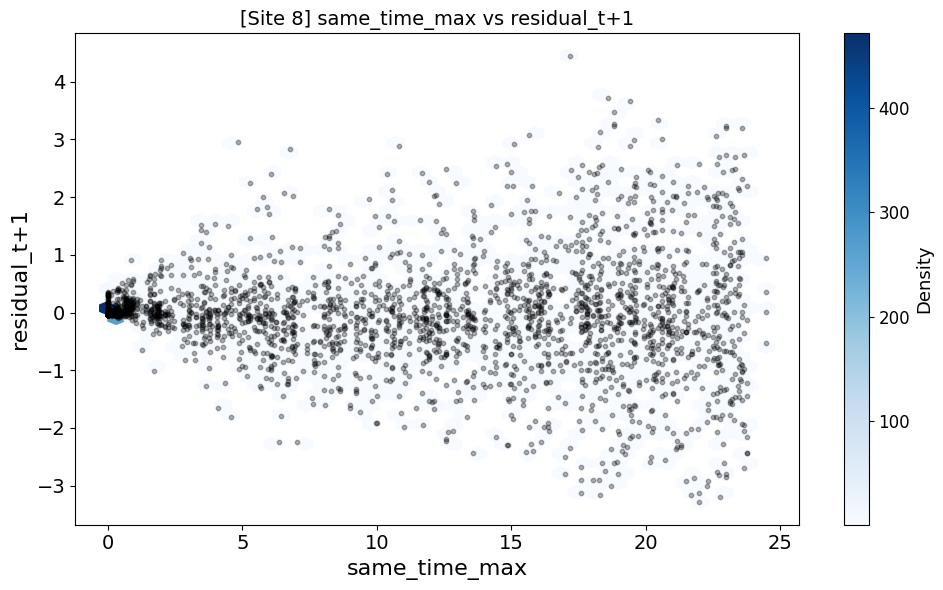

--------------------------------------------------
Feature: lag_1
  [Site 1]


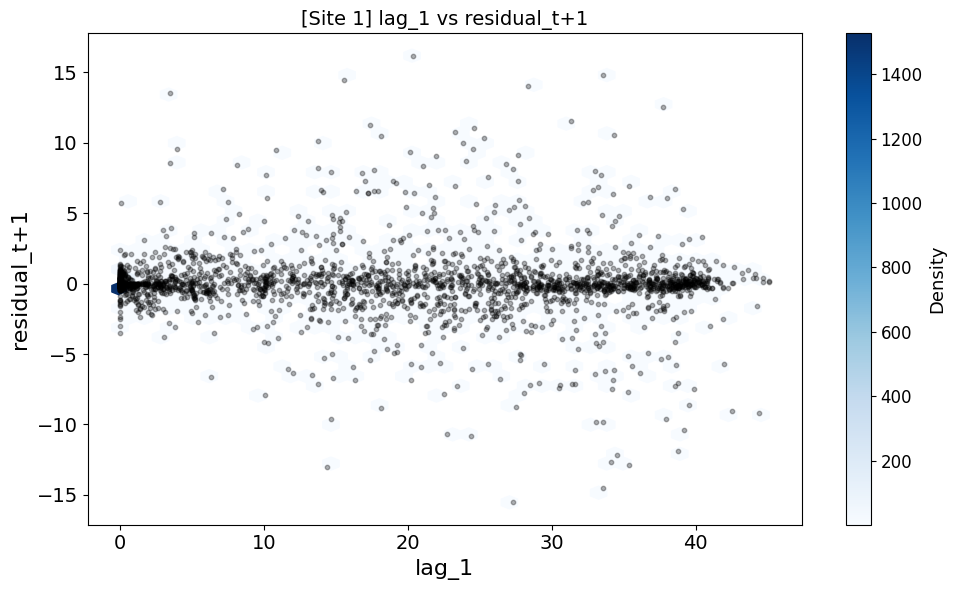

  [Site 2]


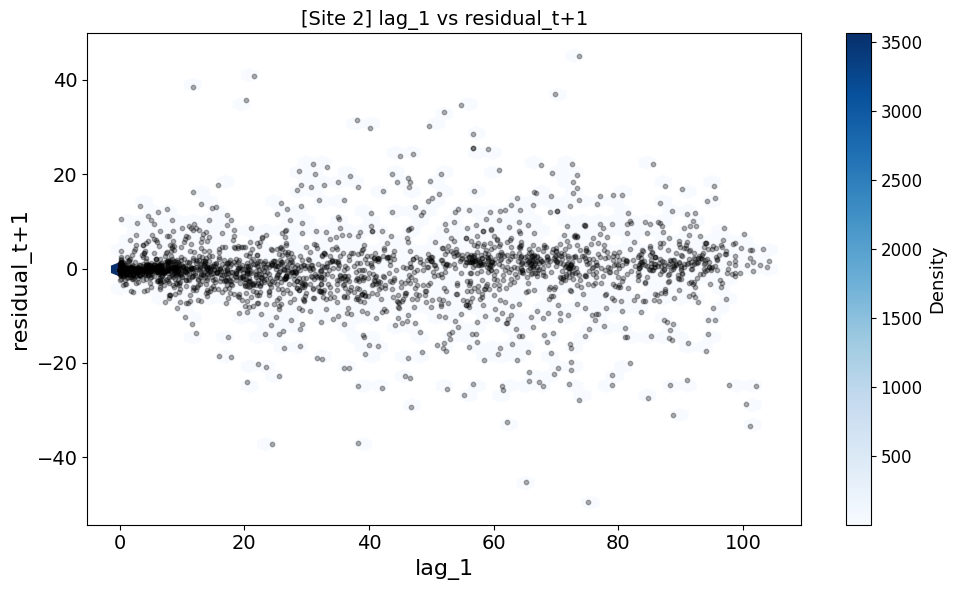

  [Site 4]


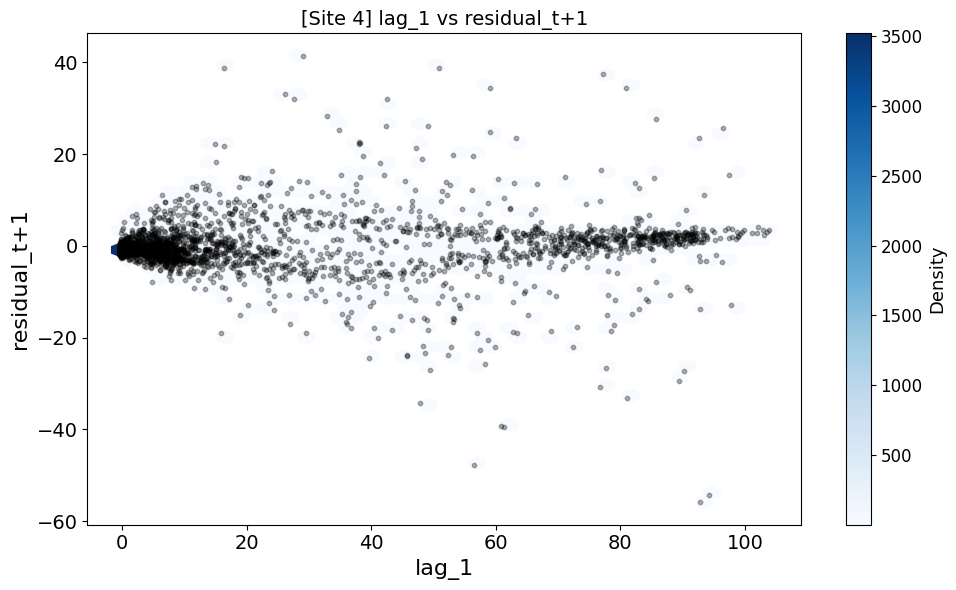

  [Site 5]


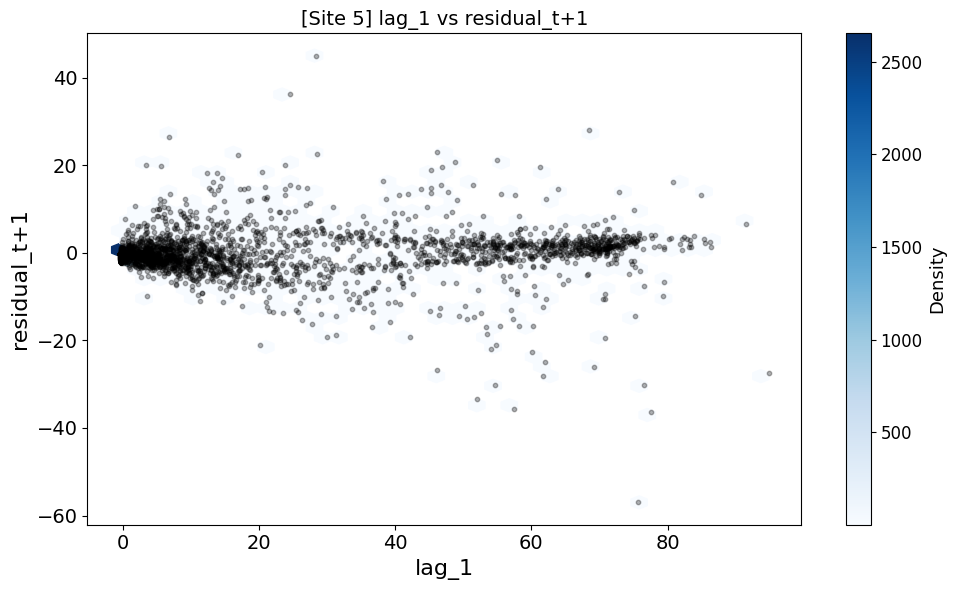

  [Site 6]


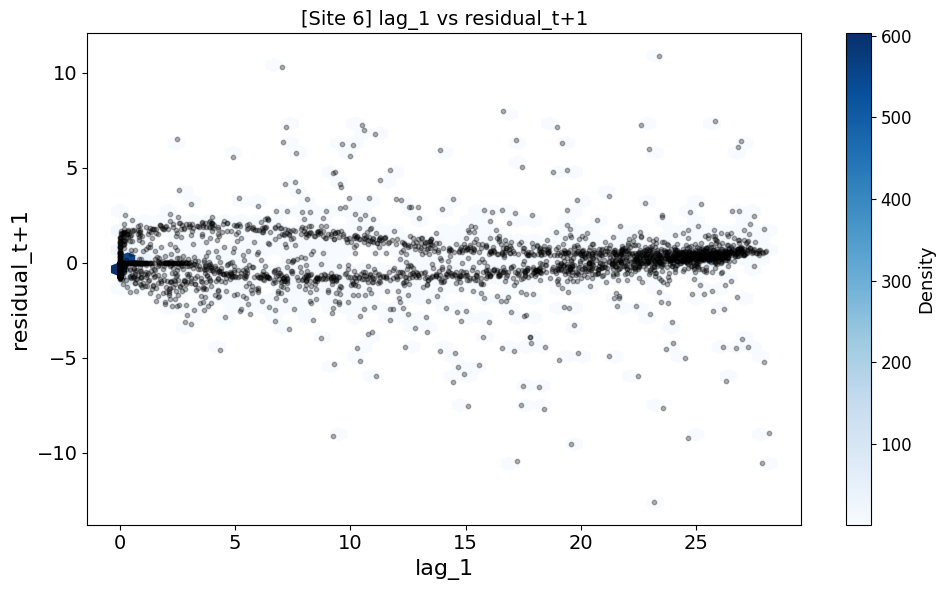

  [Site 7]


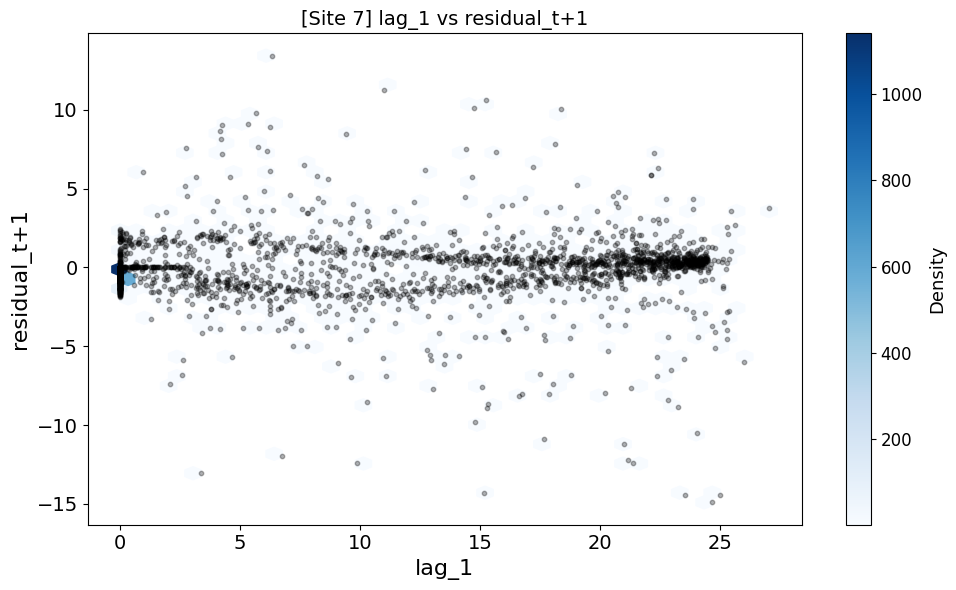

  [Site 8]


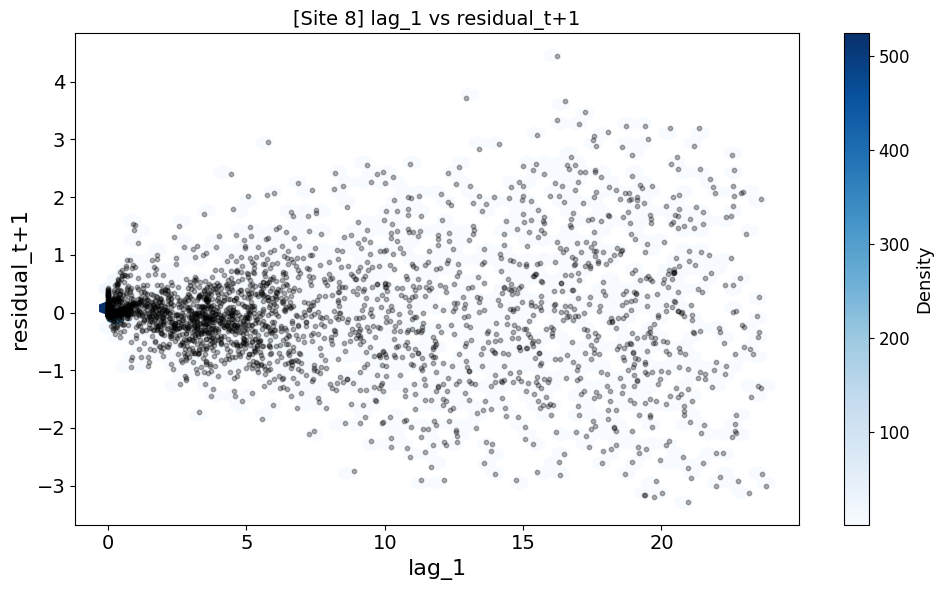

--------------------------------------------------
Feature: lag_8
  [Site 1]


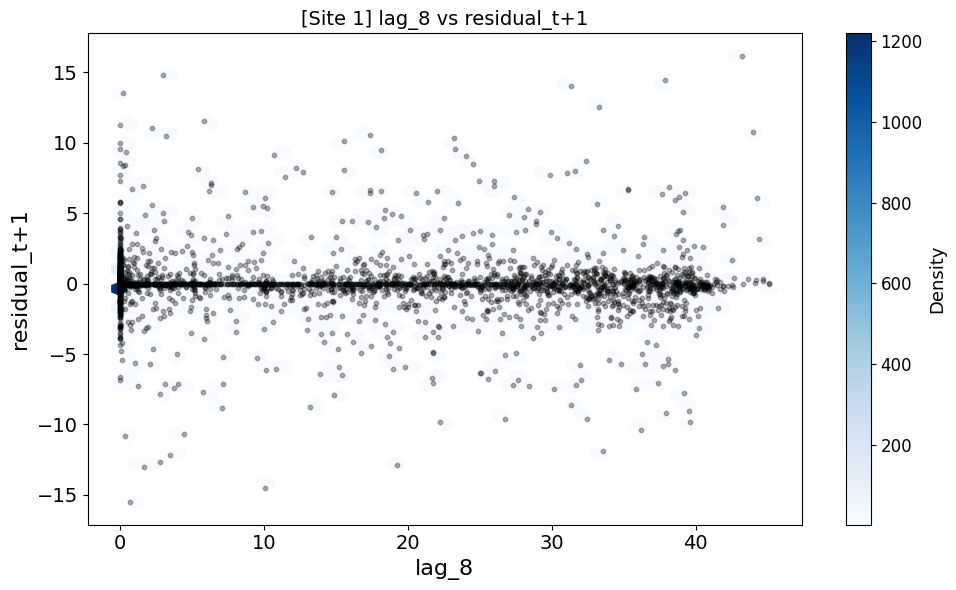

  [Site 2]


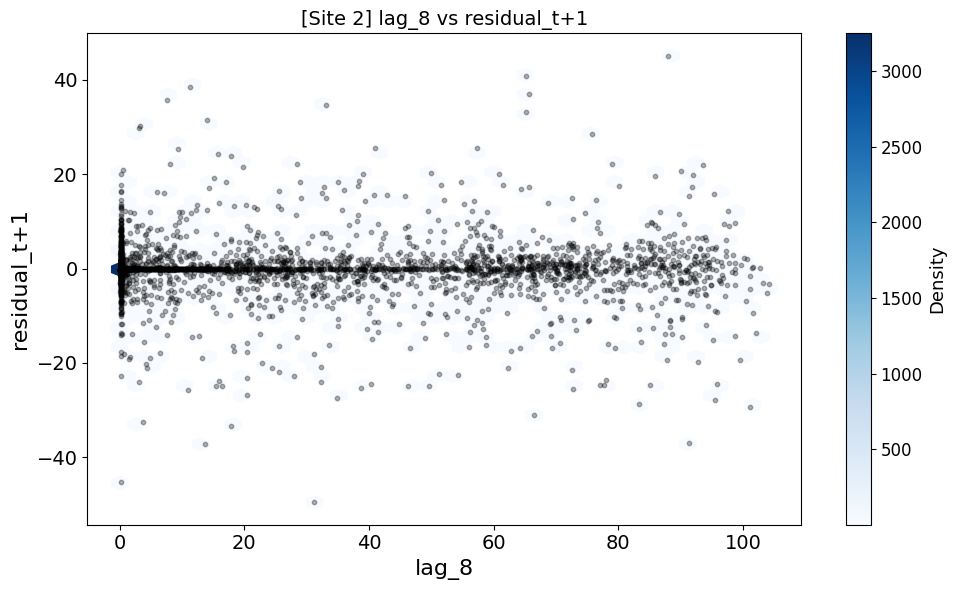

  [Site 4]


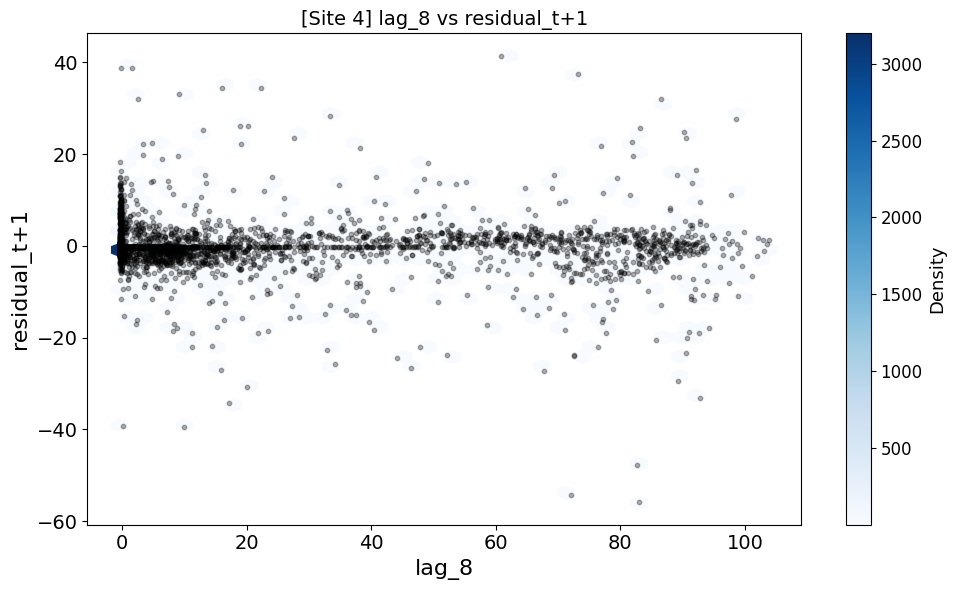

  [Site 5]


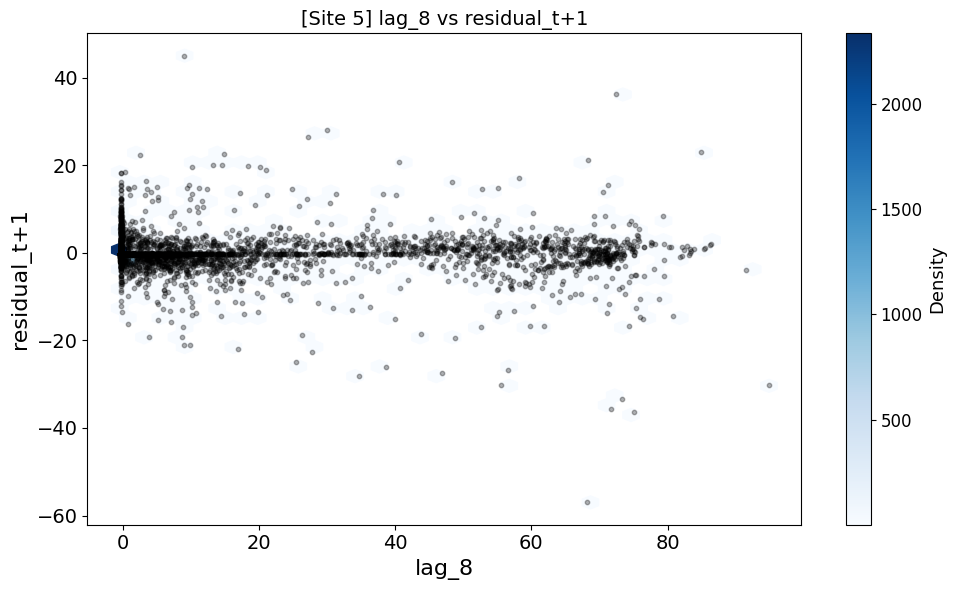

  [Site 6]


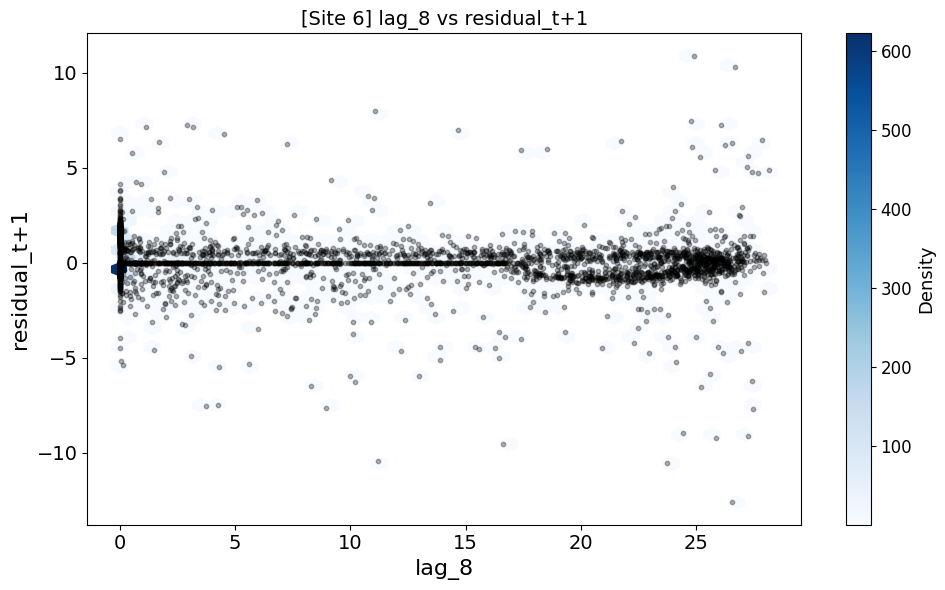

  [Site 7]


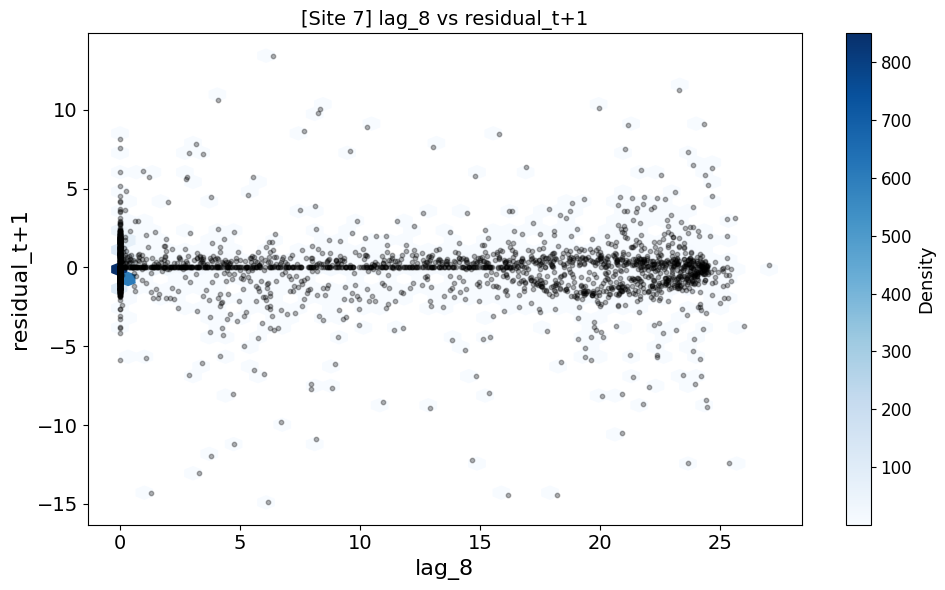

  [Site 8]


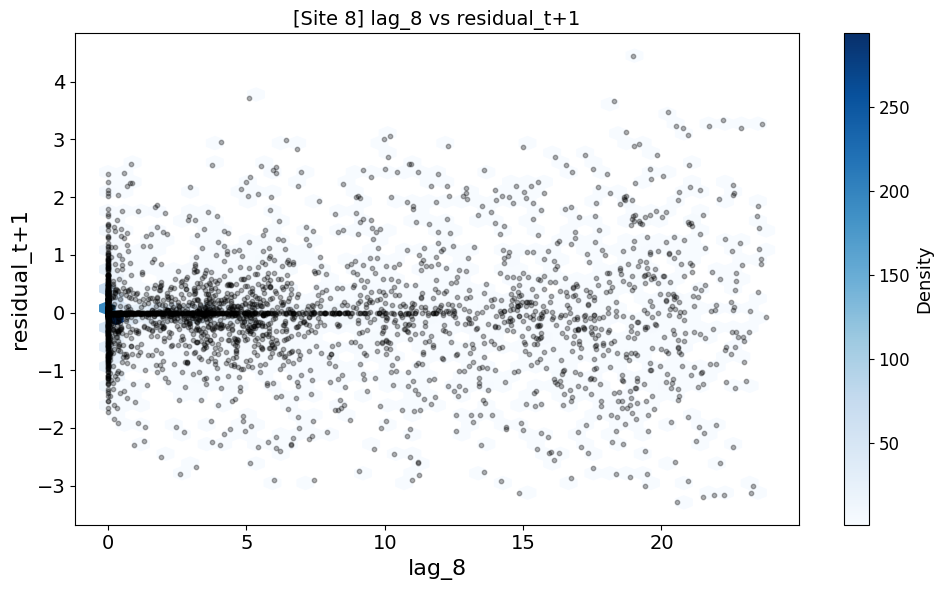

--------------------------------------------------
Feature: diff_15min
  [Site 1]


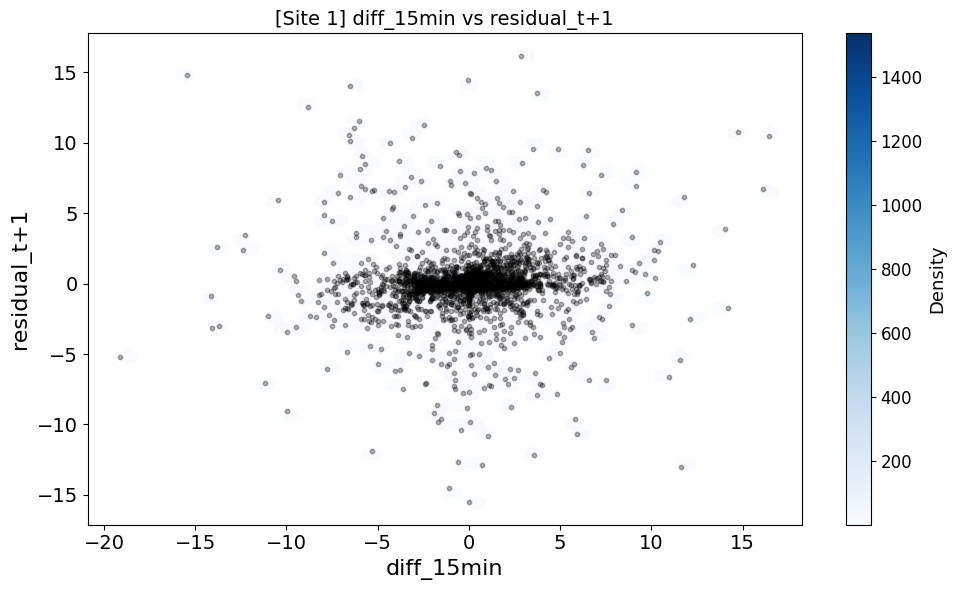

  [Site 2]


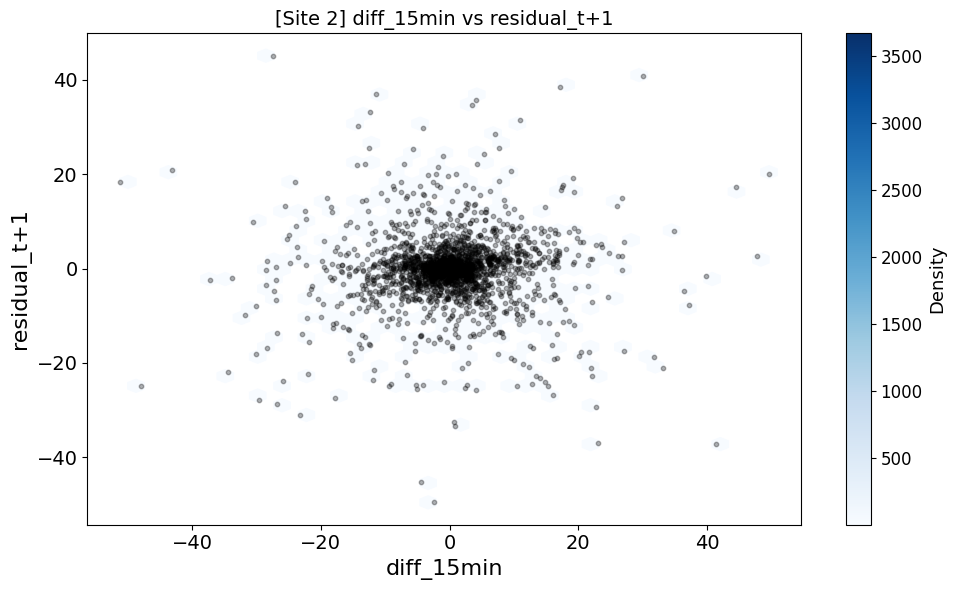

  [Site 4]


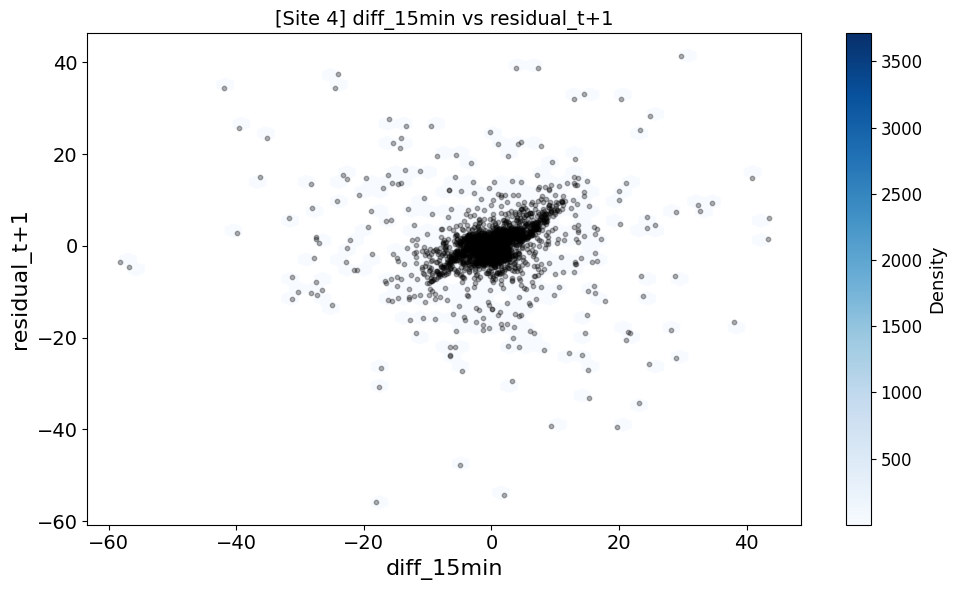

  [Site 5]


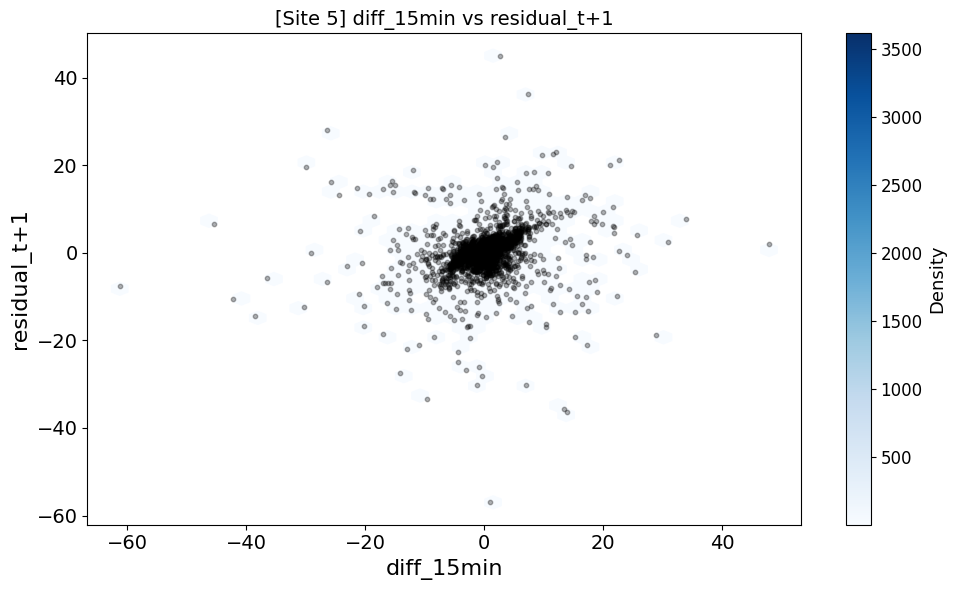

  [Site 6]


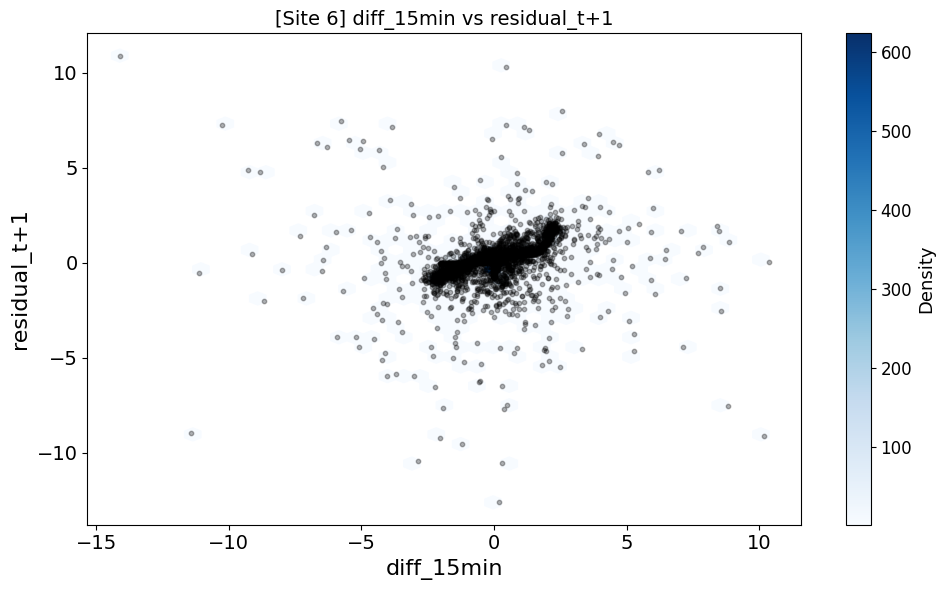

  [Site 7]


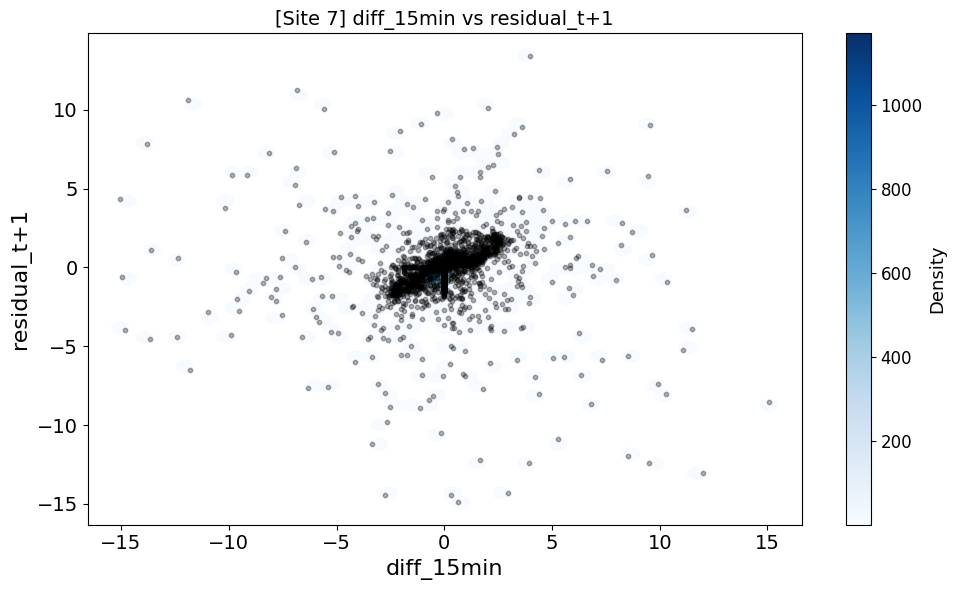

  [Site 8]


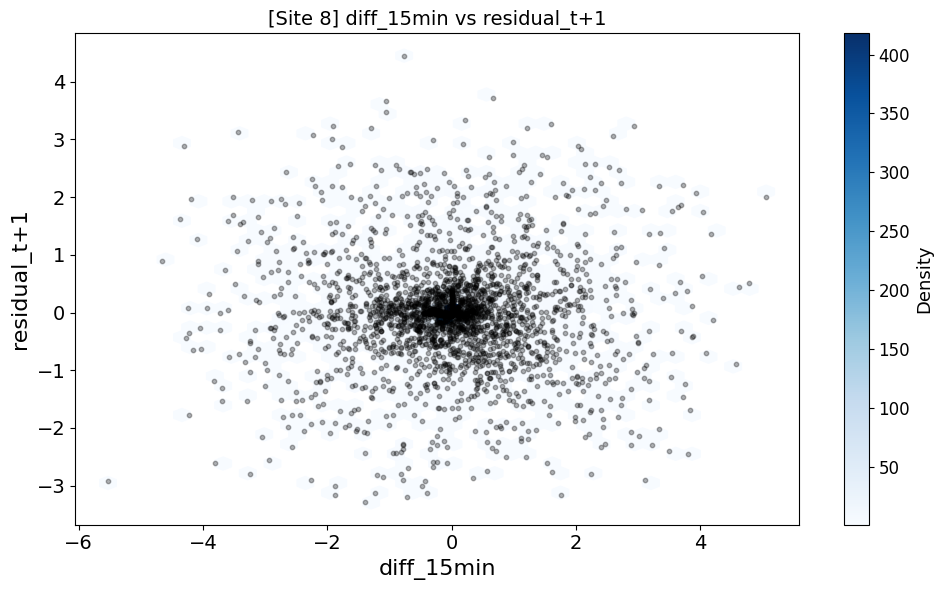

--------------------------------------------------
Feature: diff_105min
  [Site 1]


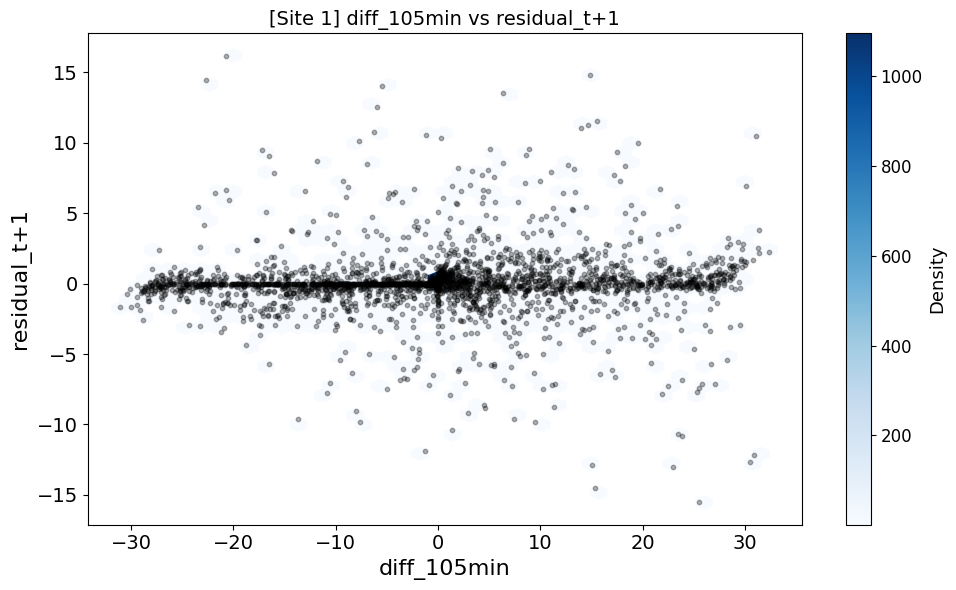

  [Site 2]


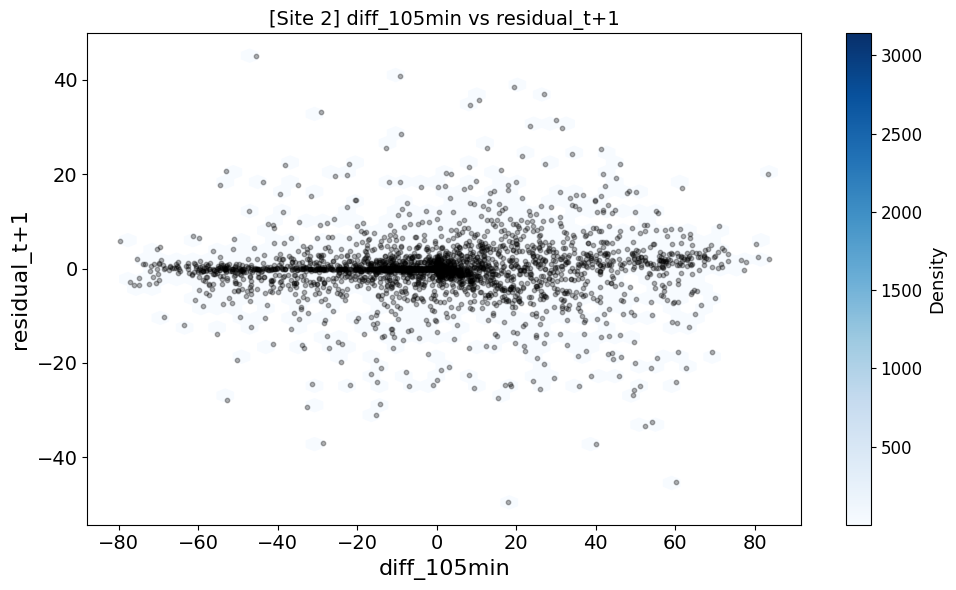

  [Site 4]


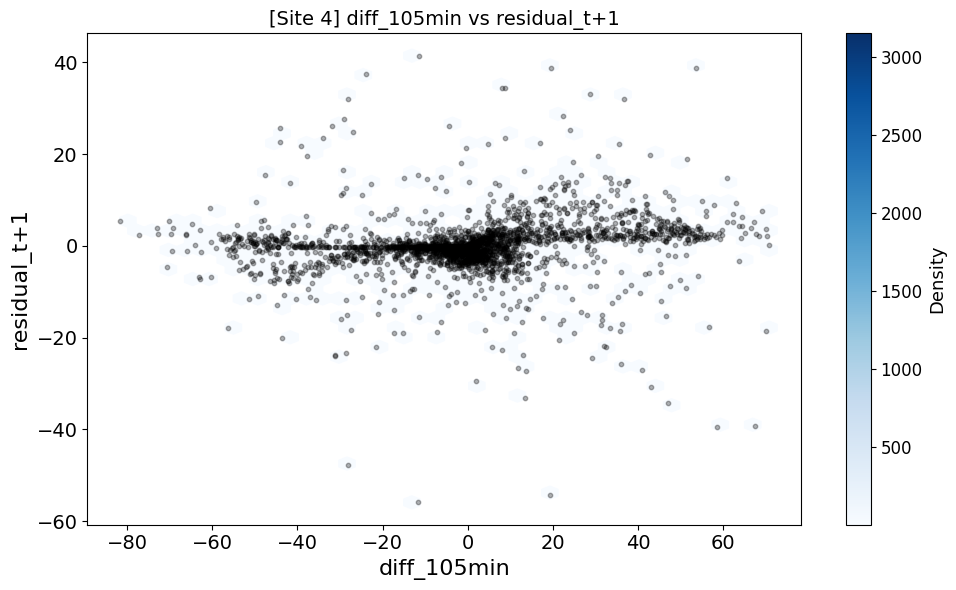

  [Site 5]


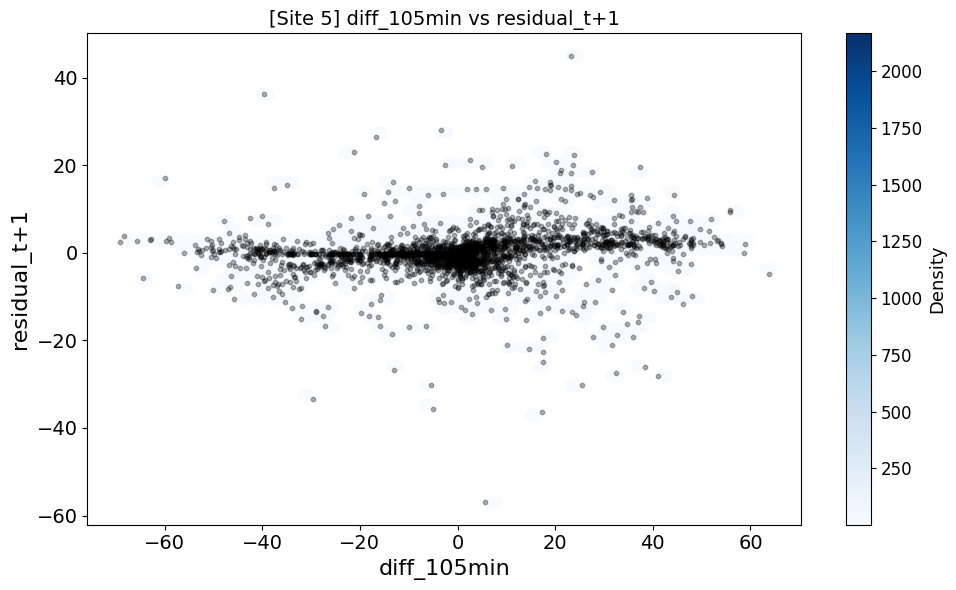

  [Site 6]


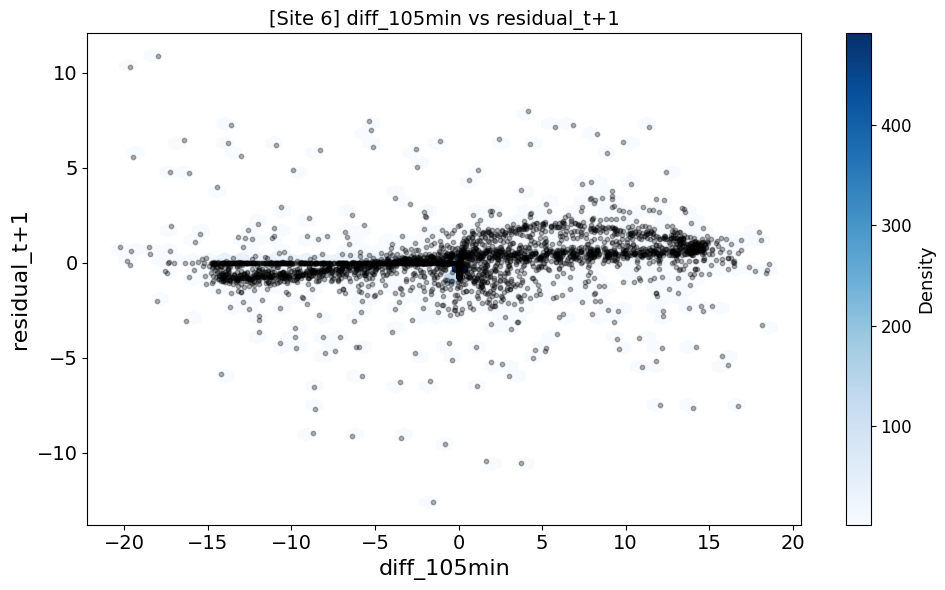

  [Site 7]


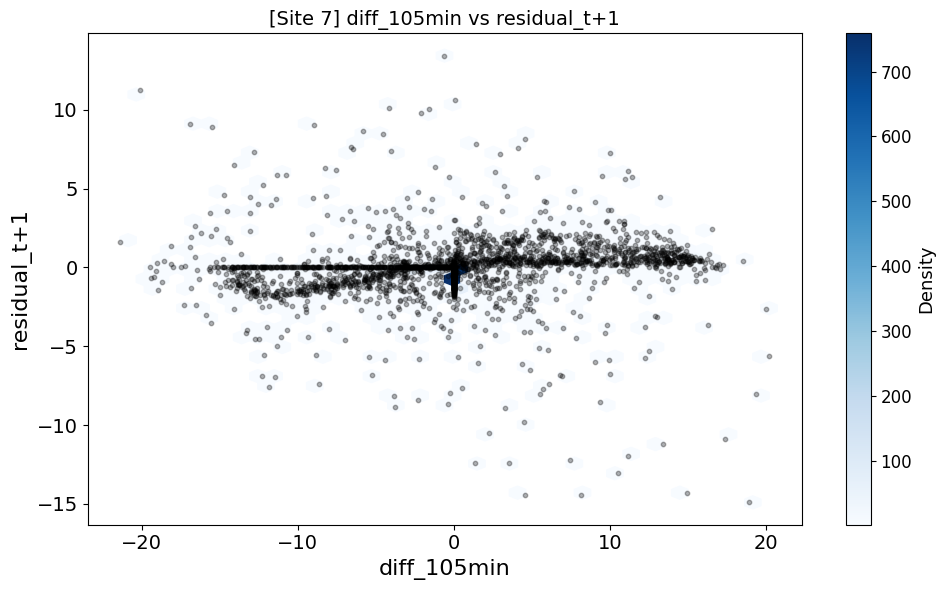

  [Site 8]


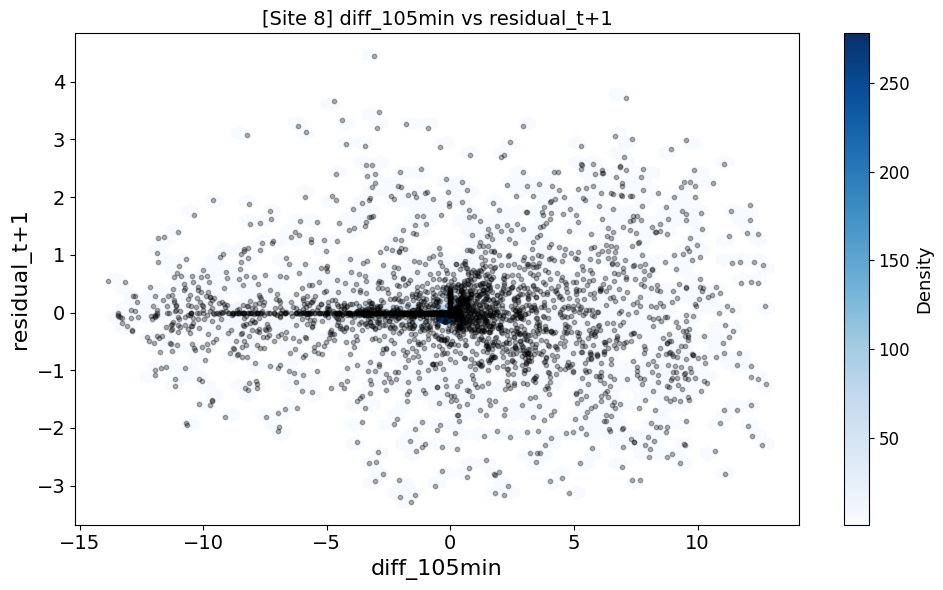

--------------------------------------------------
Feature: pred_lgb
  [Site 1]


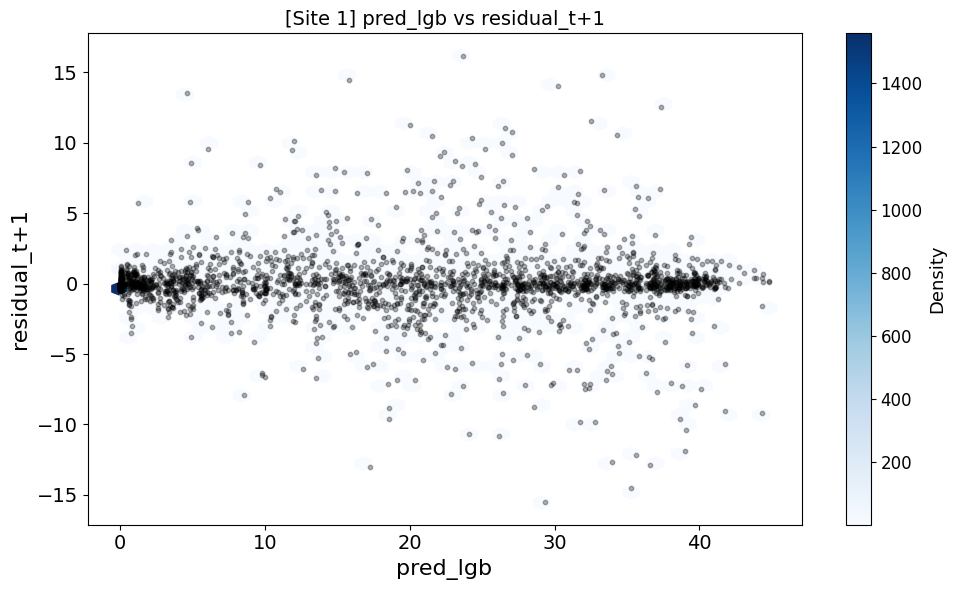

  [Site 2]


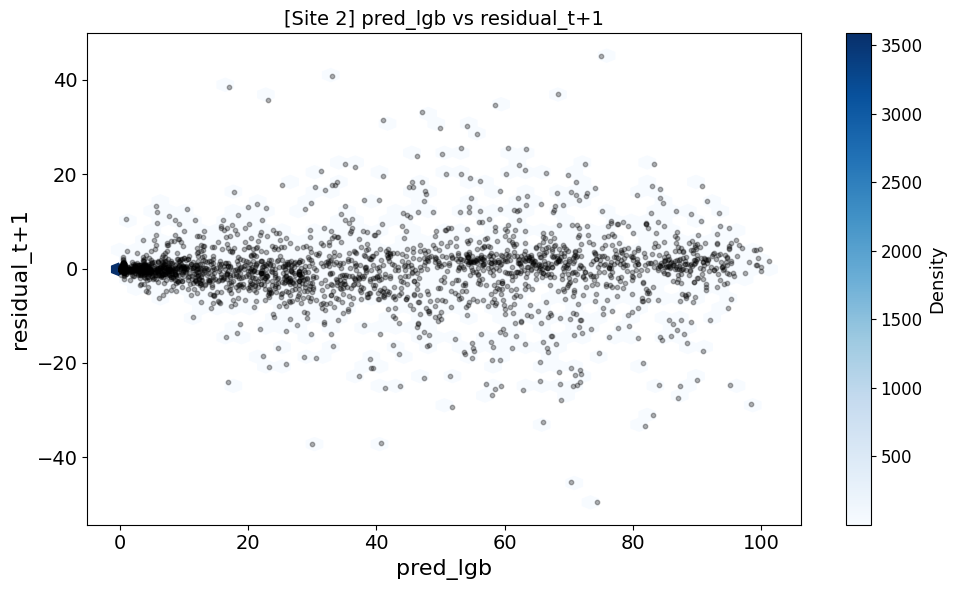

  [Site 4]


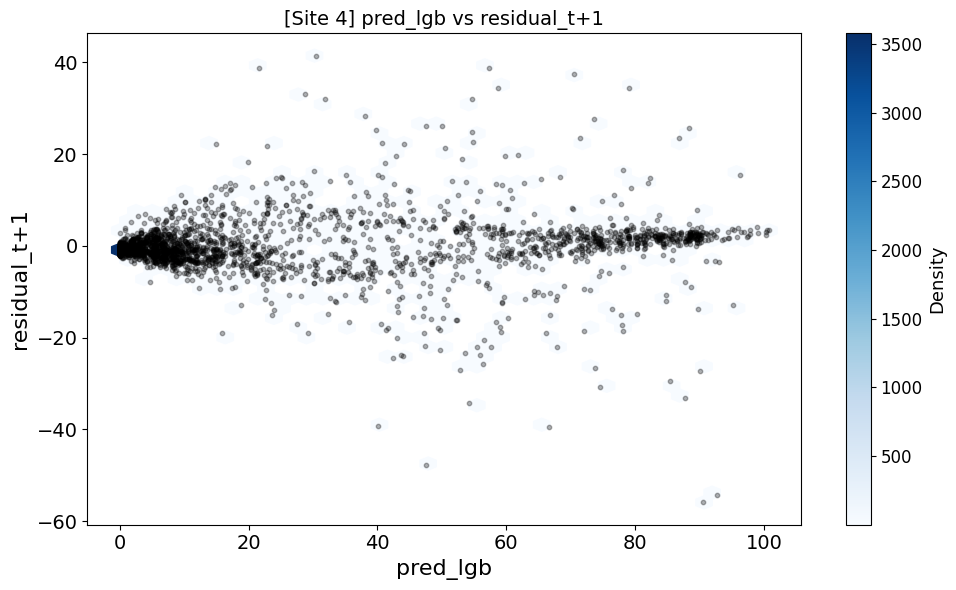

  [Site 5]


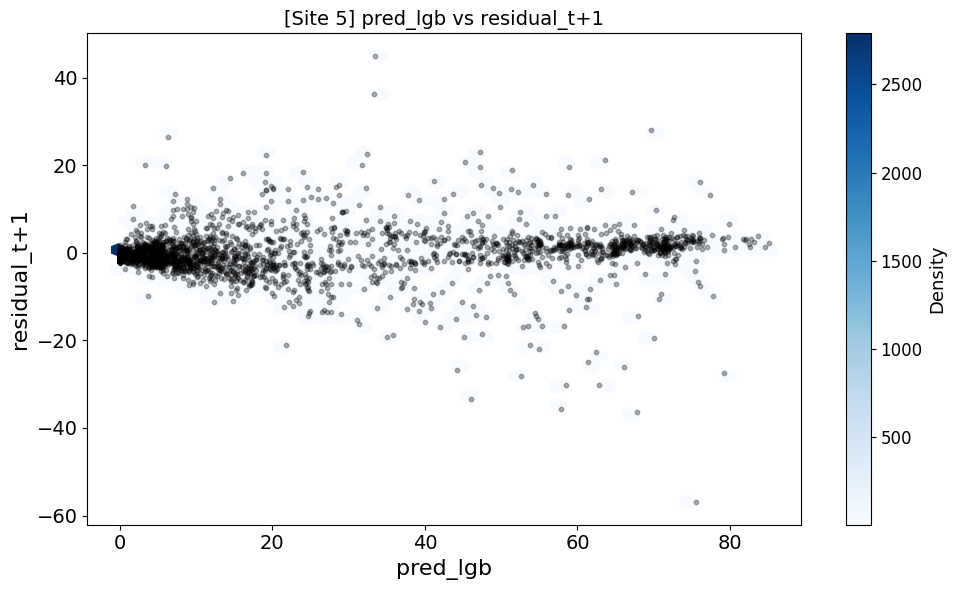

  [Site 6]


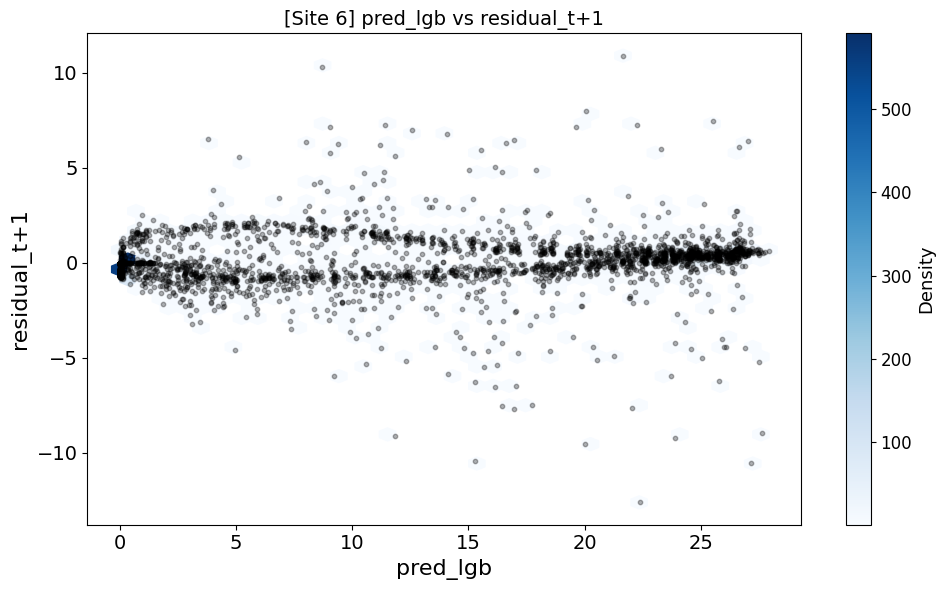

  [Site 7]


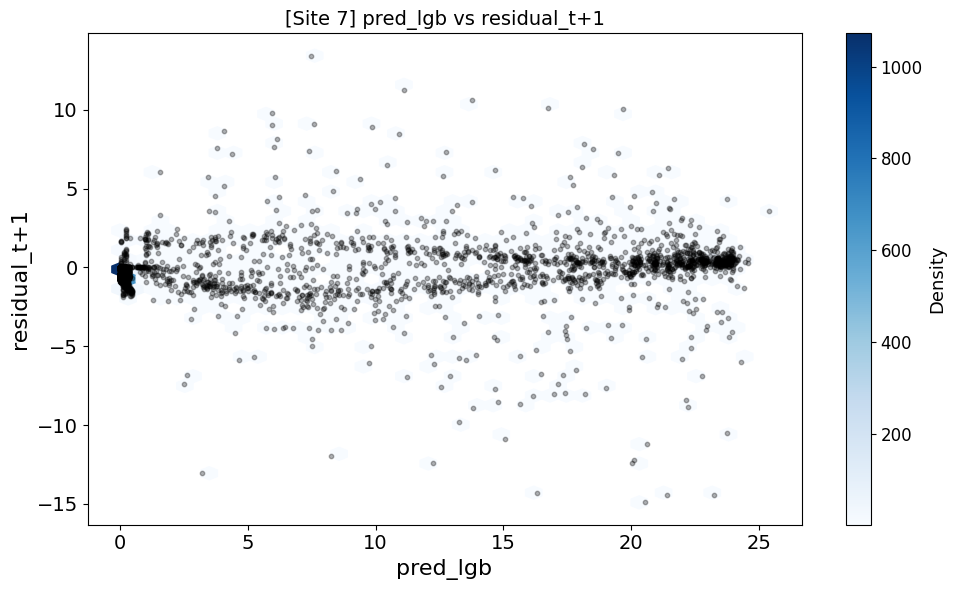

  [Site 8]


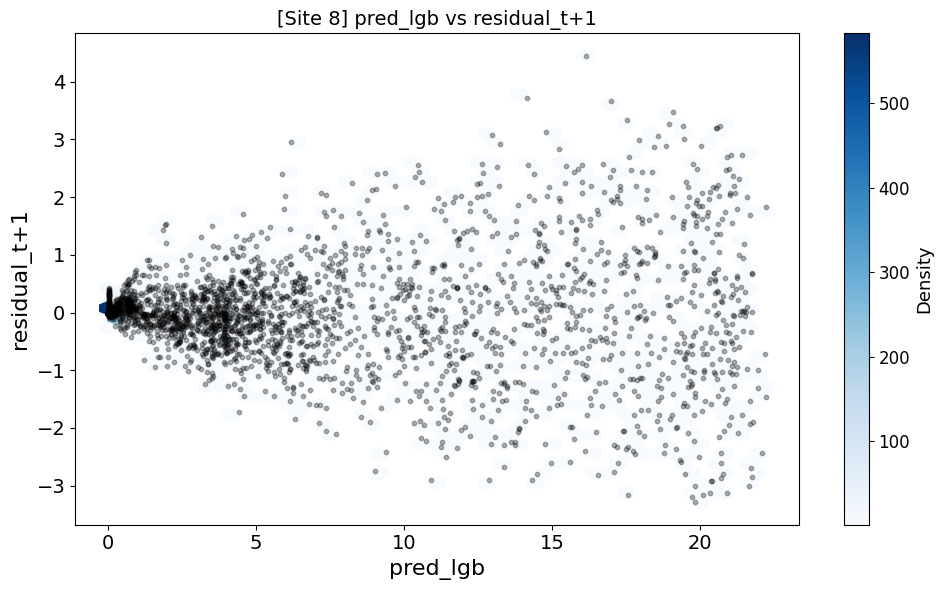

--------------------------------------------------
Feature: error_lgb
  [Site 1]


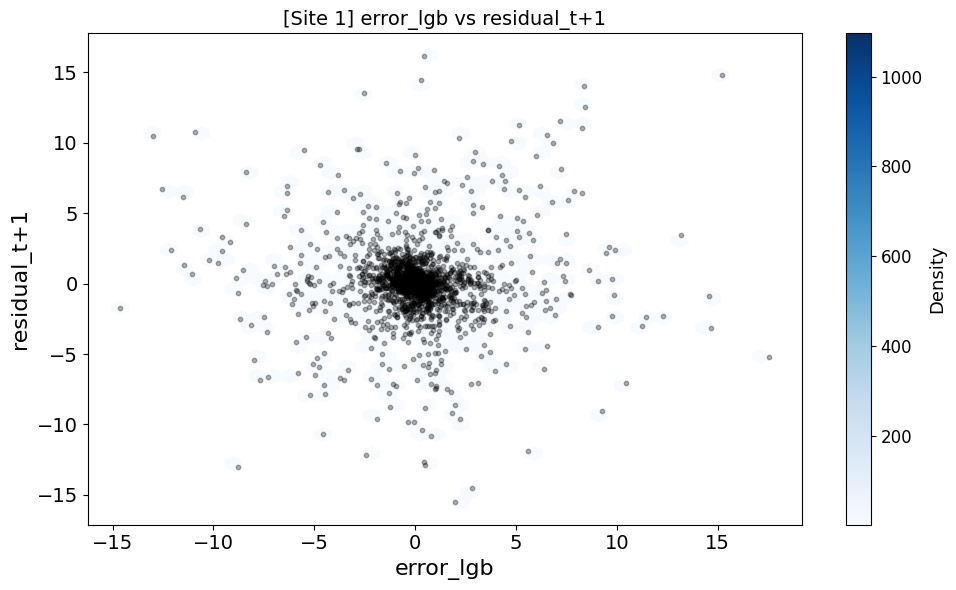

  [Site 2]


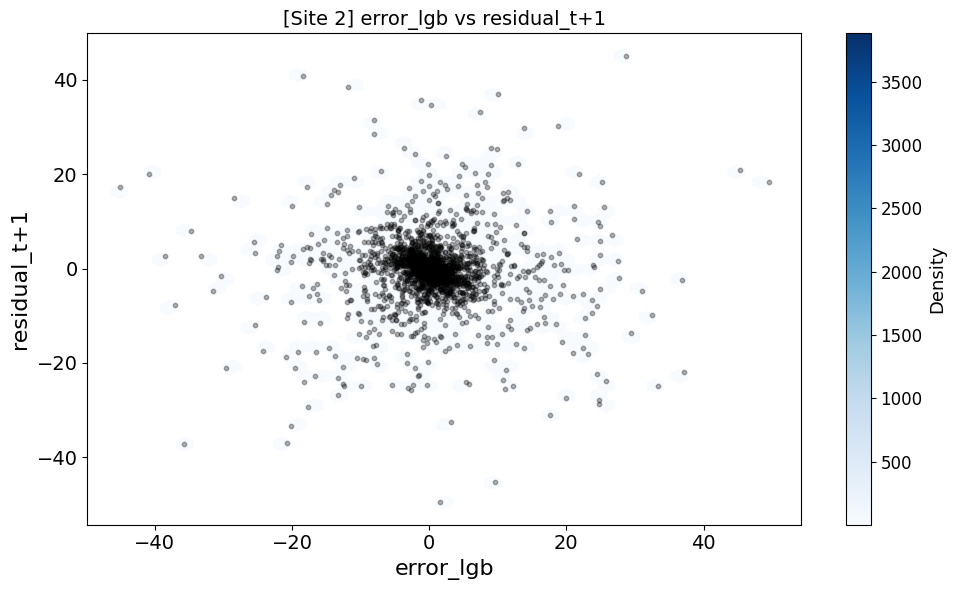

  [Site 4]


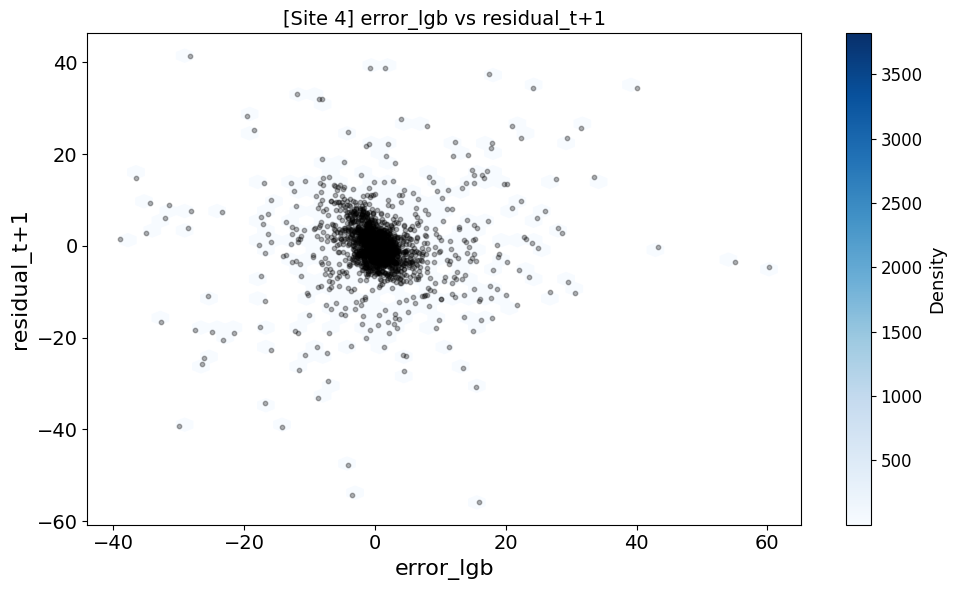

  [Site 5]


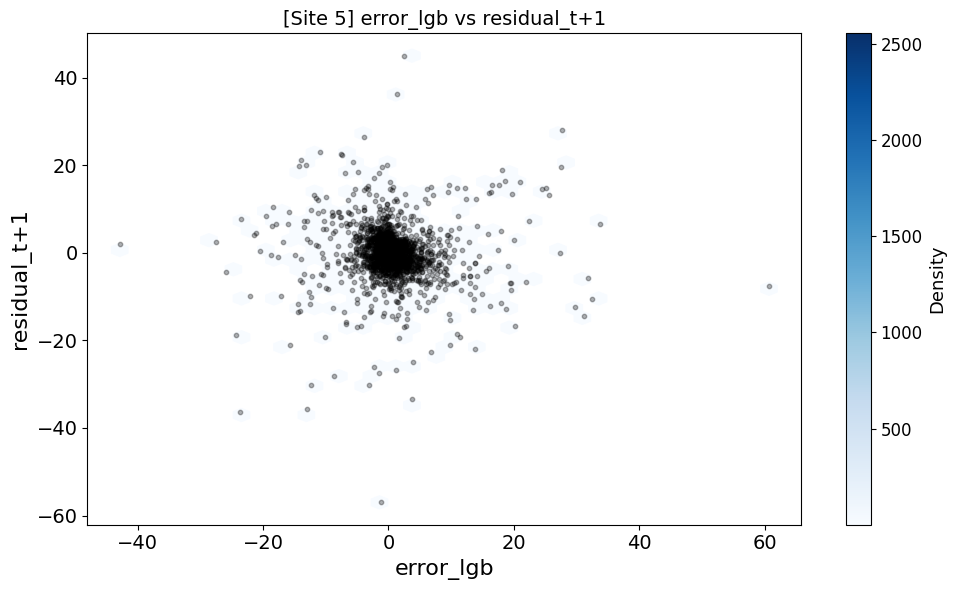

  [Site 6]


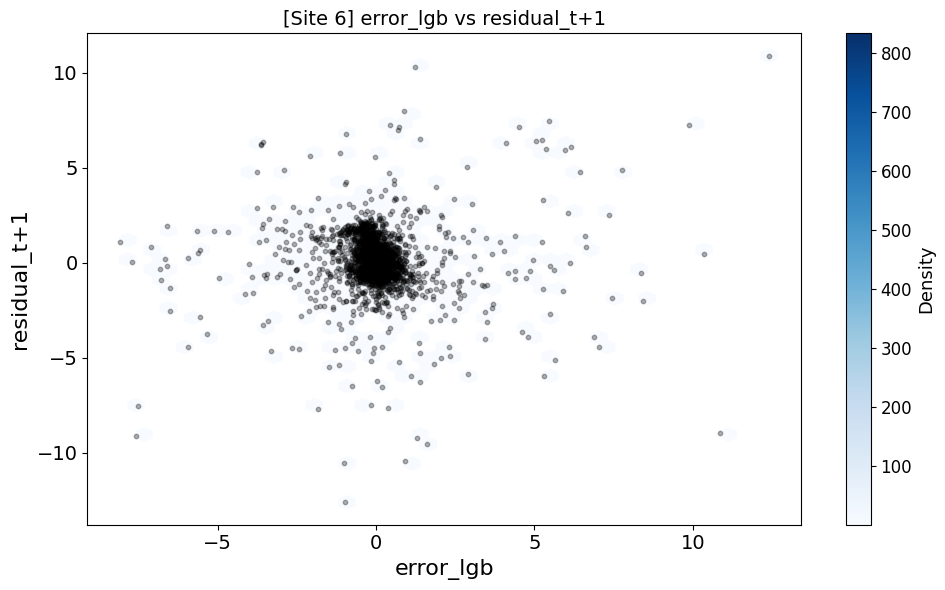

  [Site 7]


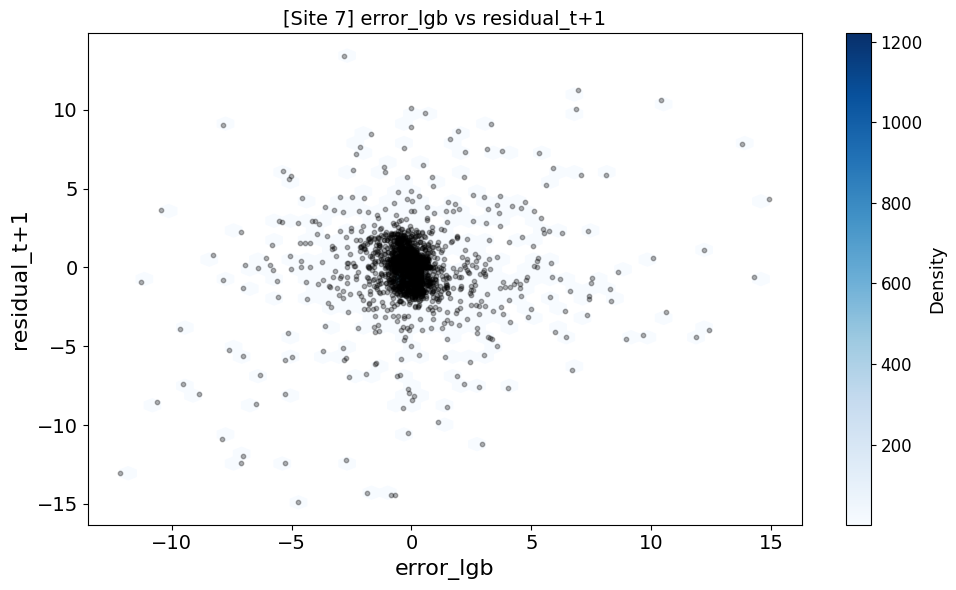

  [Site 8]


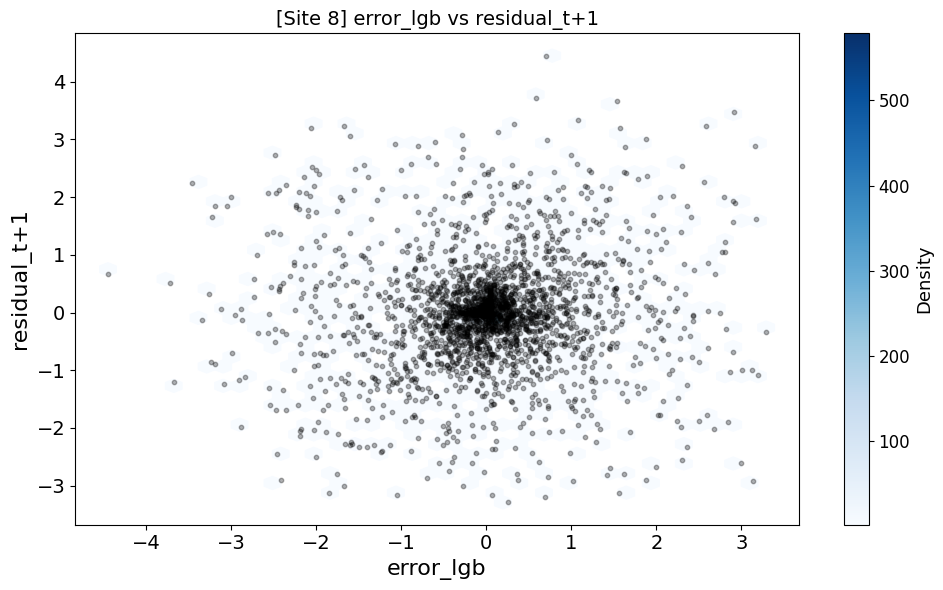

In [ ]:
from itertools import combinations
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from datetime import time

train_size = 22 / 24

operation_hours_array = [
    ('06:00', '21:30'),
    ('00:00', '23:59'),
    ('00:00', '23:59'),
    ('00:00', '23:59'),
    ('06:00', '21:00'),
    ('06:00', '21:00'),
    ('06:00', '19:00')
]

best_model_combos = [
    ('svr', 'svr'),
    ('lgb', 'svr'),
    ('mlr', 'svr'),
    ('mlr', 'svr'),
    ('mlr', 'svr'),
    ('mlr', 'svr'),
    ('lgb', 'svr')
]

target_features = [
    'Total solar irradiance (W/m2)',
    'same_time_mean', 'same_time_max',
    'lag_1', 'lag_8',
    'diff_15min', 'diff_105min',
    f'pred_{best_forecast_model}',
    f'error_{best_forecast_model}'
]

site_ids = [1, 2, 4, 5, 6, 7, 8]

# ▶ 미리 데이터 로드
reforecast_dfs = []
for (best_forecast_model, best_reforecast_model), site_num, (start_str, end_str) in zip(best_model_combos, site_ids, operation_hours_array):
    reforecast_file = f"gdrive/MyDrive/reforecast/result_of_paper/after_feature_selection_for_all_models_reforecast_with_pred_data/final_result_{best_forecast_model}_{site_num}_.csv"
    reforecast_df = pd.read_csv(reforecast_file)

    split_index = int(len(reforecast_df) * train_size)
    splited_df = reforecast_df.iloc[split_index:]
    splited_df['Time'] = pd.to_datetime(splited_df['Time'])

    start_time = time.fromisoformat(start_str)
    end_time = time.fromisoformat(end_str)

    filtered_df = splited_df[splited_df['Time'].dt.time.between(start_time, end_time)]
    reforecast_dfs.append(filtered_df)

# ▶ 피처 하나에 대해 residual shift와 2D 시각화
for feature in target_features:
    print('--------------------------------------------------')
    print(f"Feature: {feature}")

    for site_idx, site_num in enumerate(site_ids):
        df = reforecast_dfs[site_idx]
        forecast_model = best_model_combos[site_idx][0]

        if feature not in df.columns:
            continue

        print(f"  [Site {site_num}]")

        x = df[feature]
        y = -df[f'error_{forecast_model}'].shift(-1)  # residual_t+1

        valid = x.notna() & y.notna()
        x = x[valid]
        y = y[valid]

        fig, ax = plt.subplots(figsize=(10, 6))

        # 배경 밀도 표현 (hexbin)
        hb = ax.hexbin(x, y, gridsize=40, cmap='Blues', mincnt=1)

        # 도트 표시
        ax.scatter(x, y, s=10, color='black', alpha=0.3, label='Samples')

        ax.set_xlabel(feature, fontsize=16)
        ax.set_ylabel("residual_t+1", fontsize=16)
        ax.tick_params(axis='both', labelsize=14)
        ax.set_title(f"[Site {site_num}] {feature} vs residual_t+1", fontsize=14)

        cbar = fig.colorbar(hb, ax=ax)
        cbar.set_label('Density', fontsize=13)
        cbar.ax.tick_params(labelsize=12)

        plt.tight_layout()
        plt.show()


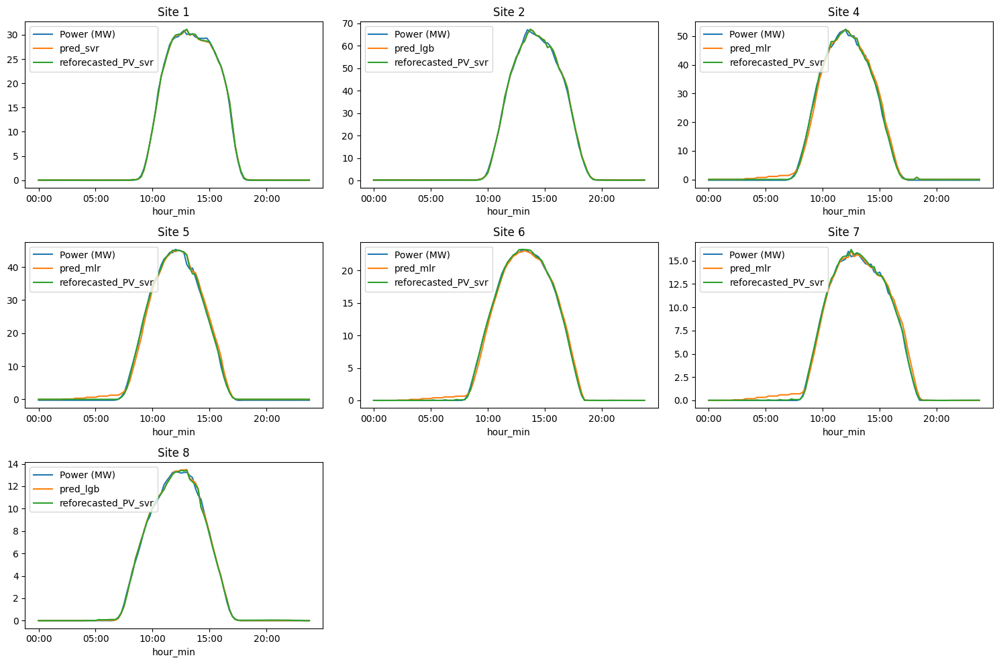

In [ ]:
import matplotlib.pyplot as plt

best_model_combos = [
    ('svr', 'svr'),
    ('lgb', 'svr'),
    ('mlr', 'svr'),
    ('mlr', 'svr'),
    ('mlr', 'svr'),
    ('mlr', 'svr'),
    ('lgb', 'svr')
]

origin_result_dfs=[]
train_size = 22/24

for (best_forecast_model, best_reforecast_model), site_num in zip(best_model_combos, [1,2,4,5,6,7,8]):
    reforecast_file = f'{datasets_path}/best/final_result_{best_forecast_model}_{site_num}_.csv'
    df = pd.read_csv(reforecast_file)
    split_index = int(len(df) * train_size)
    df = df.iloc[split_index:]
    origin_result_dfs.append(df)

fig, axes = plt.subplots(3, 3, figsize=(15, 10))
idx=0
for site_num, df, (best_forecast_model, best_reforecast_model) in zip([1,2,4,5,6,7,8], origin_result_dfs, best_model_combos):
  df['Time'] = pd.to_datetime(df['Time'])
  df['hour_min'] = df['Time'].dt.strftime('%H:%M')
  hourly_avg = df[['hour_min','Power (MW)', f'pred_{best_forecast_model}',f'reforecasted_PV_{best_reforecast_model}']].groupby('hour_min').mean()

  row, col = divmod(idx, 3)
  hourly_avg.plot(ax=axes[row, col], title=f'Site {site_num}')
  idx += 1

axes[2, 1].axis('off')
axes[2, 2].axis('off')

plt.tight_layout()
plt.show()


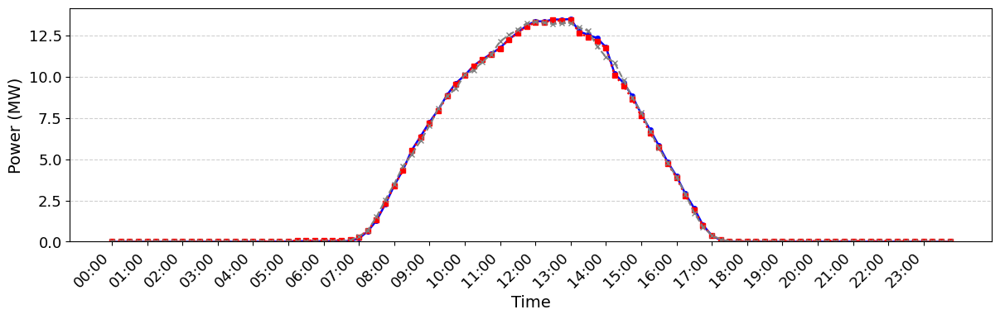

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# 사이트 하나 선택
site_index = 6
site_num = [1, 2, 4, 5, 6, 7, 8][site_index]
df = origin_result_dfs[site_index].copy()
best_forecast_model, best_reforecast_model = best_model_combos[site_index]

df['Time'] = pd.to_datetime(df['Time'])
df['hour_min'] = df['Time'].dt.strftime('%H:%M')

hourly_avg = df.groupby('hour_min')[
    ['Power (MW)', f'pred_{best_forecast_model}', f'reforecasted_PV_{best_reforecast_model}']
].mean()

fig, ax = plt.subplots(figsize=(12, 4))

# forecast
ax.plot(hourly_avg.index,
        hourly_avg[f'pred_{best_forecast_model}'],
        label='Base model',
        color='blue',
        linestyle='-',
        linewidth=1.8,
        marker='o',
        markersize=4)

# reforecast
ax.plot(hourly_avg.index,
        hourly_avg[f'reforecasted_PV_{best_reforecast_model}'],
        label='Residual model',
        color='red',
        linestyle=':',
        linewidth=1.8,
        marker='s',
        markersize=4)

# measurement
ax.plot(hourly_avg.index,
        hourly_avg['Power (MW)'],
        label='Actual',
        color='#7f7f7f',
        linestyle='--',
        linewidth=1.5,
        marker='x',
        markersize=4)

# ax.set_title(f'Site {site_num}')
ax.set_xlabel('Time', fontsize = 14)
ax.set_ylabel('Power (MW)', fontsize = 14)
ax.set_ylim(bottom=0)
ax.grid(axis='y', linestyle='--', alpha=0.6)

# 24시간 기준 x축 설정
hour_ticks = ['{:02d}:00'.format(h) for h in range(24)]
xtick_positions = [i for i, label in enumerate(hourly_avg.index) if label in hour_ticks]
xtick_labels = [label for label in hourly_avg.index if label in hour_ticks]
ax.set_xticks(xtick_positions)
ax.set_xticklabels(xtick_labels, rotation=45, ha='right')
ax.tick_params(axis='both', labelsize=13)

# 범례 아래 배치
# ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.7), ncol=3, fontsize=8, frameon=False)

plt.tight_layout()
plt.show()


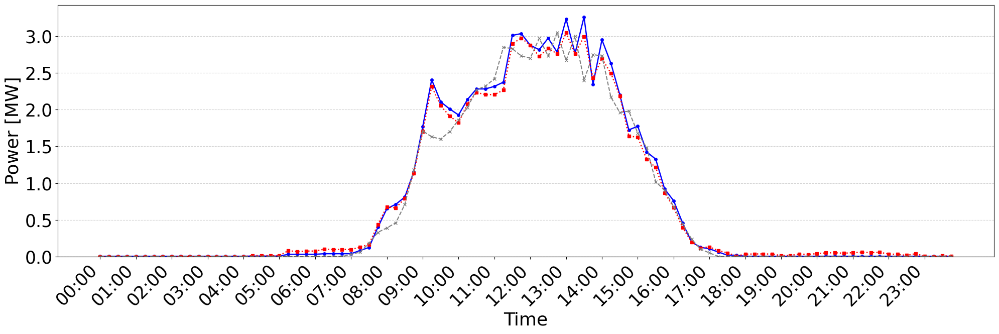

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# 사이트 하나 선택
site_index = 6
site_num = [1, 2, 4, 5, 6, 7, 8][site_index]
df = origin_result_dfs[site_index].copy()
best_forecast_model, best_reforecast_model = best_model_combos[site_index]

# ▶ 선택 날짜만 필터링
selected_date = '2020-12-24'
df['Time'] = pd.to_datetime(df['Time'])
df = df[df['Time'].dt.date == pd.to_datetime(selected_date).date()]  # ✅ 날짜 필터 추가
df['hour_min'] = df['Time'].dt.strftime('%H:%M')

# ▶ 시간(HH:MM)별 평균
hourly_avg = df.groupby('hour_min')[
    ['Power (MW)', f'pred_{best_forecast_model}', f'reforecasted_PV_{best_reforecast_model}']
].mean()

fig, ax = plt.subplots(figsize=(20, 6.75))

# forecast
ax.plot(hourly_avg.index,
        hourly_avg[f'pred_{best_forecast_model}'],
        label='Base model',
        color='blue',
        linestyle='-',
        linewidth=1.8,
        marker='o',
        markersize=4)

# reforecast
ax.plot(hourly_avg.index,
        hourly_avg[f'reforecasted_PV_{best_reforecast_model}'],
        label='Residual model',
        color='red',
        linestyle=':',
        linewidth=1.8,
        marker='s',
        markersize=4)

# measurement
ax.plot(hourly_avg.index,
        hourly_avg['Power (MW)'],
        label='Actual',
        color='#7f7f7f',
        linestyle='--',
        linewidth=1.5,
        marker='x',
        markersize=4)

# ax.set_title(f'Site {site_num}')
ax.set_xlabel('Time', fontsize=26)
ax.set_ylabel('Power [MW]', fontsize=26)
ax.tick_params(axis='both', labelsize=25)
ax.set_ylim(bottom=0)
ax.grid(axis='y', linestyle='--', alpha=0.6)

# 24시간 기준 x축 설정
hour_ticks = ['{:02d}:00'.format(h) for h in range(24)]
xtick_positions = [i for i, label in enumerate(hourly_avg.index) if label in hour_ticks]
xtick_labels = [label for label in hourly_avg.index if label in hour_ticks]
ax.set_xticks(xtick_positions)
ax.set_xticklabels(xtick_labels, rotation=45, ha='right')


# 범례 아래 배치
# ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.7), ncol=3, fontsize=25, frameon=False)

plt.tight_layout()
plt.show()


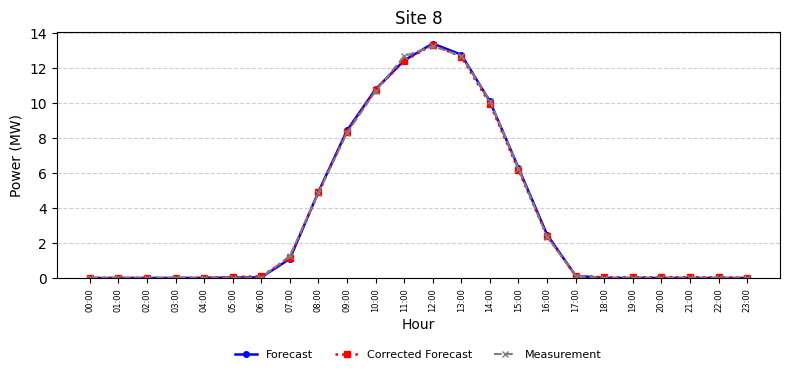

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# 사이트 하나 선택
site_index = 6
site_num = [1,2,4,5,6,7,8][site_index]
df = origin_result_dfs[site_index].copy()
best_forecast_model, best_reforecast_model = best_model_combos[site_index]

df['Time'] = pd.to_datetime(df['Time'])
df['hour'] = df['Time'].dt.hour

hourly_avg = df.groupby('hour')[
    ['Power (MW)', f'pred_{best_forecast_model}', f'reforecasted_PV_{best_reforecast_model}']
].mean()

fig, ax = plt.subplots(figsize=(8, 4))

# forecast
ax.plot(hourly_avg.index,
        hourly_avg[f'pred_{best_forecast_model}'],
        label='Forecast',
        color='blue',
        linestyle='-',
        linewidth=1.8,
        marker='o',
        markersize=4)

# reforecast
ax.plot(hourly_avg.index,
        hourly_avg[f'reforecasted_PV_{best_reforecast_model}'],
        label='Corrected Forecast',
        color='red',
        linestyle=':',
        linewidth=1.8,
        marker='s',
        markersize=4)

# measurement
ax.plot(hourly_avg.index,
        hourly_avg['Power (MW)'],
        label='Measurement',
        color='#7f7f7f',
        linestyle='--',
        linewidth=1.5,
        marker='x',
        markersize=4)

ax.set_title(f'Site {site_num}')
ax.set_xlabel('Hour')
ax.set_ylabel('Power (MW)')
ax.set_ylim(bottom=0)
ax.grid(axis='y', linestyle='--', alpha=0.6)

# x축: 0~23시
ax.set_xticks(range(24))
ax.set_xticklabels([f'{h:02d}:00' for h in range(24)], rotation=90, fontsize=6)

# 범례 아래 배치
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.25), ncol=3, fontsize=8, frameon=False)

plt.tight_layout()
plt.show()


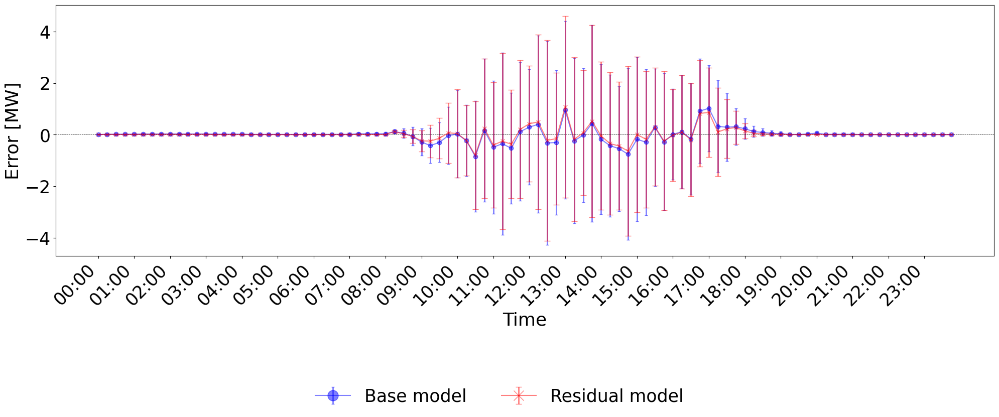

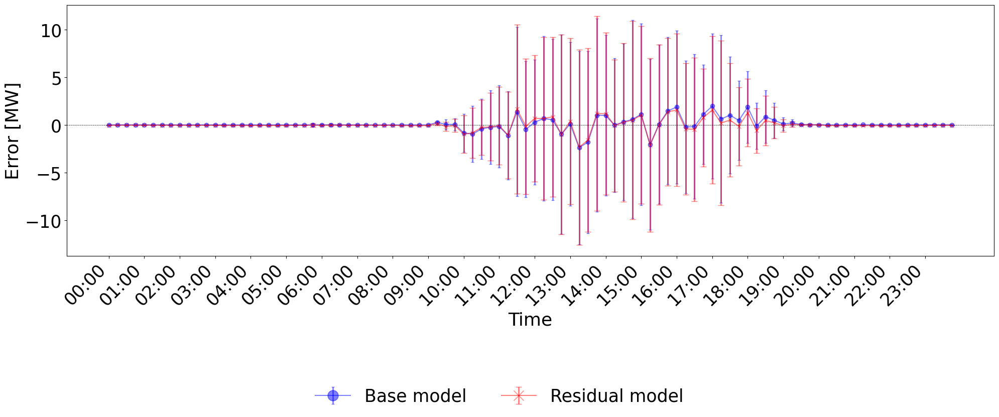

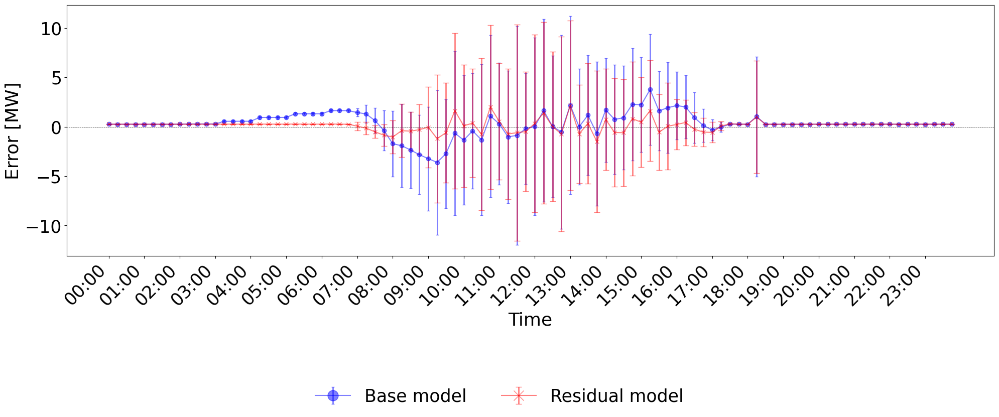

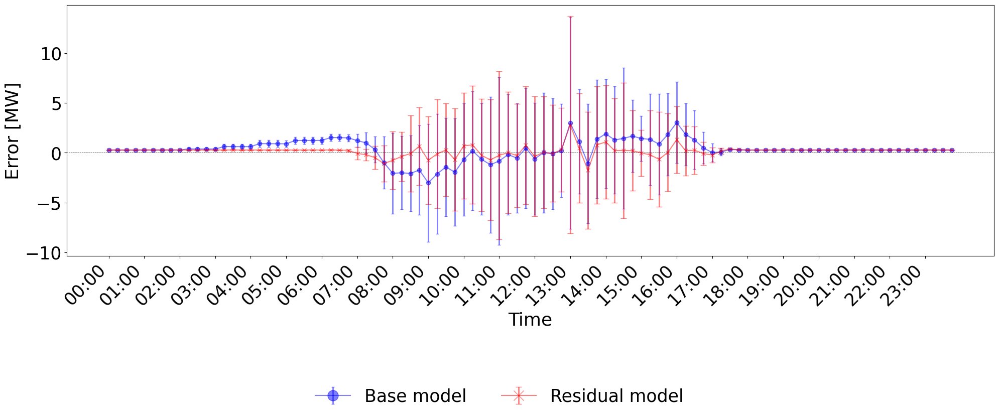

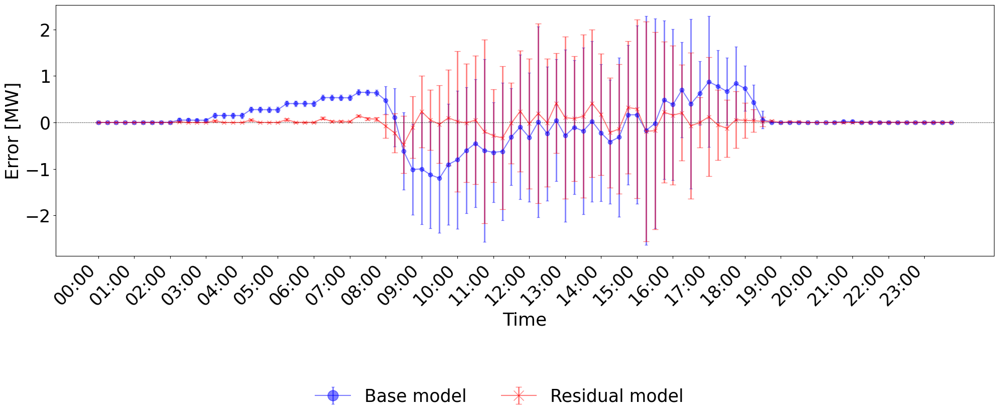

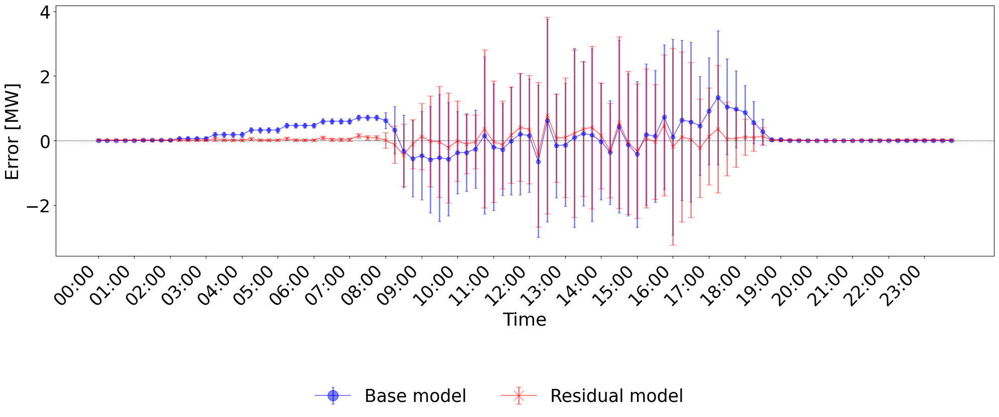

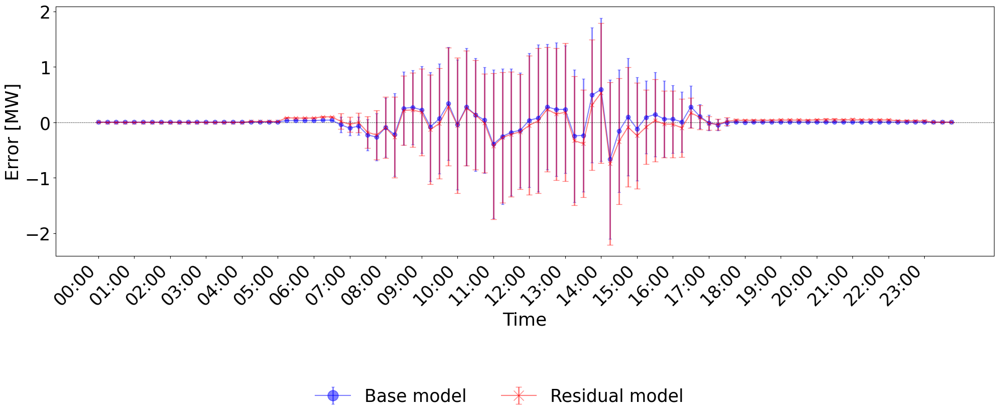

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import colors as mcolors

for site_index, _ in enumerate([1,2,4,5,6,7,8]):
  df = origin_result_dfs[site_index].copy()
  best_forecast_model, best_reforecast_model = best_model_combos[site_index]

  df['Time'] = pd.to_datetime(df['Time'])
  df['hour_min'] = df['Time'].dt.strftime('%H:%M')

  df['residual_forecast'] = df[f'pred_{best_forecast_model}'] - df['Power (MW)']
  df['residual_reforecast'] = df[f'reforecasted_PV_{best_reforecast_model}'] - df['Power (MW)']

  agg = df.groupby('hour_min')[['residual_forecast', 'residual_reforecast']].agg(['mean', 'std'])
  agg = agg.sort_index()

  mean_forecast = agg['residual_forecast']['mean']
  std_forecast = agg['residual_forecast']['std']
  mean_reforecast = agg['residual_reforecast']['mean']
  std_reforecast = agg['residual_reforecast']['std']
  x = list(range(len(mean_forecast)))

  xtick_positions = list(range(0, 96, 4))
  xtick_labels = ['{:02d}:00'.format(i) for i in range(24)]

  # 플롯 및 축 객체 생성
  fig, ax = plt.subplots(figsize=(20, 6.75))

  # Error bar 색상 + alpha 조절
  forecast_ecolor = mcolors.to_rgba('blue', alpha=0.9)
  reforecast_ecolor = mcolors.to_rgba('red', alpha=0.9)

  # Forecast (파랑)
  ax.errorbar(x, mean_forecast, yerr=std_forecast,
              fmt='o-', color='blue', ecolor=forecast_ecolor, alpha=0.5,
              elinewidth=2, capsize=2, label='Base model')

  # Reforecast (빨강)
  ax.errorbar(x, mean_reforecast, yerr=std_reforecast,
              fmt='x-', color='red', ecolor=reforecast_ecolor, alpha=0.5,
              elinewidth=2, capsize=4, label='Residual model')

  # 기준선
  ax.axhline(0, color='black', linestyle='dashed', linewidth=0.5)

  # x축 설정
  ax.set_xticks(ticks=xtick_positions)
  ax.set_xticklabels(labels=xtick_labels, rotation=45, ha='right')

  # 축 라벨
  ax.set_xlabel('Time', fontsize = 26)
  ax.set_ylabel('Error [MW]', fontsize = 26)
  ax.tick_params(axis='both', labelsize=25)


  # 범례 아래 배치
  fig.legend(markerscale=2.5, loc='lower center', bbox_to_anchor=(0.5, -0.25), ncol=2, fontsize=25, frameon=False)

  # 레이아웃 조정 (범례 공간 포함)
  fig.tight_layout()

  plt.show()


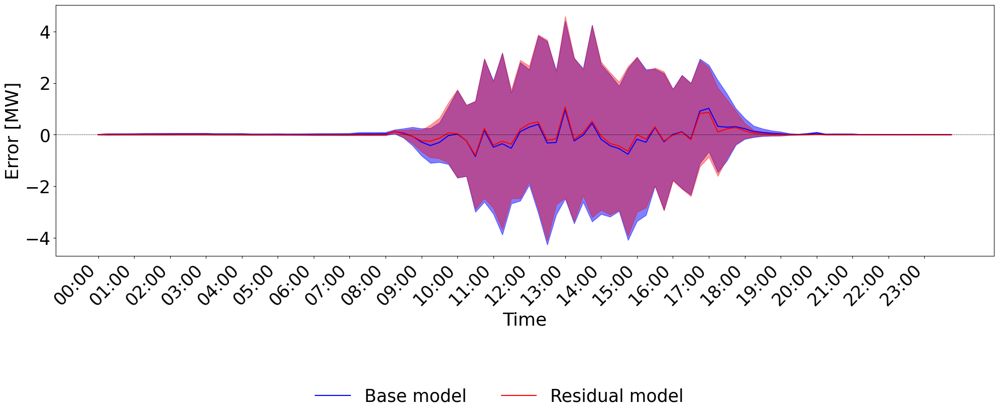

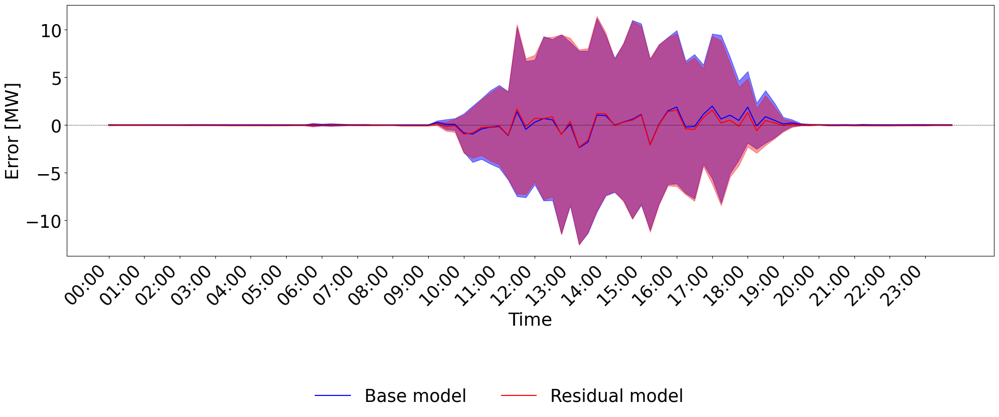

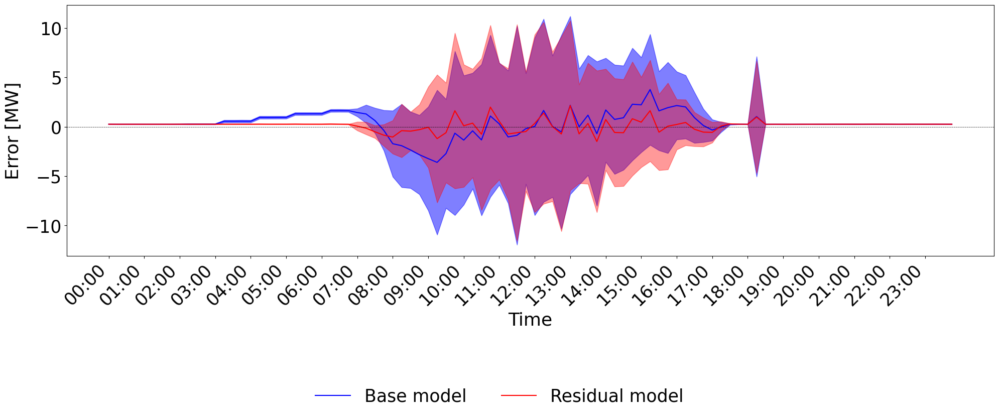

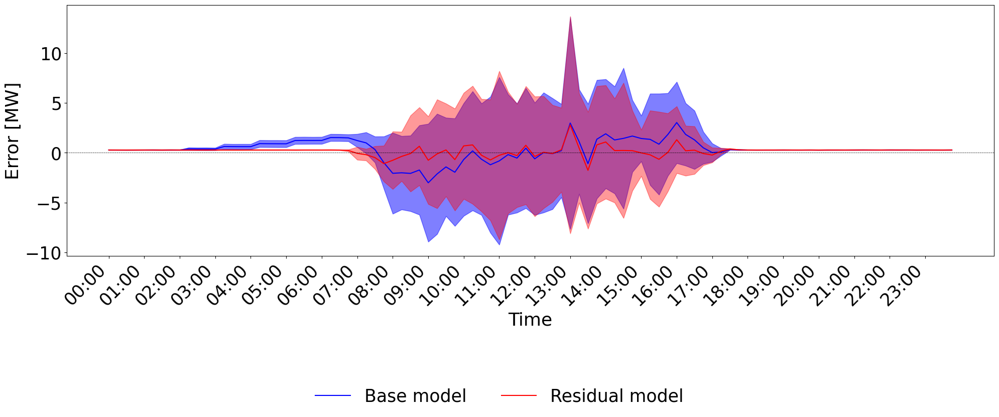

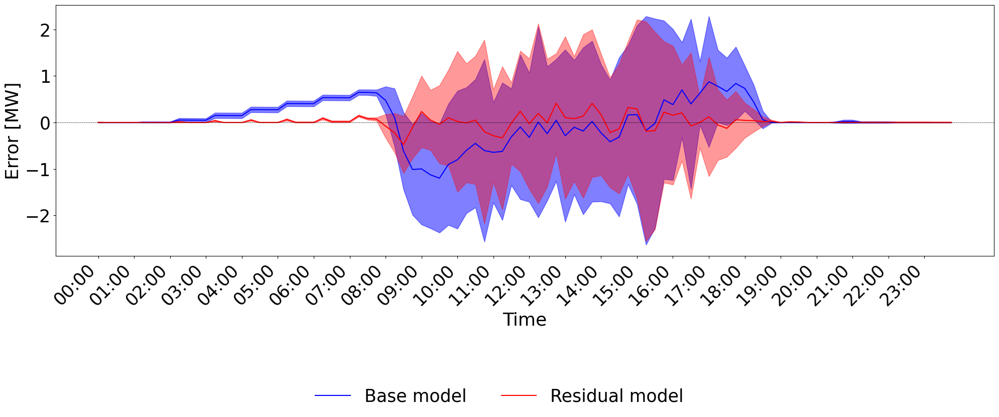

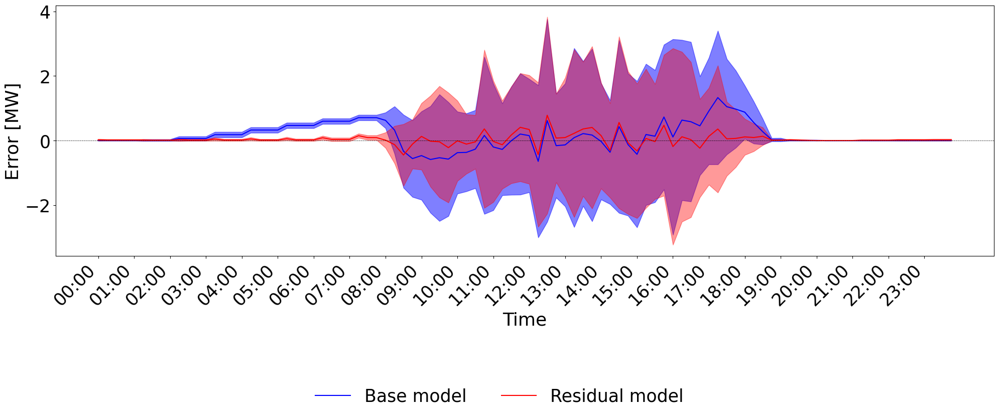

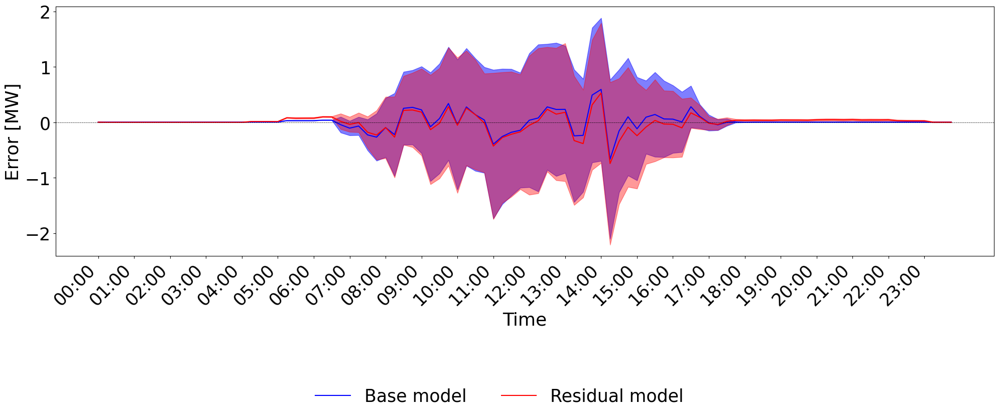

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import colors as mcolors

for site_index, _ in enumerate([1,2,4,5,6,7,8]):
  df = origin_result_dfs[site_index].copy()
  best_forecast_model, best_reforecast_model = best_model_combos[site_index]

  df['Time'] = pd.to_datetime(df['Time'])
  df['hour_min'] = df['Time'].dt.strftime('%H:%M')

  df['residual_forecast'] = df[f'pred_{best_forecast_model}'] - df['Power (MW)']
  df['residual_reforecast'] = df[f'reforecasted_PV_{best_reforecast_model}'] - df['Power (MW)']

  agg = df.groupby('hour_min')[['residual_forecast', 'residual_reforecast']].agg(['mean', 'std'])
  agg = agg.sort_index()

  mean_forecast = agg['residual_forecast']['mean']
  std_forecast = agg['residual_forecast']['std']
  mean_reforecast = agg['residual_reforecast']['mean']
  std_reforecast = agg['residual_reforecast']['std']
  x = list(range(len(mean_forecast)))

  xtick_positions = list(range(0, 96, 4))
  xtick_labels = ['{:02d}:00'.format(i) for i in range(24)]

  # ▶ 윗 코드와 동일한 전체 그림 크기
  fig, ax = plt.subplots(figsize=(20, 6.75))

  # Forecast (파랑) 음영 면
  ax.plot(x, mean_forecast, color='blue', label='Base model')
  ax.fill_between(x,
                  mean_forecast - std_forecast,
                  mean_forecast + std_forecast,
                  color='blue', alpha=0.5)

  # Reforecast (빨강) 음영 면
  ax.plot(x, mean_reforecast, color='red', label='Residual model')
  ax.fill_between(x,
                  mean_reforecast - std_reforecast,
                  mean_reforecast + std_reforecast,
                  color='red', alpha=0.4)

  # 기준선
  ax.axhline(0, color='black', linestyle='dashed', linewidth=0.5)

  # x축 설정
  ax.set_xticks(ticks=xtick_positions)
  ax.set_xticklabels(labels=xtick_labels, rotation=45, ha='right')

  # 축 라벨(윗 코드와 동일한 폰트 크기)
  ax.set_xlabel('Time', fontsize=26)
  ax.set_ylabel('Error [MW]', fontsize=26)
  ax.tick_params(axis='both', labelsize=25)

  # 범례 (아래 배치 유지, 폰트 크기 동일)
  fig.legend(loc='lower center', bbox_to_anchor=(0.5, -0.25), ncol=2, fontsize=25, frameon=False)

  # 레이아웃 조정
  fig.tight_layout()

  plt.show()
